In [1]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout,Conv1D,Input,MaxPooling1D,Activation,Flatten
from tensorflow.keras.optimizers import Adam
from collections import deque
import numpy as np
import  random
from tqdm import tqdm
import os
import time
import dataframe_image as dfi
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.callbacks import TensorBoard
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
#define the default font sizes:
plt.rc('font', size=12)
plt.rc('axes', labelsize=14, titlesize=12)
plt.rc('legend', fontsize=12)
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)

In [3]:
from pathlib import Path

# save the figures
IMAGES_PATH = Path() / "images" / "final"
IMAGES_PATH.mkdir(parents=True, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=1200):
    path = IMAGES_PATH / f"{fig_id}.{fig_extension}"
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [4]:
weather=pd.read_csv("C:\\Users\\user\\Desktop\\iman\\Master\\RoboticsAndControlSystems\\Project\\Data\\Weather\\Weather.csv",parse_dates=["%time"],low_memory=False)

In [5]:
for weather_attribute in weather.columns:
    x=weather.iloc[(np.where(weather[weather_attribute].isnull()))][weather_attribute]
    for i in reversed(x.index):
        if i+(12*24)< int(weather.index[-1]):
            #print(i+(12*24))
            weather.loc[i,weather_attribute]= weather.iloc[i+12*24][weather_attribute]
            #print(i+(12*24),weather.loc[i,weather_attribute])
for weather_attribute in weather.columns:  
    x=weather.iloc[(np.where(weather[weather_attribute].isnull()))][weather_attribute]
    for i in x.index:
        if i-(12*24)>= 0:
            #print(i+(12*24))
            weather.loc[i,weather_attribute]= weather.iloc[i-12*24][weather_attribute]
            #print(i+(12*24),weather.loc[i,weather_attribute])

print(weather.isnull().sum())

%time        0
AbsHumOut    0
Iglob        0
PARout       0
Pyrgeo       0
RadSum       0
Rain         0
Rhout        0
Tout         0
Winddir      0
Windsp       0
dtype: int64


In [6]:
weather=weather.set_index('%time').astype(float)

In [7]:
weather.isnull().sum()

AbsHumOut    0
Iglob        0
PARout       0
Pyrgeo       0
RadSum       0
Rain         0
Rhout        0
Tout         0
Winddir      0
Windsp       0
dtype: int64

In [8]:
weather.head()

,AbsHumOut,Iglob,PARout,Pyrgeo,RadSum,Rain,Rhout,Tout,Winddir,Windsp
%time,,,,,,,,,,
2019-12-16 00:00:00,6.220954,0.0,0.0,-72.0,215.0,0.0,80.6,6.9,32.0,4.7
2019-12-16 00:05:00,6.220954,0.0,0.0,-73.0,0.0,0.0,80.6,6.9,32.0,4.7
2019-12-16 00:10:00,6.205565,0.0,0.0,-76.0,0.0,0.0,80.4,6.9,32.0,4.7
2019-12-16 00:15:00,6.190173,0.0,0.0,-77.0,0.0,0.0,80.2,6.9,32.0,4.7
2019-12-16 00:20:00,6.162624,0.0,0.0,-75.0,0.0,0.0,80.9,6.7,32.0,4.7


In [9]:
#def convert_to_preferred_format(sec):
#   sec = sec % (24 * 3600)
#   hour = sec // 3600
#   sec %= 3600
#   min = sec // 60
#   sec %= 60
#   print("seconds value in hours:",hour)
#   print("seconds value in minutes:",min)
#   return "%02d:%02d:%02d" % (hour, min, sec) 
#
#timestamp = weather['%time']
#print("Time in preferred format :-",convert_to_preferred_format(timestamp[0]))
#
#from datetime import datetime
# 
# 
#timestamp = weather['%time']
#dt_obj = datetime.fromtimestamp(timestamp[0])
# 
#print("date_time:",dt_obj)
#print("type of dt:",type(dt_obj))
#import time 
#time.strftime("%a, %d %b %Y %H:%M:%S +0000", time.gmtime(timestamp[0]))
#import datetime; 
#datetime.datetime.utcfromtimestamp(timestamp[0]).replace(tzinfo=datetime.timezone.utc)

In [10]:
#weather=weather.set_index('%time')

In [11]:
weather.index

DatetimeIndex(['2019-12-16 00:00:00', '2019-12-16 00:05:00',
               '2019-12-16 00:10:00', '2019-12-16 00:15:00',
               '2019-12-16 00:20:00', '2019-12-16 00:25:00',
               '2019-12-16 00:30:00', '2019-12-16 00:35:00',
               '2019-12-16 00:40:00', '2019-12-16 00:45:00',
               ...
               '2020-05-29 23:15:00', '2020-05-29 23:20:00',
               '2020-05-29 23:25:00', '2020-05-29 23:30:00',
               '2020-05-29 23:35:00', '2020-05-29 23:40:00',
               '2020-05-29 23:45:00', '2020-05-29 23:50:00',
               '2020-05-29 23:55:00', '2020-05-30 00:00:00'],
              dtype='datetime64[ns]', name='%time', length=47809, freq=None)

In [12]:
weather.corr()

,AbsHumOut,Iglob,PARout,Pyrgeo,RadSum,Rain,Rhout,Tout,Winddir,Windsp
AbsHumOut,1.000000,-0.177127,-0.164747,0.435554,-0.165255,0.131433,0.562093,0.387767,0.212394,0.104426
Iglob,-0.177127,1.000000,0.989751,-0.541313,0.379036,-0.108179,-0.623545,0.548088,-0.096959,0.051546
PARout,-0.164747,0.989751,1.000000,-0.537162,0.374900,-0.106760,-0.617479,0.553818,-0.089762,0.053750
Pyrgeo,0.435554,-0.541313,-0.537162,1.000000,-0.473318,0.304829,0.726087,-0.350901,0.177230,0.149783
RadSum,-0.165255,0.379036,0.374900,-0.473318,1.000000,-0.098007,-0.607807,0.532698,-0.107251,-0.049460
Rain,0.131433,-0.108179,-0.106760,0.304829,-0.098007,1.000000,0.210962,-0.080670,0.018133,0.119709
Rhout,0.562093,-0.623545,-0.617479,0.726087,-0.607807,0.210962,1.000000,-0.516311,0.217375,-0.004896
Tout,0.387767,0.548088,0.553818,-0.350901,0.532698,-0.080670,-0.516311,1.000000,-0.029486,0.084826
Winddir,0.212394,-0.096959,-0.089762,0.177230,-0.107251,0.018133,0.217375,-0.029486,1.000000,0.351328
Windsp,0.104426,0.051546,0.053750,0.149783,-0.049460,0.119709,-0.004896,0.084826,0.351328,1.000000


array([[<AxesSubplot:title={'center':'AbsHumOut'}>,
        <AxesSubplot:title={'center':'Iglob'}>,
        <AxesSubplot:title={'center':'PARout'}>],
       [<AxesSubplot:title={'center':'Pyrgeo'}>,
        <AxesSubplot:title={'center':'RadSum'}>,
        <AxesSubplot:title={'center':'Rain'}>],
       [<AxesSubplot:title={'center':'Rhout'}>,
        <AxesSubplot:title={'center':'Tout'}>,
        <AxesSubplot:title={'center':'Winddir'}>],
       [<AxesSubplot:title={'center':'Windsp'}>, <AxesSubplot:>,
        <AxesSubplot:>]], dtype=object)

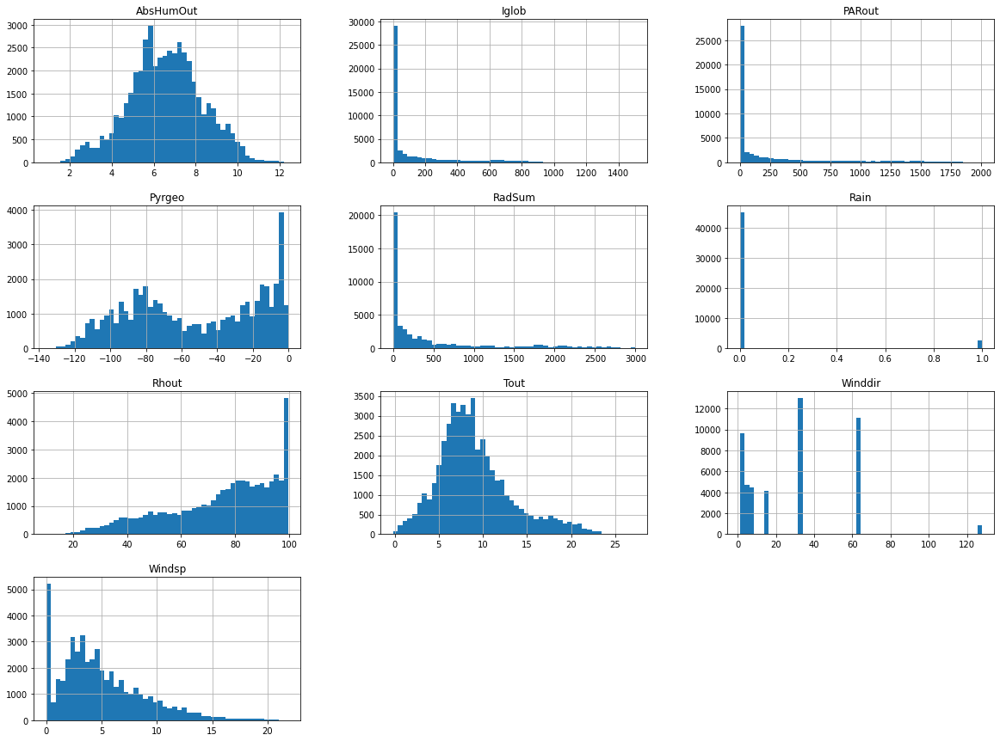

In [13]:
weather.hist(bins=50,figsize=(20,15),column=weather.columns)

In [14]:
weather.describe()

,AbsHumOut,Iglob,PARout,Pyrgeo,RadSum,Rain,Rhout,Tout,Winddir,Windsp
count,47809.000000,47809.000000,47809.000000,47809.000000,47809.000000,47809.000000,47809.000000,47809.000000,47809.000000,47809.000000
mean,6.567100,125.202200,250.084137,-52.860863,476.896306,0.052835,74.855593,9.016481,28.677613,4.982183
std,1.734011,221.870172,443.591849,36.335734,723.978786,0.223707,19.864428,4.233403,26.908109,3.849629
min,0.879099,0.000000,0.000000,-136.000000,0.000000,0.000000,10.100003,-0.200000,1.000000,0.000000
25%,5.444026,0.000000,0.000000,-84.000000,0.000000,0.000000,61.700000,6.200000,4.000000,2.200000
50%,6.563831,0.000000,1.000000,-54.000000,122.000000,0.000000,79.300000,8.400000,32.000000,4.200000
75%,7.697484,146.000000,286.999996,-17.000000,610.000000,0.000000,91.200000,11.000000,63.999994,7.100000
max,12.427134,1505.000000,2010.000000,0.000000,2999.000000,1.000000,99.700000,27.300000,128.000000,21.900000


<function matplotlib.pyplot.show(close=None, block=None)>

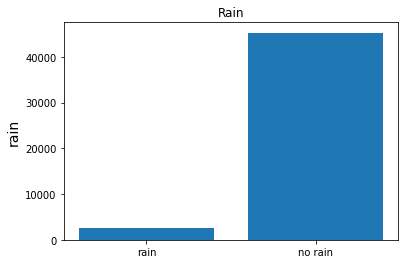

In [15]:
labels = ['rain', 'no rain']
values=[(weather['Rain']==1).sum(),(weather['Rain']==0).sum()]
weather['Rain'][weather['Rain']<0.2]=0
weather['Rain'][weather['Rain']>0.2]=1

values=[(weather['Rain']==1).sum(),(weather['Rain']==0).sum()]

fig,ax=plt.subplots()
ax.bar(labels,values)
ax.set_ylabel('rain')
ax.set_title('Rain')
plt.show


In [16]:
corr_matrix = weather.corr()['Rain'].sort_values(ascending=False)
corr_matrix


Rain         1.000000
Pyrgeo       0.304829
Rhout        0.210962
AbsHumOut    0.131433
Windsp       0.119709
Winddir      0.018133
Tout        -0.080670
RadSum      -0.098007
PARout      -0.106760
Iglob       -0.108179
Name: Rain, dtype: float64

In [17]:
#from pandas.plotting import scatter_matrix
#attributes = weather.columns.drop('Rain')
#scatter_matrix(weather[attributes], figsize=(15, 10))
#plt.show()

In [18]:
#from matplotlib import pyplot as plt
#T=.1
##weather['Rain'].iloc[weather['Rain']<T]=0
##weather['Rain'].iloc[weather['Rain']>T]=1
#for col in attributes:
#    weather.boxplot(column=col, by='Rain', figsize=(6,6))
#    plt.title(col)
#plt.show()

In [19]:
green_house_climate=pd.read_csv("C:\\Users\\user\\Desktop\\iman\\Master\\RoboticsAndControlSystems\\Project\\Data\\Automatoes\\GreenhouseClimate.csv",parse_dates=["%time"],low_memory=False).set_index('%time').astype(float)

In [20]:
green_house_climate.head(5)
green_house_climate['Water_Quantity']=green_house_climate['Cum_irr']
green_house_climate['Duration_of_Irrigation']=green_house_climate['water_sup']
green_house_climate['Irrigation_Time_Intervals']=green_house_climate['water_sup_intervals_vip_min']

green_house_climate.drop(columns=['water_sup','Cum_irr','water_sup_intervals_vip_min'],inplace=True)

In [21]:
green_house_climate.columns

Index(['AssimLight', 'BlackScr', 'CO2air', 'EC_drain_PC', 'EnScr', 'HumDef',
       'PipeGrow', 'PipeLow', 'Rhair', 'Tair', 'Tot_PAR', 'Tot_PAR_Lamps',
       'VentLee', 'Ventwind', 'assim_sp', 'assim_vip', 'co2_dos', 'co2_sp',
       'co2_vip', 'dx_sp', 'dx_vip', 'int_blue_sp', 'int_blue_vip',
       'int_farred_sp', 'int_farred_vip', 'int_red_sp', 'int_red_vip',
       'int_white_sp', 'int_white_vip', 'pH_drain_PC', 'scr_blck_sp',
       'scr_blck_vip', 'scr_enrg_sp', 'scr_enrg_vip', 't_grow_min_sp',
       't_grow_min_vip', 't_heat_sp', 't_heat_vip', 't_rail_min_sp',
       't_rail_min_vip', 't_vent_sp', 't_ventlee_vip', 't_ventwind_vip',
       'water_sup_intervals_sp_min', 'window_pos_lee_sp', 'window_pos_lee_vip',
       'Water_Quantity', 'Duration_of_Irrigation',
       'Irrigation_Time_Intervals'],
      dtype='object')

In [22]:
#green_house_climate.drop(columns=[  'AssimLight', 'BlackScr', 
#       'EnScr',  'PipeGrow', 'PipeLow', 
#       'Tot_PAR_Lamps', 'VentLee', 'Ventwind', 'assim_sp', 'assim_vip',
#        'co2_sp', 'co2_vip', 'dx_sp', 'dx_vip', 'int_blue_sp',
#       'int_blue_vip', 'int_farred_sp', 'int_farred_vip', 'int_red_sp',
#       'int_red_vip', 'int_white_sp', 'int_white_vip', 
#       'scr_blck_sp', 'scr_blck_vip', 'scr_enrg_sp', 'scr_enrg_vip',
#       't_grow_min_sp', 't_grow_min_vip', 't_heat_sp', 't_heat_vip',
#       't_rail_min_sp', 't_rail_min_vip', 't_vent_sp', 't_ventlee_vip',
#       't_ventwind_vip',  'window_pos_lee_sp','water_sup_intervals_sp_min',
#       'window_pos_lee_vip'],inplace=True)

In [23]:
green_house_climate.info()
green_house_climate.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 47809 entries, 2019-12-16 00:00:00 to 2020-05-30 00:00:00
Data columns (total 49 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   AssimLight                  47738 non-null  float64
 1   BlackScr                    47738 non-null  float64
 2   CO2air                      47738 non-null  float64
 3   EC_drain_PC                 47738 non-null  float64
 4   EnScr                       47738 non-null  float64
 5   HumDef                      47738 non-null  float64
 6   PipeGrow                    47738 non-null  float64
 7   PipeLow                     47738 non-null  float64
 8   Rhair                       47738 non-null  float64
 9   Tair                        47738 non-null  float64
 10  Tot_PAR                     47738 non-null  float64
 11  Tot_PAR_Lamps               47809 non-null  float64
 12  VentLee                     47738 non-null  float64
 

,AssimLight,BlackScr,CO2air,EC_drain_PC,EnScr,HumDef,PipeGrow,PipeLow,Rhair,Tair,...,t_rail_min_vip,t_vent_sp,t_ventlee_vip,t_ventwind_vip,water_sup_intervals_sp_min,window_pos_lee_sp,window_pos_lee_vip,Water_Quantity,Duration_of_Irrigation,Irrigation_Time_Intervals
%time,,,,,,,,,,,,,,,,,,,,,
2019-12-16 00:00:00,0.0,35.0,468.0,1.8,96.0,7.3,34.5,50.4,60.7,21.3,...,0.0,NaN,25.0,26.0,NaN,NaN,1.2,0.3,2.0,1000.0
2019-12-16 00:05:00,0.0,85.0,509.0,1.8,96.0,7.1,33.2,48.7,62.4,21.5,...,0.0,NaN,25.0,26.0,NaN,NaN,1.2,0.5,4.0,1000.0
2019-12-16 00:10:00,0.0,96.0,498.0,1.8,96.0,7.5,32.4,47.1,61.4,22.0,...,0.0,NaN,25.0,26.0,NaN,NaN,1.2,0.5,4.0,1000.0
2019-12-16 00:15:00,0.0,96.0,491.0,1.8,96.0,6.6,31.7,45.4,64.8,21.3,...,0.0,NaN,25.0,26.0,NaN,NaN,1.2,0.5,4.0,1000.0
2019-12-16 00:20:00,0.0,95.0,515.0,1.8,95.0,6.7,30.9,44.2,64.6,21.6,...,0.0,NaN,25.0,26.0,NaN,NaN,1.2,0.5,4.0,1000.0


In [24]:
#green_house_climate[np.where(green_house_climate.isnull()==True)]
#print(green_house_climate['Water_Quantity'].value_counts())

#print(green_house_climate['Irrigation_Time_Intervals'].value_counts())


array([[<AxesSubplot:title={'center':'AssimLight'}>,
        <AxesSubplot:title={'center':'BlackScr'}>,
        <AxesSubplot:title={'center':'CO2air'}>,
        <AxesSubplot:title={'center':'EC_drain_PC'}>,
        <AxesSubplot:title={'center':'EnScr'}>,
        <AxesSubplot:title={'center':'HumDef'}>,
        <AxesSubplot:title={'center':'PipeGrow'}>],
       [<AxesSubplot:title={'center':'PipeLow'}>,
        <AxesSubplot:title={'center':'Rhair'}>,
        <AxesSubplot:title={'center':'Tair'}>,
        <AxesSubplot:title={'center':'Tot_PAR'}>,
        <AxesSubplot:title={'center':'Tot_PAR_Lamps'}>,
        <AxesSubplot:title={'center':'VentLee'}>,
        <AxesSubplot:title={'center':'Ventwind'}>],
       [<AxesSubplot:title={'center':'assim_sp'}>,
        <AxesSubplot:title={'center':'assim_vip'}>,
        <AxesSubplot:title={'center':'co2_dos'}>,
        <AxesSubplot:title={'center':'co2_sp'}>,
        <AxesSubplot:title={'center':'co2_vip'}>,
        <AxesSubplot:title={'center':'d

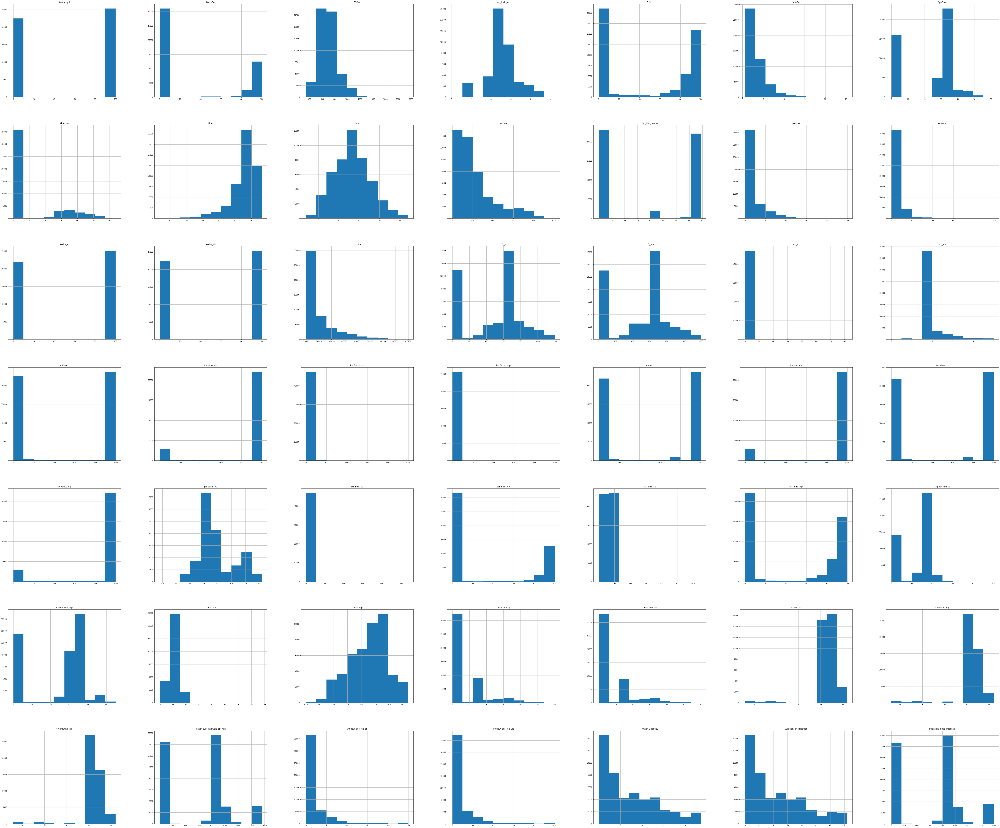

In [25]:
green_house_climate.hist(bins=10,figsize=(100,85),grid=[5,5],column=green_house_climate.columns)

C:\Users\user\AppData\Local\Temp\ipykernel_21152\949930551.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10, 7))


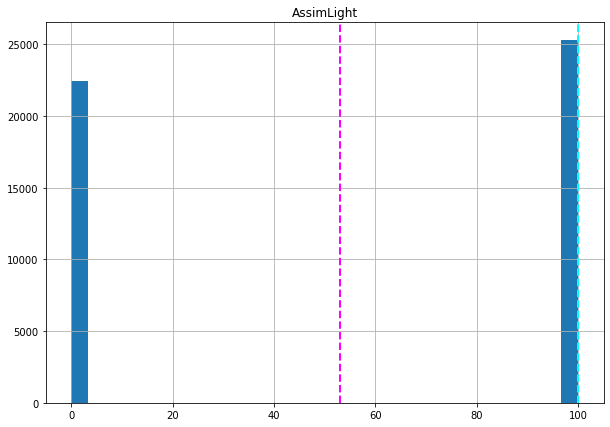

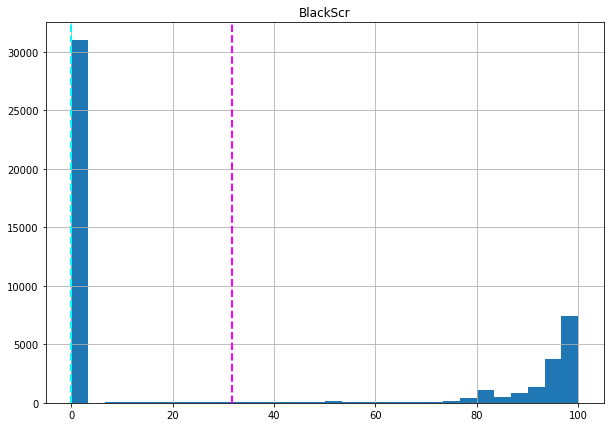

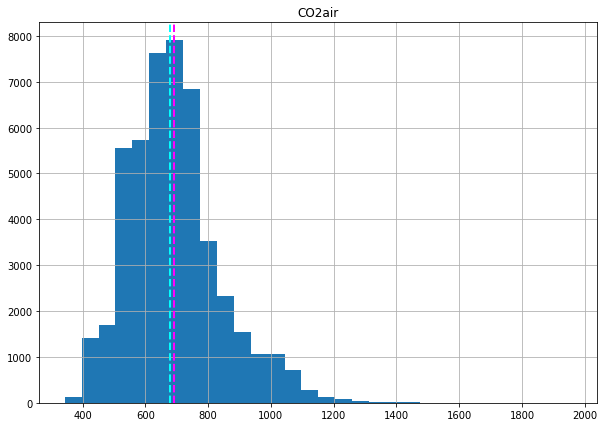

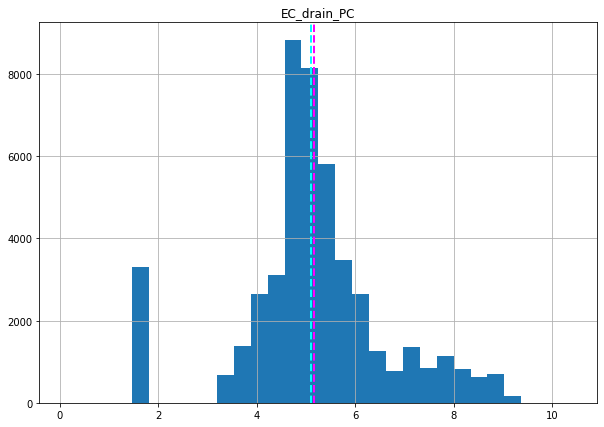

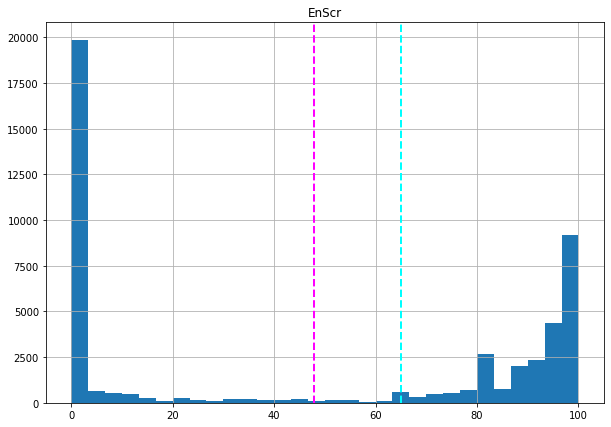

...

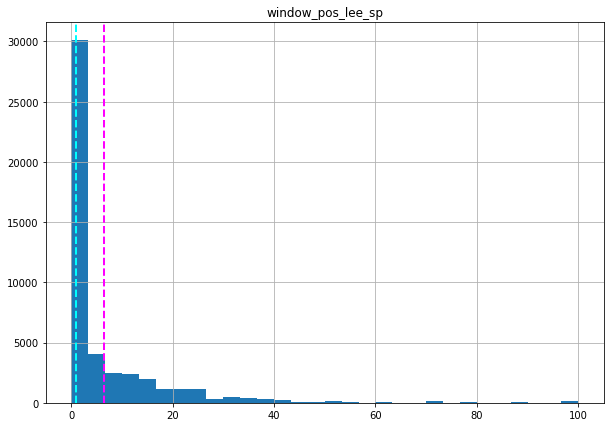

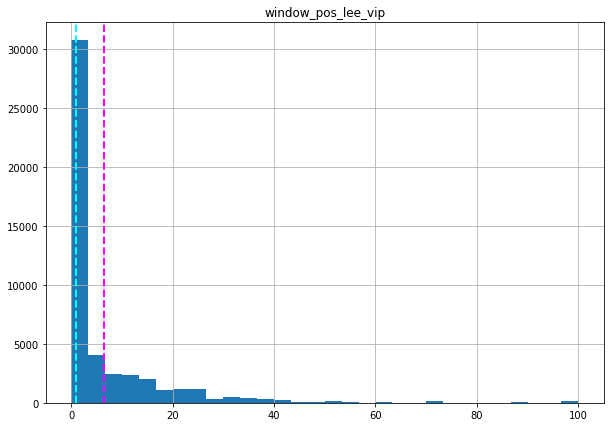

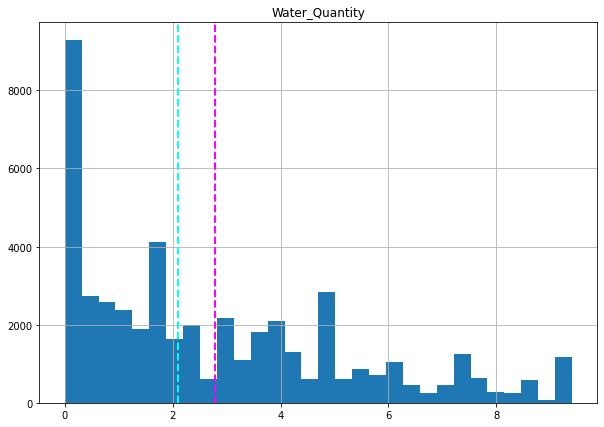

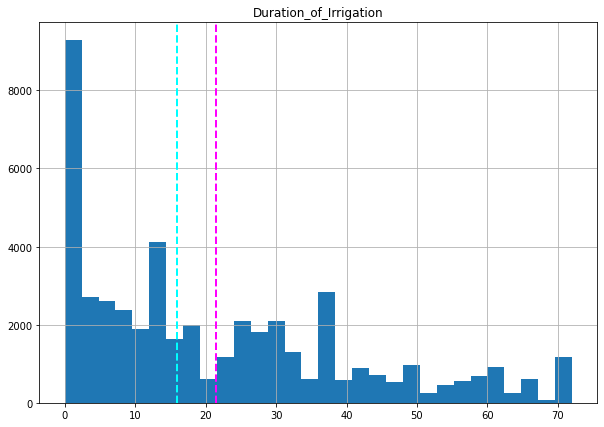

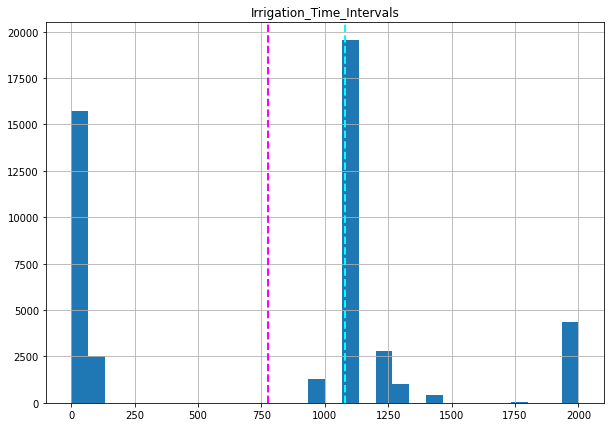

In [26]:
# Plot a histogram for each numeric feature
numeric_feature=green_house_climate.columns
for col in numeric_feature:
    fig = plt.figure(figsize=(10, 7))
    ax = fig.gca()
    feature = green_house_climate[col]
    feature.hist(bins=30, ax = ax)
    ax.axvline(feature.mean(), color='magenta', linestyle='dashed', linewidth=2)
    ax.axvline(feature.median(), color='cyan', linestyle='dashed', linewidth=2)
    ax.set_title(col)
plt.show()

In [27]:
#Check Outliers in numarical features by using boxplot :
#from matplotlib import pyplot as plt
#
#for col in green_house_climate.columns:
#    green_house_climate.boxplot(column=col, figsize=(3,3))
#    plt.title(col)
#    plt.show()

In [28]:
#weather.set_index('%time')
weather.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 47809 entries, 2019-12-16 00:00:00 to 2020-05-30 00:00:00
Data columns (total 10 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   AbsHumOut  47809 non-null  float64
 1   Iglob      47809 non-null  float64
 2   PARout     47809 non-null  float64
 3   Pyrgeo     47809 non-null  float64
 4   RadSum     47809 non-null  float64
 5   Rain       47809 non-null  float64
 6   Rhout      47809 non-null  float64
 7   Tout       47809 non-null  float64
 8   Winddir    47809 non-null  float64
 9   Windsp     47809 non-null  float64
dtypes: float64(10)
memory usage: 4.0 MB


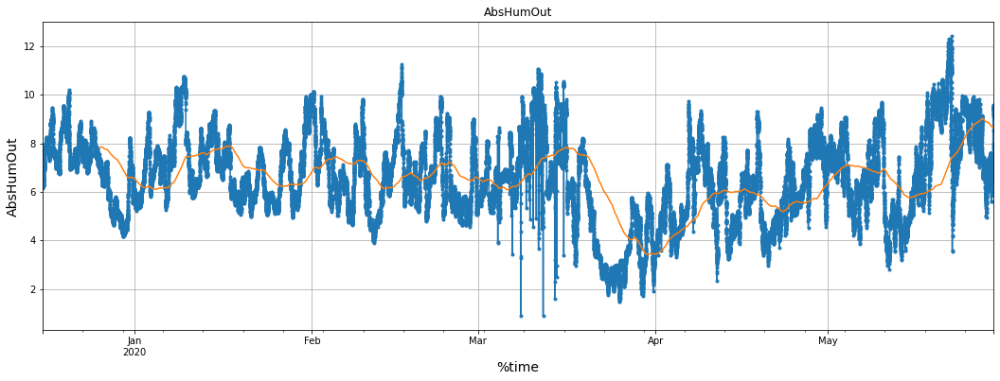

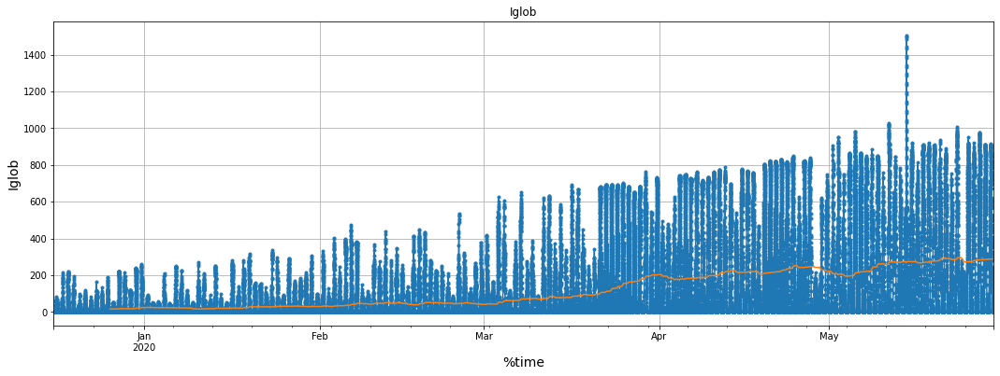

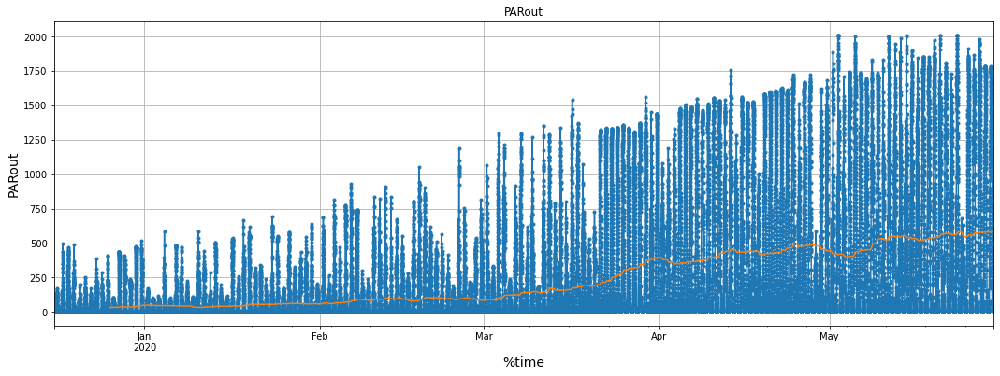

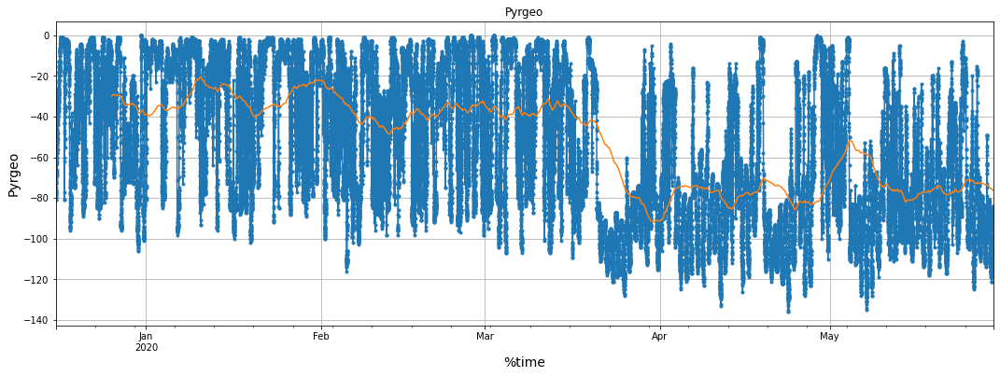

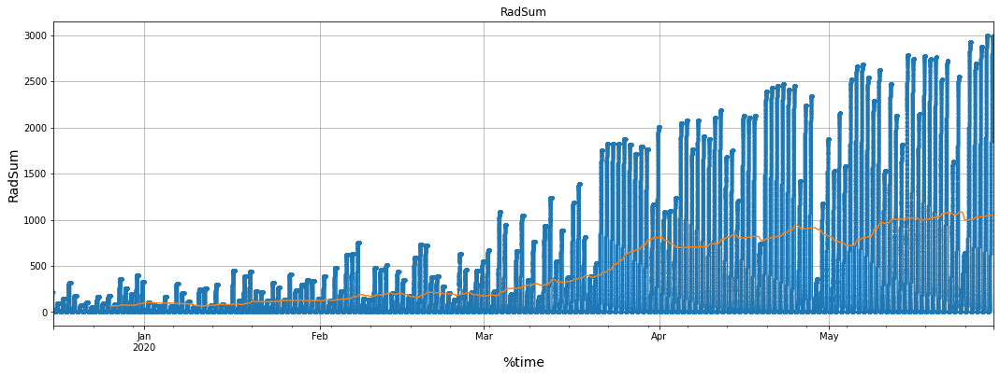

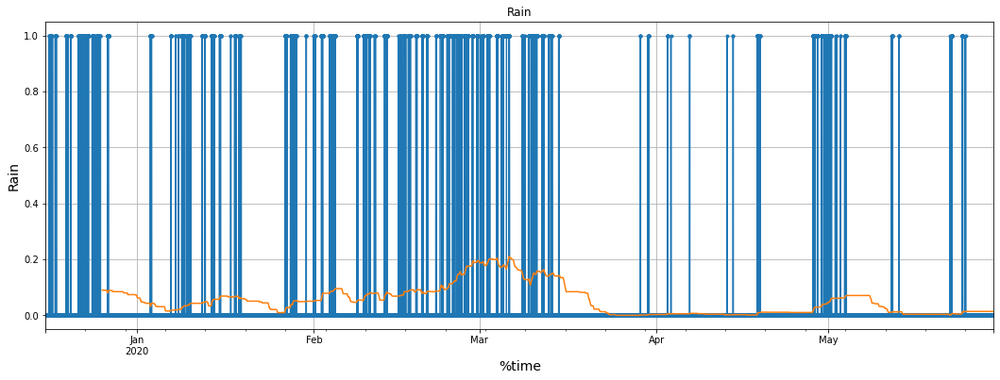

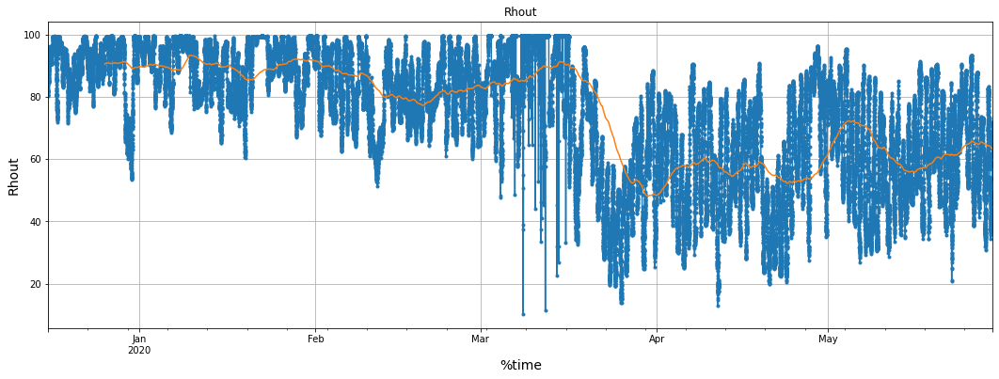

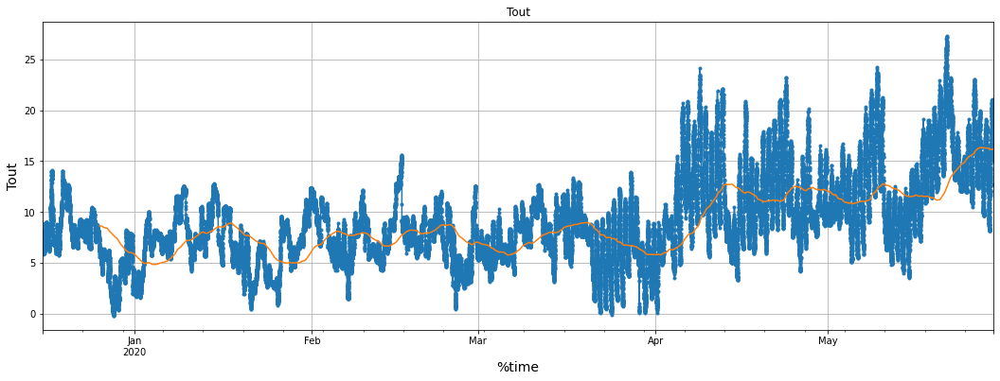

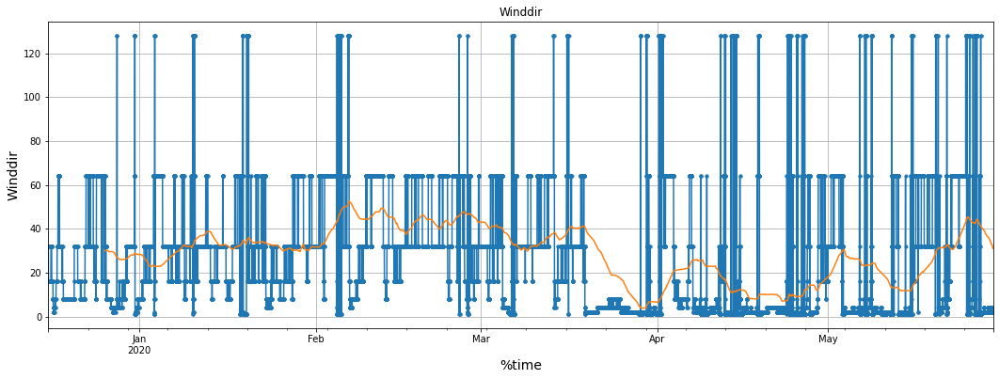

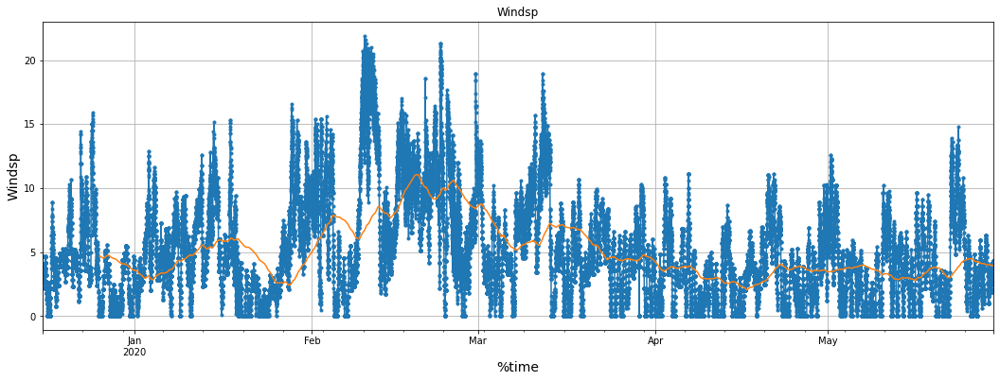

In [29]:
#for num_attribute in green_house_climate.columns:
#        for weather_attribute in weather.columns:
#            plt.scatter(x=weather[weather_attribute],y=green_house_climate[num_attribute])
#            plt.show()

#find a trend 
#weather['time']=weather.index
##print(weather['%time'].astype('string').str.split('.',expand=True).astype('int')[0])
#x=weather['time'].astype('string').str.split('/',expand=True).astype('int')[1]
#weather['time']=x



#print('weather[time]',weather.index)
#print('************')
#weather_attributes=weather.columns.drop(['time'])
for weather_attribute in weather.columns:
            fig = plt.figure(figsize=(10, 7))
            ax = fig.gca()
            dayly_avg = weather[weather_attribute].resample('H').mean()  # compute the mean for each hour
            #print(dayly_avg)
            period=slice("2019-12-16 00:00:00", "2020-05-30 00:00:00")
            rolling_average_dayly = dayly_avg[period].rolling(window=24*10).mean()
            #dayly_avg=weather.groupby(by=['time'])[weather_attribute].mean()
            #print(weather_attribute,weather.groupby(by=['time'])[weather_attribute].mean())
            weather[weather_attribute].plot(ax=ax,ylabel=weather_attribute,xlabel='Day Index',grid='True', marker=".", figsize=(18, 6))
            
            #rolling_average_dayly = dayly_avg.rolling(window=10).mean()
            #print(weather_attribute,rolling_average_dayly)
            rolling_average_dayly.plot(grid=True)
            ax.set_xlabel(xlabel='%time')
            ax.set_ylabel(ylabel=weather_attribute)
            ax.set_title(weather_attribute)
            plt.show()

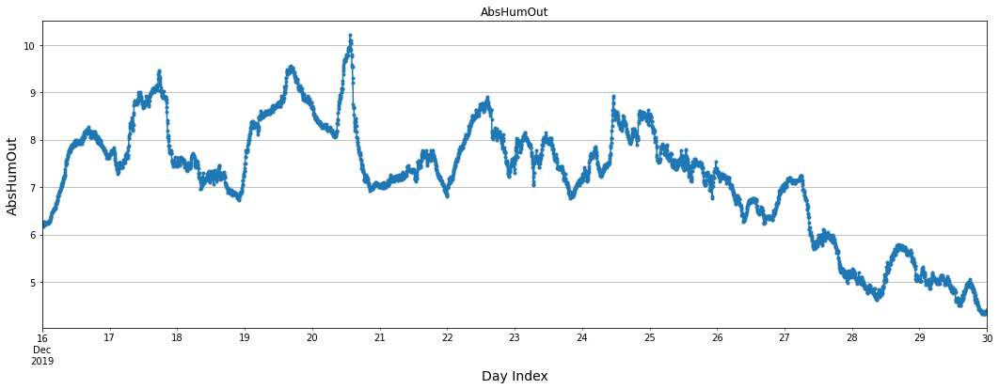

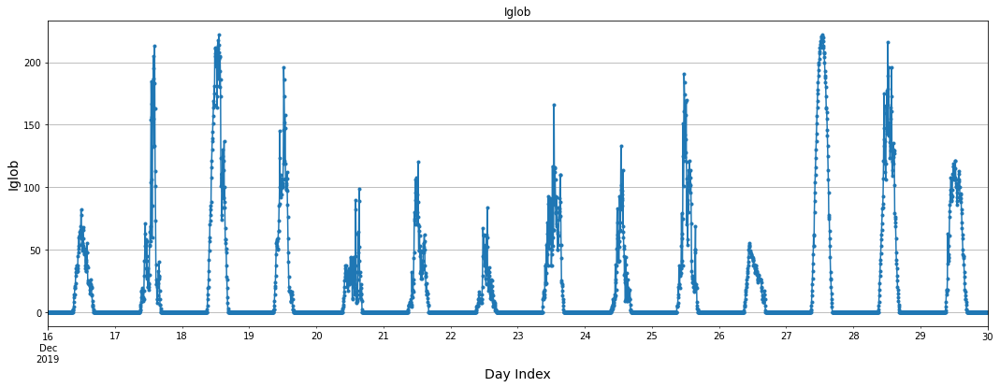

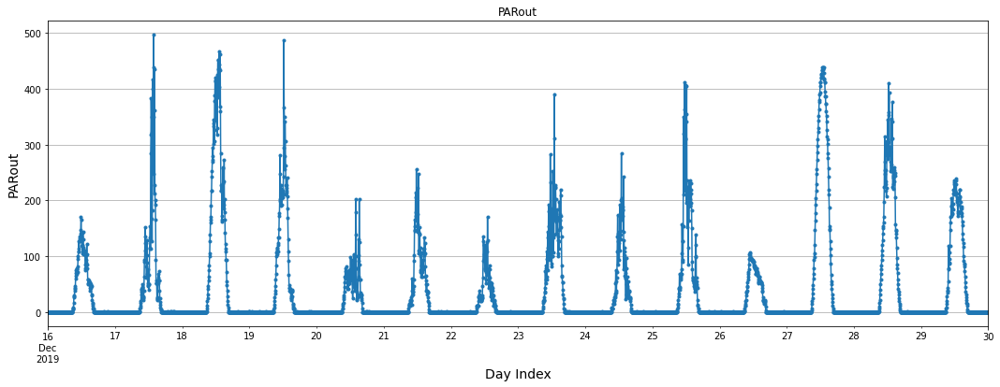

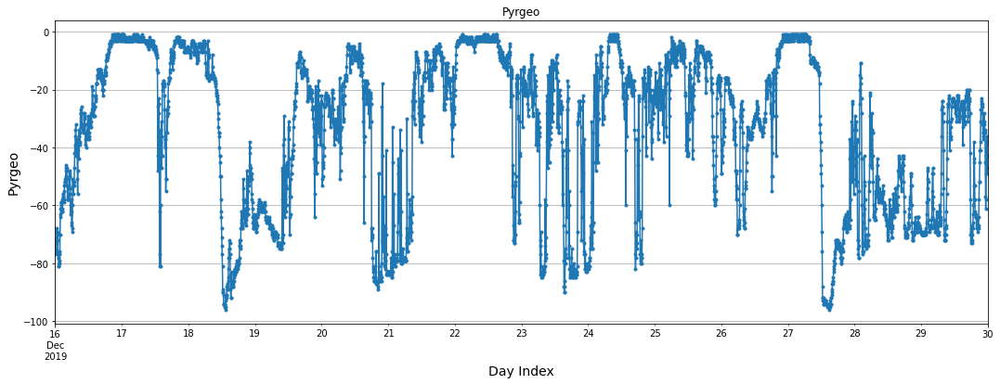

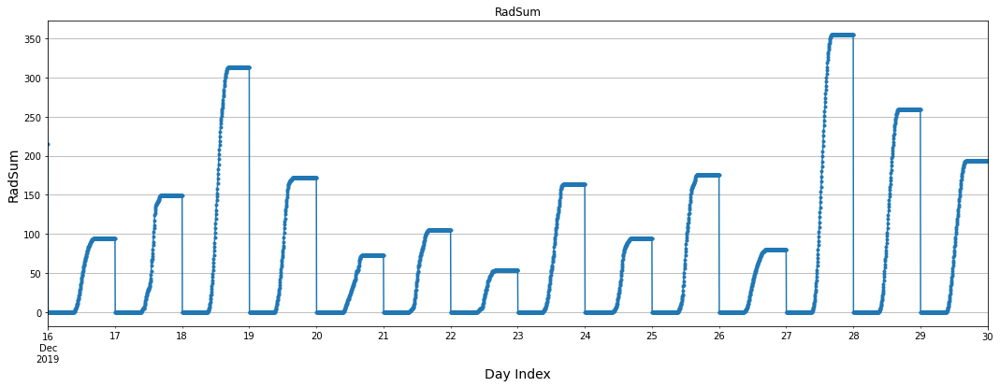

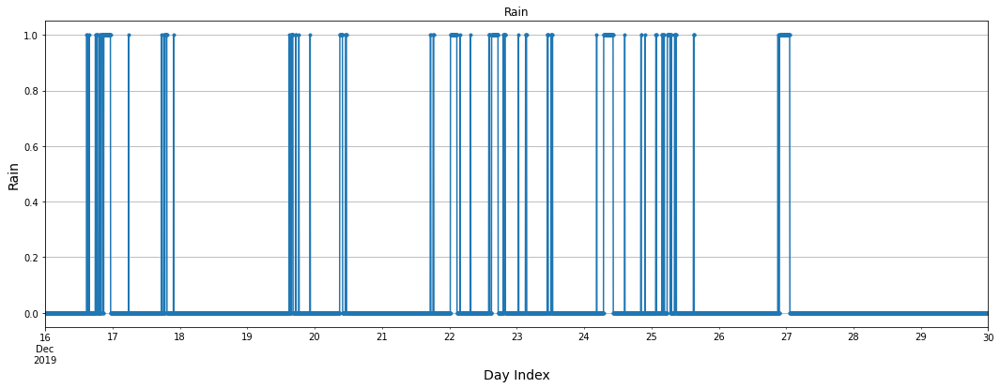

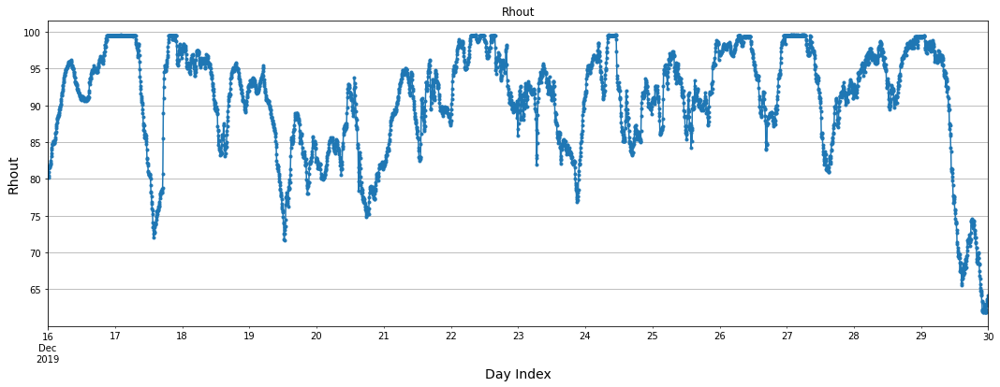

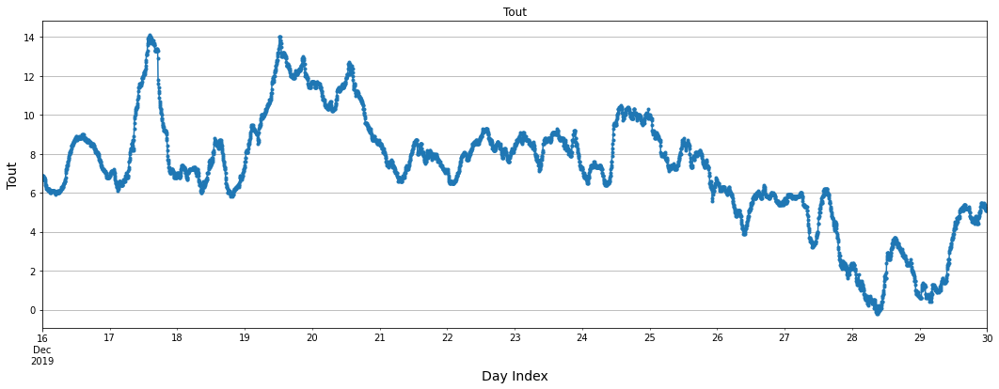

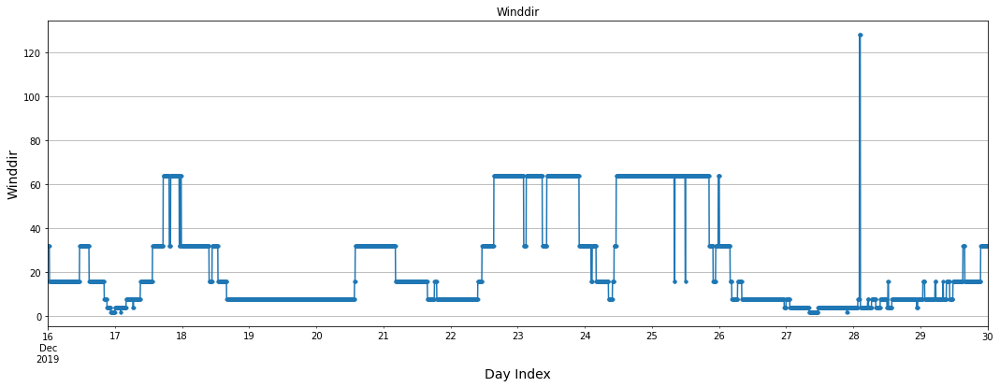

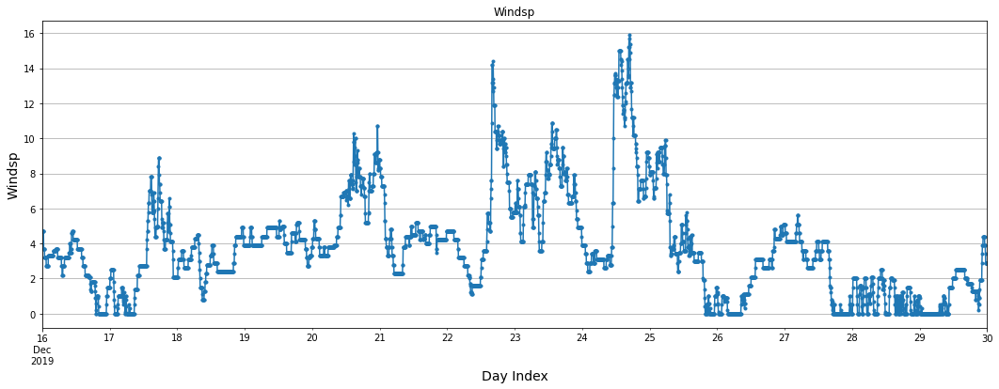

In [30]:
for weather_attribute in weather.columns:
            fig = plt.figure(figsize=(10, 7))
            ax = fig.gca()
            
            weather["2019-12-16 00:00:00" : "2019-12-30 00:00:00"][weather_attribute].plot(ylabel=weather_attribute,xlabel='Day Index',grid='True', marker=".", figsize=(18, 6))
            #ax.set_xlabel(xlabel='%time')
            #ax.set_ylabel(ylabel=weather_attribute)
            ax.set_title(weather_attribute)
            plt.show()

In [31]:
#from matplotlib import pyplot as plt
## 'Water_Quantity', 'Duration_of_Irrigation','Irrigation_Time_Intervals
#for col in green_house_climate.columns:
#    green_house_climate.boxplot(column=col, by='Duration_of_Irrigation', figsize=(6,6))
#    plt.title(col)
#plt.show()

In [32]:
#find the normal difference between the set point of a feature and the measured value from sensors
x=green_house_climate['assim_sp']-green_house_climate['assim_vip']
x.mean()/green_house_climate['assim_sp'].mean()

0.0017450155453585536

In [33]:
x=green_house_climate['co2_sp']-green_house_climate['co2_vip']
x.mean()/green_house_climate['co2_sp'].mean()

8.255038309577335e-05

In [34]:
sp_vip_paired_attributtes=[ [('assim_sp','assim_vip'),('assim_vip','assim_sp')],
                            [('co2_sp','co2_vip'),('co2_vip','co2_sp')],
                            [('dx_sp','dx_vip'),('dx_vip','dx_sp')],
                            [('int_blue_sp','int_blue_vip'),('int_blue_vip','int_blue_sp')],
                            [('int_farred_sp','int_farred_vip'),('int_farred_vip','int_farred_sp')],
                            [('int_red_sp','int_red_vip'),('int_red_vip','int_red_sp')], 
                            [('int_white_sp','int_white_vip'),('int_white_vip','int_white_sp')],
                            [('scr_blck_sp','scr_blck_vip'),('scr_blck_vip','scr_blck_sp')],
                            [('scr_enrg_sp','scr_enrg_vip'),('scr_enrg_vip','scr_enrg_sp')],
                            [('t_grow_min_sp','t_grow_min_vip'),('t_grow_min_vip','t_grow_min_sp')],
                            [('t_heat_sp','t_heat_vip'),('t_heat_vip','t_heat_sp')],
                            [('t_rail_min_sp','t_rail_min_vip'),('t_rail_min_vip','t_rail_min_sp')],
                            [('t_vent_sp','t_ventlee_vip'),('t_ventlee_vip','t_vent_sp')],
                            [('water_sup_intervals_sp_min','Irrigation_Time_Intervals'),('Irrigation_Time_Intervals','water_sup_intervals_sp_min')],
                            [('window_pos_lee_sp','window_pos_lee_vip'),('window_pos_lee_vip','window_pos_lee_sp')],
                            ]
norm_mean_difference=[]
similarity=[]

correlation between assim_vip and assim_sp= 0.9942036737272995
correlation between assim_sp and assim_vip= 0.9942100283101114
correlation between co2_vip and co2_sp= 0.9948393760910853
correlation between co2_sp and co2_vip= 0.9948403390722262
correlation between dx_vip and dx_sp= 0.6064001942633059
correlation between dx_sp and dx_vip= 0.6064391654922615
correlation between int_blue_vip and int_blue_sp= 0.945157798258523
correlation between int_blue_sp and int_blue_vip= 0.987682986071016
correlation between int_farred_vip and int_farred_sp= 0.5447196922668384
correlation between int_farred_sp and int_farred_vip= 0.6268321097629559
correlation between int_red_vip and int_red_sp= 0.916490004910697
correlation between int_red_sp and int_red_vip= 0.9817997430578049
correlation between int_white_vip and int_white_sp= 0.9171262811050991
correlation between int_white_sp and int_white_vip= 0.9819924524596267
correlation between scr_blck_vip and scr_blck_sp= 0.9909657302803839
correlation betw

C:\Users\user\AppData\Local\Temp\ipykernel_14404\1988363645.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


correlation between t_heat_vip and t_heat_sp= 0.990526617741412
correlation between t_heat_sp and t_heat_vip= 0.9905276043660715
correlation between t_rail_min_vip and t_rail_min_sp= 0.9743761314221864
correlation between t_rail_min_sp and t_rail_min_vip= 0.9743929252091067
correlation between t_ventlee_vip and t_vent_sp= 0.9973326618434729
correlation between t_vent_sp and t_ventlee_vip= 0.9973330285337844
correlation between Irrigation_Time_Intervals and water_sup_intervals_sp_min= 0.9784743873886008
correlation between water_sup_intervals_sp_min and Irrigation_Time_Intervals= 0.9784981636752192
correlation between window_pos_lee_vip and window_pos_lee_sp= 0.987026692867496
correlation between window_pos_lee_sp and window_pos_lee_vip= 0.9870305129515168


[['assim_sp', 'assim_vip', 0.0017450155453585536],
 ['assim_vip', 'assim_sp', -0.0017270311954876178],
 ['co2_sp', 'co2_vip', 8.255038309577335e-05],
 ['co2_vip', 'co2_sp', -8.12961347794899e-05],
 ['dx_sp', 'dx_vip', 0.003115237439508445],
 ['dx_vip', 'dx_sp', -0.0030711889854523264],
 ['int_blue_sp', 'int_blue_vip', 0.018470396149893507],
 ['int_blue_vip', 'int_blue_sp', -0.010684879221581824],
 ['int_farred_sp', 'int_farred_vip', 1.2113380521772517],
 ['int_farred_vip', 'int_farred_sp', -5.948270584634222],
 ['int_red_sp', 'int_red_vip', 0.033127672908969695],
 ['int_red_vip', 'int_red_sp', -0.019511217745719837],
 ['int_white_sp', 'int_white_vip', 0.03234839391118867],
 ['int_white_vip', 'int_white_sp', -0.019199986208604542],
 ['scr_blck_sp', 'scr_blck_vip', 0.0012142842242151139],
 ['scr_blck_vip', 'scr_blck_sp', -0.0012024682808729704],
 ['scr_enrg_sp', 'scr_enrg_vip', 0.0010902443596042864],
 ['scr_enrg_vip', 'scr_enrg_sp', -0.0010779612707407528],
 ['t_grow_min_sp', 't_grow_mi

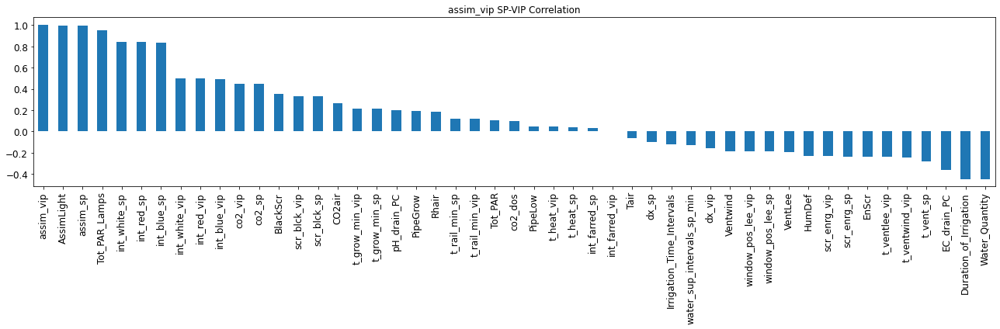

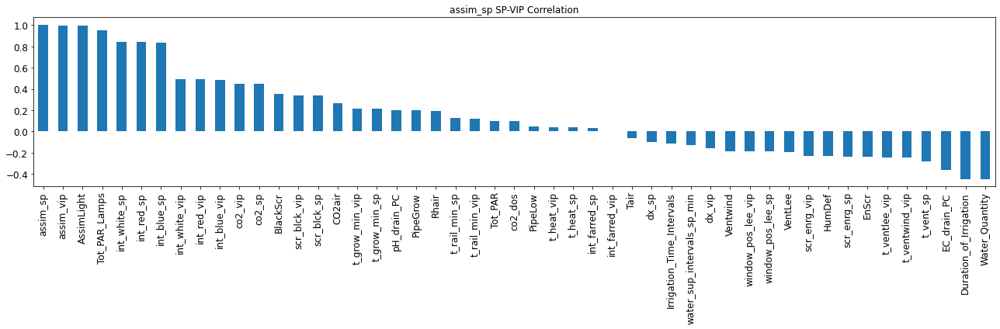

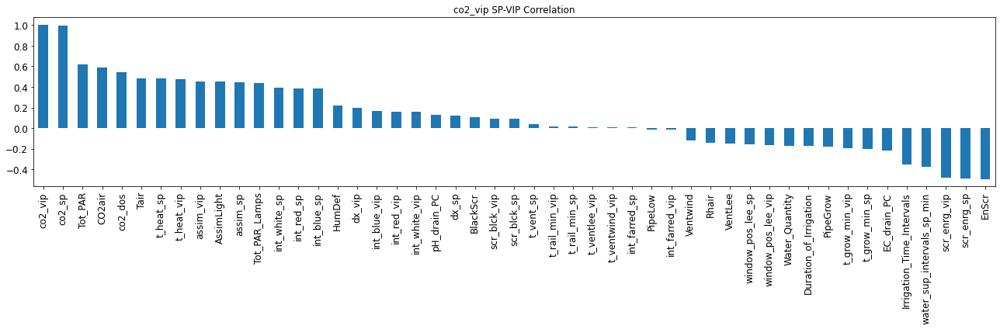

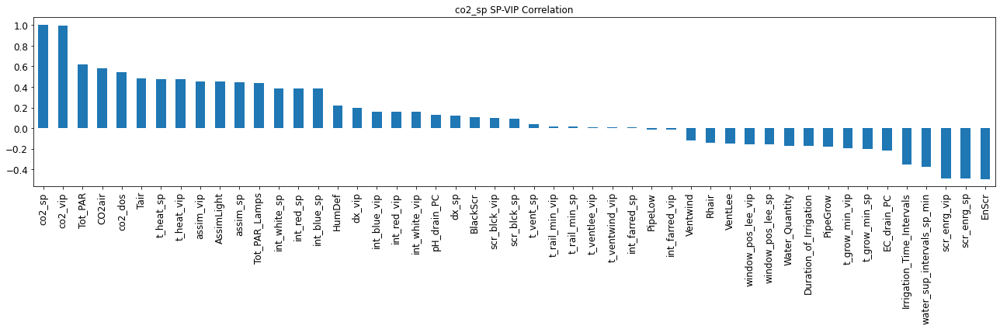

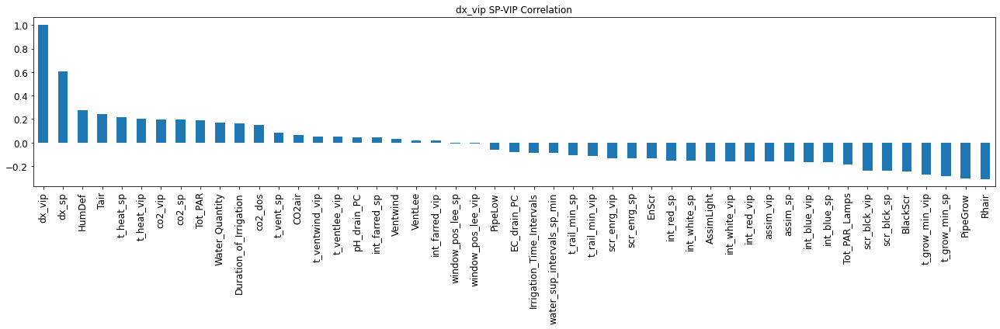

...

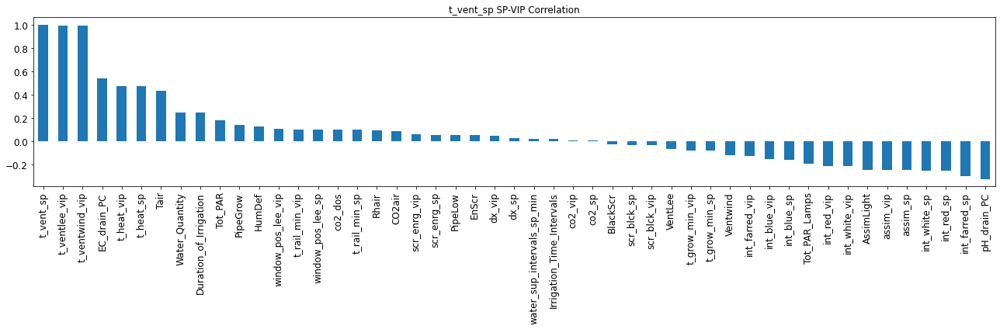

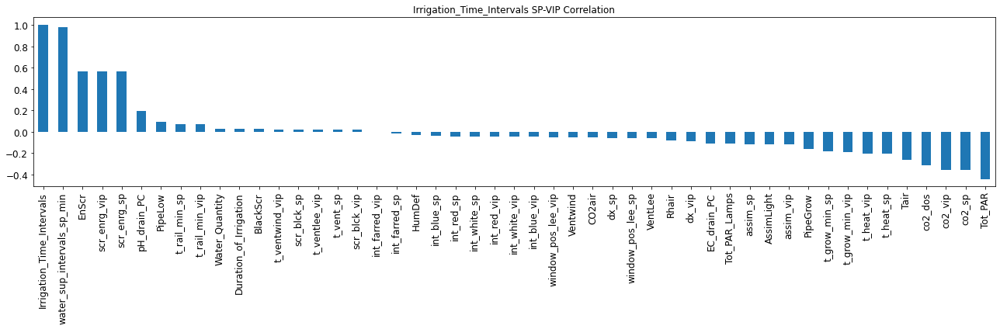

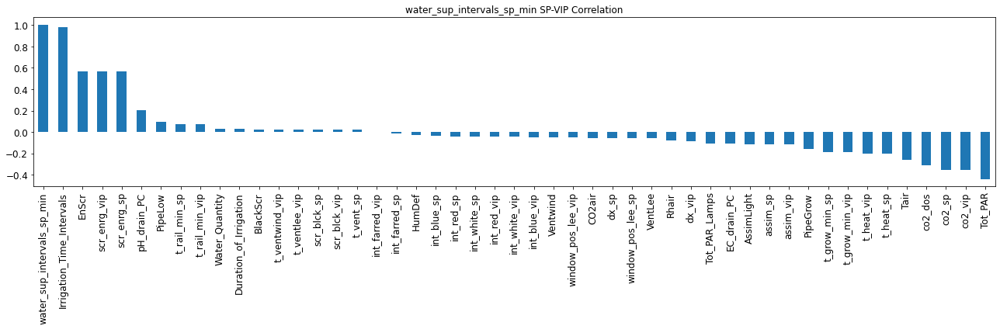

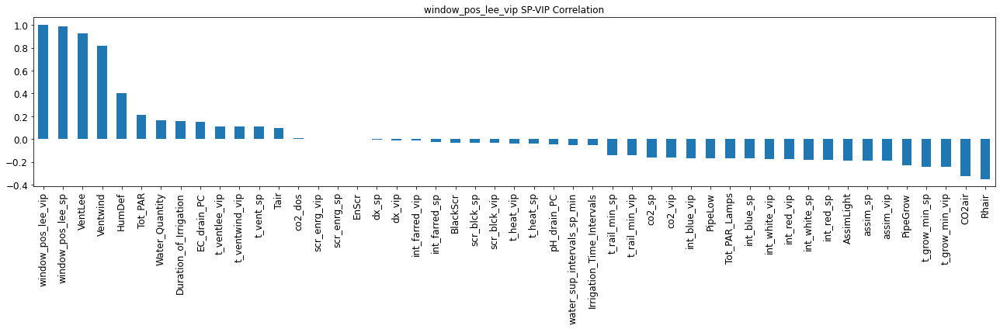

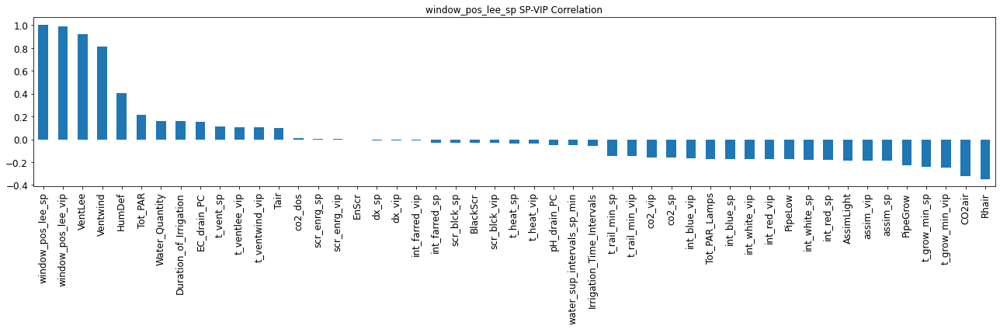

In [35]:
for sp_vip_paired_attributte in sp_vip_paired_attributtes: 
    for (sp, vip) in sp_vip_paired_attributte:
        x=green_house_climate.iloc[(np.where(green_house_climate[sp].isnull()))][vip]
        #print(green_house_climate[sp])
        difference=(green_house_climate[sp]-green_house_climate[vip]).mean()
        mean_difference=difference/(green_house_climate[sp].mean())
        norm_mean_difference.append([sp,vip,mean_difference])
        
        #print(f'{sp},{vip} difference={norm_mean_difference}')
        #print(x.index)
        for i in x.index:
            #print(i)
            green_house_climate.loc[i,sp]= green_house_climate.loc[i,vip]#.iloc[i][vip]
            #print(i,green_house_climate.loc[i,sp]) 
        plt.figure()
        correlation = green_house_climate.corr()[vip][sp]
        corr1=green_house_climate.corr()[vip].sort_values(ascending=False)
        corr1.plot(kind='bar',title=f'{vip} SP-VIP Correlation',figsize=(18, 6),fontsize=12)
        plt.show
        save_fig(f'{vip}SP-VIP Correlation')
        print(f"correlation between {vip} and {sp}=",correlation)
        plt.show
norm_mean_difference     




In [458]:
norm_diff=pd.DataFrame(np.array(norm_mean_difference),columns=['sp-vip','vip-sp','Norm difference'])


,sp-vip,vip-sp,Norm difference
0,assim_sp,assim_vip,0.0017450155453585536
1,assim_vip,assim_sp,-0.0017270311954876178
2,co2_sp,co2_vip,8.255038309577335e-05
3,co2_vip,co2_sp,-8.12961347794899e-05
4,dx_sp,dx_vip,0.003115237439508445
5,dx_vip,dx_sp,-0.0030711889854523264
6,int_blue_sp,int_blue_vip,0.018470396149893507
7,int_blue_vip,int_blue_sp,-0.010684879221581824
8,int_farred_sp,int_farred_vip,1.2113380521772517
9,int_farred_vip,int_farred_sp,-5.948270584634222


In [459]:

green_house_climate.isnull().sum()

AssimLight                    71
BlackScr                      71
CO2air                        71
EC_drain_PC                   71
EnScr                         71
HumDef                        71
PipeGrow                      71
PipeLow                       71
Rhair                         71
Tair                          71
Tot_PAR                       71
Tot_PAR_Lamps                  0
VentLee                       71
Ventwind                      71
assim_sp                      15
assim_vip                     15
co2_dos                        2
co2_sp                        15
co2_vip                       15
dx_sp                         15
dx_vip                        15
int_blue_sp                   16
int_blue_vip                  16
int_farred_sp                  1
int_farred_vip                 1
int_red_sp                    16
int_red_vip                   16
int_white_sp                   1
int_white_vip                  1
pH_drain_PC                   71
scr_blck_s

In [460]:
#x=green_house_climate.iloc[(np.where(green_house_climate['assim_sp'].isnull()))]['assim_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'assim_sp']= green_house_climate.iloc[i]['assim_vip']
#        #print(i,green_house_climate.loc[i,'assim_sp'])  
#        
##green_house_climate.iloc[np.where(green_house_climate['assim_sp'].isnull())]['assim_sp']  =    green_house_climate.iloc[np.where(green_house_climate['assim_sp'].isnull())]['assim_vip']                 #785 
#x=green_house_climate.iloc[(np.where(green_house_climate['assim_vip'].isnull()))]['assim_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'assim_vip']= green_house_climate.iloc[i]['assim_sp']
#        #print(i,green_house_climate.loc[i,'assim_vip'])  
#
#
#
##green_house_climate['assim_vip']                        #71   
#        
#x=green_house_climate.iloc[(np.where(green_house_climate['co2_sp'].isnull()))]['co2_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'co2_sp']= green_house_climate.iloc[i]['co2_vip']
#        #print(i,green_house_climate.loc[i,'co2_sp']) 
##green_house_climate['co2_dos']                        #2    
##green_house_climate.iloc[np.where(green_house_climate['co2_sp'].isnull())]['co2_sp']  =    green_house_climate.iloc[np.where(green_house_climate['co2_sp'].isnull())]['co2_vip']                        #754
#
#x=green_house_climate.iloc[(np.where(green_house_climate['co2_vip'].isnull()))]['co2_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'co2_vip']= green_house_climate.iloc[i]['co2_sp']
#        #print(i,green_house_climate.loc[i,'co2_vip']) 
#
#
##green_house_climate['co2_vip']                       #71   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['dx_sp'].isnull()))]['dx_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'dx_sp']= green_house_climate.iloc[i]['dx_vip']
#        #print(i,green_house_climate.loc[i,'dx_sp'])  
#        
#
#
##green_house_climate.iloc[np.where(green_house_climate['dx_sp'].isnull())]['dx_sp']  =    green_house_climate.iloc[np.where(green_house_climate['dx_sp'].isnull())]['dx_vip']                       #718  
#        
#x=green_house_climate.iloc[(np.where(green_house_climate['dx_vip'].isnull()))]['dx_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'dx_vip']= green_house_climate.iloc[i]['dx_sp']
#        #print(i,green_house_climate.loc[i,'dx_vip'])  
#        
#
##green_house_climate['dx_vip']                       #71   
#        
#x=green_house_climate.iloc[(np.where(green_house_climate['int_blue_sp'].isnull()))]['int_blue_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_blue_sp']= green_house_climate.iloc[i]['int_blue_vip']
#        #print(i,green_house_climate.loc[i,'int_blue_sp'])  
#        
#
##green_house_climate['int_blue_sp']                       #173  
#
#
#x=green_house_climate.iloc[(np.where(green_house_climate['int_blue_vip'].isnull()))]['int_blue_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_blue_vip']= green_house_climate.iloc[i]['int_blue_sp']
#        #print(i,green_house_climate.loc[i,'int_blue_vip'])  
#        
#
#
##green_house_climate.iloc[np.where(green_house_climate['int_blue_vip'].isnull())]['int_blue_vip']  =    green_house_climate.iloc[np.where(green_house_climate['int_blue_vip'].isnull())]['int_blue_sp']                   #22152
#
#x=green_house_climate.iloc[(np.where(green_house_climate['int_farred_vip'].isnull()))]['int_farred_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_farred_vip']= green_house_climate.iloc[i]['int_farred_sp']
#        #print(i,green_house_climate.loc[i,'int_farred_vip'])  
#
##green_house_climate['int_farred_sp']                   #14   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['int_farred_sp'].isnull()))]['int_farred_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_farred_sp']= green_house_climate.iloc[i]['int_farred_vip']
#        #print(i,green_house_climate.loc[i,'int_farred_sp']) 
#
##green_house_climate.iloc[np.where(green_house_climate['int_farred_vip'].isnull())]['int_farred_vip']  =    green_house_climate.iloc[np.where(green_house_climate['int_farred_vip'].isnull())]['int_farred_sp']                   #22152
#
#x=green_house_climate.iloc[(np.where(green_house_climate['int_red_vip'].isnull()))]['int_red_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_red_vip']= green_house_climate.iloc[i]['int_red_sp']
#        #print(i,green_house_climate.loc[i,'int_red_vip'])  
#
#
#
##green_house_climate['int_red_sp']                   #173  
#
#x=green_house_climate.iloc[(np.where(green_house_climate['int_red_sp'].isnull()))]['int_red_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_red_sp']= green_house_climate.iloc[i]['int_red_vip']
#        #print(i,green_house_climate.loc[i,'int_red_sp'])  
#
#
#
##green_house_climate.iloc[np.where(green_house_climate['int_red_vip'].isnull())]['int_red_vip']  =    green_house_climate.iloc[np.where(green_house_climate['int_red_vip'].isnull())]['int_red_sp']                   #22152
#
#x=green_house_climate.iloc[(np.where(green_house_climate['int_white_vip'].isnull()))]['int_white_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_white_vip']= green_house_climate.iloc[i]['int_white_sp']
#        #print(i,green_house_climate.loc[i,'int_white_vip'])  
#
#
##green_house_climate['int_white_sp']                   #14   
#        
#x=green_house_climate.iloc[(np.where(green_house_climate['int_white_sp'].isnull()))]['int_white_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'int_white_sp']= green_house_climate.iloc[i]['int_white_vip']
#        #print(i,green_house_climate.loc[i,'int_white_sp'])  
#
#
##green_house_climate.iloc[np.where(green_house_climate['int_white_vip'].isnull())]['int_white_vip']  =    green_house_climate.iloc[np.where(green_house_climate['int_white_vip'].isnull())]['int_white_sp']                   #22152
##green_house_climate['pH_drain_PC']                   #71   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['scr_blck_sp'].isnull()))]['scr_blck_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'scr_blck_sp']= green_house_climate.iloc[i]['scr_blck_vip']
#        #print(i,green_house_climate.loc[i,'scr_blck_sp'])  
#
#
#
##green_house_climate.iloc[np.where(green_house_climate['scr_blck_sp'].isnull())]['scr_blck_sp']  =    green_house_climate.iloc[np.where(green_house_climate['scr_blck_sp'].isnull())]['scr_blck_vip']                   #783  
#
#x=green_house_climate.iloc[(np.where(green_house_climate['scr_blck_vip'].isnull()))]['scr_blck_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'scr_blck_vip']= green_house_climate.iloc[i]['scr_blck_sp']
#        #print(i,green_house_climate.loc[i,'scr_blck_vip'])  
#
#
#
##green_house_climate['scr_blck_vip']                   #71   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['scr_enrg_sp'].isnull()))]['scr_enrg_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'scr_enrg_sp']= green_house_climate.iloc[i]['scr_enrg_vip']
#        #print(i,green_house_climate.loc[i,'scr_enrg_sp'])  
#
#
##green_house_climate.iloc[np.where(green_house_climate['scr_enrg_sp'].isnull())]['scr_enrg_sp']  =    green_house_climate.iloc[np.where(green_house_climate['scr_enrg_sp'].isnull())]['scr_enrg_vip']                  #785  
#
#x=green_house_climate.iloc[(np.where(green_house_climate['scr_enrg_vip'].isnull()))]['scr_enrg_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'scr_enrg_vip']= green_house_climate.iloc[i]['scr_enrg_sp']
#        #print(i,green_house_climate.loc[i,'scr_enrg_vip'])  
#
#
#
##green_house_climate['scr_enrg_vip']                   #71   
#
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_grow_min_sp'].isnull()))]['t_grow_min_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_grow_min_sp']= green_house_climate.iloc[i]['t_grow_min_vip']
#        #print(i,green_house_climate.loc[i,'t_grow_min_sp'])  
#
#
##green_house_climate.iloc[np.where(green_house_climate['t_grow_min_sp'].isnull())]['t_grow_min_sp']  =    green_house_climate.iloc[np.where(green_house_climate['t_grow_min_sp'].isnull())]['t_grow_min_vip']                  #1505 
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_grow_min_vip'].isnull()))]['t_grow_min_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_grow_min_vip']= green_house_climate.iloc[i]['t_grow_min_sp']
#        #print(i,green_house_climate.loc[i,'t_grow_min_vip'])  
#
##green_house_climate['t_grow_min_vip']                   #71   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_heat_sp'].isnull()))]['t_heat_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_heat_sp']= green_house_climate.iloc[i]['t_heat_vip']
#        #print(i,green_house_climate.loc[i,'t_heat_sp'])  
#
#
##green_house_climate.iloc[np.where(green_house_climate['t_heat_sp'].isnull())]['t_heat_sp']  =    green_house_climate.iloc[np.where(green_house_climate['t_heat_sp'].isnull())]['t_heat_vip']                   #706  
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_heat_vip'].isnull()))]['t_heat_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_heat_vip']= green_house_climate.iloc[i]['t_heat_sp']
#        #print(i,green_house_climate.loc[i,'t_heat_vip'])  
#
##green_house_climate['t_heat_vip']                   #71   
#
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_rail_min_sp'].isnull()))]['t_rail_min_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_rail_min_sp']= green_house_climate.iloc[i]['t_rail_min_vip']
#        #print(i,green_house_climate.loc[i,'t_rail_min_sp'])  
#
#
#
##green_house_climate.iloc[np.where(green_house_climate['t_rail_min_sp'].isnull())]['t_rail_min_sp']  =    green_house_climate.iloc[np.where(green_house_climate['t_rail_min_sp'].isnull())]['t_rail_min_vip']                   #787  
#x=green_house_climate.iloc[(np.where(green_house_climate['t_rail_min_vip'].isnull()))]['t_rail_min_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_rail_min_vip']= green_house_climate.iloc[i]['t_rail_min_sp']
#        #print(i,green_house_climate.loc[i,'t_rail_min_vip'])  
#
#
##green_house_climate['t_rail_min_vip']                   #71   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_vent_sp'].isnull()))]['t_vent_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_vent_sp']= green_house_climate.iloc[i]['t_ventlee_vip']
#        #print(i,green_house_climate.loc[i,'t_vent_sp'])  
#
#
##green_house_climate.iloc[np.where(green_house_climate['t_vent_sp'].isnull())]['t_vent_sp']  =    green_house_climate.iloc[np.where(green_house_climate['t_vent_sp'].isnull())]['t_ventlee_vip']                   #12576
#
#x=green_house_climate.iloc[(np.where(green_house_climate['t_ventlee_vip'].isnull()))]['t_ventlee_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'t_ventlee_vip']= green_house_climate.iloc[i]['t_vent_sp']
#        #print(i,green_house_climate.loc[i,'t_ventlee_vip'])  
#
#
#
##green_house_climate['t_ventlee_vip']                   #71   
##green_house_climate['t_ventwind_vip']                   #71   
#
#x=green_house_climate.iloc[(np.where(green_house_climate['water_sup_intervals_sp_min'].isnull()))]['water_sup_intervals_sp_min']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'water_sup_intervals_sp_min']= green_house_climate.iloc[i]['Irrigation_Time_Intervals']
#        #print(i,green_house_climate.loc[i,'water_sup_intervals_sp_min'])  
#
##green_house_climate.iloc[np.where(green_house_climate['water_sup_intervals_sp_min'].isnull())]['water_sup_intervals_sp_min']  =    green_house_climate.iloc[np.where(green_house_climate['water_sup_intervals_sp_min'].isnull())]['Irrigation_Time_Intervals']    #1410 
#
#x=green_house_climate.iloc[(np.where(green_house_climate['window_pos_lee_sp'].isnull()))]['window_pos_lee_sp']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'window_pos_lee_sp']= green_house_climate.iloc[i]['window_pos_lee_vip']
#        #print(i,green_house_climate.loc[i,'window_pos_lee_sp'])  
#
#
##green_house_climate.iloc[np.where(green_house_climate['window_pos_lee_sp'].isnull())]['window_pos_lee_sp']  =    green_house_climate.iloc[np.where(green_house_climate['window_pos_lee_sp'].isnull())]['window_pos_lee_vip']    #715  
#x=green_house_climate.iloc[(np.where(green_house_climate['window_pos_lee_vip'].isnull()))]['window_pos_lee_vip']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'window_pos_lee_vip']= green_house_climate.iloc[i]['window_pos_lee_sp']
#        #print(i,green_house_climate.loc[i,'window_pos_lee_vip'])  
#
##green_house_climate['window_pos_lee_vip']    #71   
##green_house_climate['Water_Quantity']    #71   
##green_house_climate['Duration_of_Irrigation']    #71   
##green_house_climate['Irrigation_Time_Intervals']    #71   
#x=green_house_climate.iloc[(np.where(green_house_climate['Irrigation_Time_Intervals'].isnull()))]['Irrigation_Time_Intervals']
#for i in x.index:
#        #print(i)
#        green_house_climate.loc[i,'Irrigation_Time_Intervals']= green_house_climate.iloc[i]['water_sup_intervals_sp_min']
#        #print(i,green_house_climate.loc[i,'Irrigation_Time_Intervals'])  
#
#

In [461]:
green_house_climate.isnull().sum()

AssimLight                    71
BlackScr                      71
CO2air                        71
EC_drain_PC                   71
EnScr                         71
HumDef                        71
PipeGrow                      71
PipeLow                       71
Rhair                         71
Tair                          71
Tot_PAR                       71
Tot_PAR_Lamps                  0
VentLee                       71
Ventwind                      71
assim_sp                      15
assim_vip                     15
co2_dos                        2
co2_sp                        15
co2_vip                       15
dx_sp                         15
dx_vip                        15
int_blue_sp                   16
int_blue_vip                  16
int_farred_sp                  1
int_farred_vip                 1
int_red_sp                    16
int_red_vip                   16
int_white_sp                   1
int_white_vip                  1
pH_drain_PC                   71
scr_blck_s

In [470]:
from datetime import datetime
for gh_attribute in green_house_climate.columns:
    x=green_house_climate.iloc[(np.where(green_house_climate[gh_attribute].isnull()))][gh_attribute]
    for i in reversed(x.index):
        if i.day+(1)< green_house_climate.index[-1].day:
            #print(i+(12*24))
            d=i
            print(d)
            
            d = d.replace(day=d.day+1)
           
            print(d)
            green_house_climate.loc[i,gh_attribute]= green_house_climate.loc[d,gh_attribute]
            #print(i+(12*24),green_house_climate.loc[i,gh_attribute])
for gh_attribute in green_house_climate.columns:
    x=green_house_climate.iloc[(np.where(green_house_climate[gh_attribute].isnull()))][gh_attribute]
    for i in x.index:
        if i.day-(1)>= 0:
            #print(i+(12*24))
            d=i
            print(d)
            d = d.replace(day=d.day-1)
            print(d)
            green_house_climate.loc[i,gh_attribute]= green_house_climate.loc[d,gh_attribute]
            #print(i+(12*24),green_house_climate.loc[i,gh_attribute])

2020-03-29 01:50:00
2020-03-28 01:50:00
2020-03-29 01:55:00
2020-03-28 01:55:00
2020-03-29 02:00:00
2020-03-28 02:00:00
2020-03-29 02:05:00
2020-03-28 02:05:00
2020-03-29 02:10:00
2020-03-28 02:10:00
2020-03-29 02:15:00
2020-03-28 02:15:00
2020-03-29 02:20:00
2020-03-28 02:20:00
2020-03-29 02:25:00
2020-03-28 02:25:00
2020-03-29 02:30:00
2020-03-28 02:30:00
2020-03-29 02:35:00
2020-03-28 02:35:00
2020-03-29 02:40:00
2020-03-28 02:40:00
2020-03-29 02:45:00
2020-03-28 02:45:00
2020-03-29 02:50:00
2020-03-28 02:50:00
2020-03-29 02:55:00
2020-03-28 02:55:00
2020-03-30 06:30:00
2020-03-29 06:30:00
2020-03-30 06:35:00
2020-03-29 06:35:00
2020-03-30 06:40:00
2020-03-29 06:40:00
2020-03-30 06:45:00
2020-03-29 06:45:00
2020-03-30 06:50:00
2020-03-29 06:50:00
2020-03-30 06:55:00
2020-03-29 06:55:00
2020-03-30 07:00:00
2020-03-29 07:00:00
2020-03-30 07:05:00
2020-03-29 07:05:00
2020-03-30 07:10:00
2020-03-29 07:10:00
2020-03-30 07:15:00
2020-03-29 07:15:00
2020-03-30 07:20:00
2020-03-29 07:20:00


In [473]:
green_house_climate.isnull().sum()

AssimLight                    0
BlackScr                      0
CO2air                        0
EC_drain_PC                   0
EnScr                         0
HumDef                        0
PipeGrow                      0
PipeLow                       0
Rhair                         0
Tair                          0
Tot_PAR                       0
Tot_PAR_Lamps                 0
VentLee                       0
Ventwind                      0
assim_sp                      0
assim_vip                     0
co2_dos                       0
co2_sp                        0
co2_vip                       0
dx_sp                         0
dx_vip                        0
int_blue_sp                   0
int_blue_vip                  0
int_farred_sp                 0
int_farred_vip                0
int_red_sp                    0
int_red_vip                   0
int_white_sp                  0
int_white_vip                 0
pH_drain_PC                   0
scr_blck_sp                   0
scr_blck

In [474]:
#green_house_climate = green_house_climate.set_index("%time")


KeyError: "None of ['%time'] are in the columns"

In [475]:
green_house_climate.shape[1]

49

In [477]:
root_zone=pd.read_csv("C:\\Users\\user\\Desktop\\iman\\Master\\RoboticsAndControlSystems\\Project\\Data\\Automatoes\\GrodanSens.csv",parse_dates=["%time"],low_memory=False).set_index('%time').astype(float)


In [479]:
root_zone.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 47809 entries, 2019-12-16 00:00:00 to 2020-05-30 00:00:00
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   EC_slab1  45483 non-null  float64
 1   EC_slab2  45483 non-null  float64
 2   WC_slab1  45483 non-null  float64
 3   WC_slab2  45483 non-null  float64
 4   t_slab1   45483 non-null  float64
 5   t_slab2   45483 non-null  float64
dtypes: float64(6)
memory usage: 2.6 MB


In [480]:
root_zone.head()

,EC_slab1,EC_slab2,WC_slab1,WC_slab2,t_slab1,t_slab2
%time,,,,,,
2019-12-16 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN
2019-12-16 00:05:00,NaN,NaN,NaN,NaN,NaN,NaN
2019-12-16 00:10:00,NaN,NaN,NaN,NaN,NaN,NaN
2019-12-16 00:15:00,NaN,NaN,NaN,NaN,NaN,NaN
2019-12-16 00:20:00,NaN,NaN,NaN,NaN,NaN,NaN


In [481]:
root_zone.isnull().sum()

EC_slab1    2326
EC_slab2    2326
WC_slab1    2326
WC_slab2    2326
t_slab1     2326
t_slab2     2326
dtype: int64

In [483]:
x=root_zone.iloc[(np.where(root_zone['EC_slab1'].isnull()))]


In [485]:
#for root_attribute in ['EC_slab1'  , 'EC_slab2' , 'WC_slab1' , 'WC_slab2'   , 't_slab1','t_slab2' ]:
#    for i in reversed(x.index):
#        if i.day+1< int(root_zone.index[-1].day):
#            #print(i+(12*24))
#            root_zone.loc[i,root_attribute]= root_zone.iloc[i+12*24][root_attribute]
#            #print(i+(12*24),root_zone.loc[i,root_attribute])


for rz_attribute in root_zone.columns:
    x=root_zone.iloc[(np.where(root_zone[rz_attribute].isnull()))][rz_attribute]
    for i in reversed(x.index):
        if i.day+(1)< root_zone.index[-1].day:
            #print(i+(12*24))
            d=i
            print(d)
            
            d = d.replace(day=d.day+1)
           
            print(d)
            root_zone.loc[i,rz_attribute]= root_zone.loc[d,rz_attribute]
            #print(i+(12*24),root_zone.loc[i,rz_attribute])

            

2020-05-28 23:55:00
2020-05-29 23:55:00
2020-05-28 23:50:00
2020-05-29 23:50:00
2020-05-28 23:45:00
2020-05-29 23:45:00
2020-05-28 23:40:00
2020-05-29 23:40:00
2020-05-28 23:35:00
2020-05-29 23:35:00
2020-05-28 23:30:00
2020-05-29 23:30:00
2020-05-28 23:25:00
2020-05-29 23:25:00
2020-05-28 23:20:00
2020-05-29 23:20:00
2020-05-28 23:15:00
2020-05-29 23:15:00
2020-05-28 23:10:00
2020-05-29 23:10:00
2020-05-28 23:05:00
2020-05-29 23:05:00
2020-05-28 23:00:00
2020-05-29 23:00:00
2020-05-28 22:55:00
2020-05-29 22:55:00
2020-05-28 22:50:00
2020-05-29 22:50:00
2020-05-28 22:45:00
2020-05-29 22:45:00
2020-05-28 22:40:00
2020-05-29 22:40:00
2020-05-28 22:35:00
2020-05-29 22:35:00
2020-05-28 22:30:00
2020-05-29 22:30:00
2020-05-28 22:25:00
2020-05-29 22:25:00
2020-05-28 22:20:00
2020-05-29 22:20:00
2020-05-28 22:15:00
2020-05-29 22:15:00
2020-05-28 22:10:00
2020-05-29 22:10:00
2020-05-28 22:05:00
2020-05-29 22:05:00
2020-05-28 22:00:00
2020-05-29 22:00:00
2020-05-28 21:55:00
2020-05-29 21:55:00


In [486]:
#for root_attribute in ['EC_slab1'  , 'EC_slab2' , 'WC_slab1' , 'WC_slab2'   , 't_slab1','t_slab2' ]:
#    for i in x.index:
#        if i-(12*24)>= 0:
#            #print(i+(12*24))
#            root_zone.loc[i,root_attribute]= root_zone.iloc[i-12*24][root_attribute]
#            #print(i+(12*24),root_zone.loc[i,root_attribute])

for rz_attribute in root_zone.columns:
    x=root_zone.iloc[(np.where(root_zone[rz_attribute].isnull()))][rz_attribute]
    for i in x.index:
        if i.day-(1)>= root_zone.index[0].day:
            #print(i+(12*24))
            d=i
            print(d)
            
            d = d.replace(day=d.day-1)
           
            print(d)
            root_zone.loc[i,rz_attribute]= root_zone.loc[d,rz_attribute]
            #print(i+(12*24),root_zone.loc[i,rz_attribute])

            



2020-03-29 01:50:00
2020-03-28 01:50:00
2020-03-29 01:55:00
2020-03-28 01:55:00
2020-03-29 02:00:00
2020-03-28 02:00:00
2020-03-29 02:05:00
2020-03-28 02:05:00
2020-03-29 02:10:00
2020-03-28 02:10:00
2020-03-29 02:15:00
2020-03-28 02:15:00
2020-03-29 02:20:00
2020-03-28 02:20:00
2020-03-29 02:25:00
2020-03-28 02:25:00
2020-03-29 02:30:00
2020-03-28 02:30:00
2020-03-29 02:35:00
2020-03-28 02:35:00
2020-03-29 02:40:00
2020-03-28 02:40:00
2020-03-29 02:45:00
2020-03-28 02:45:00
2020-03-29 02:50:00
2020-03-28 02:50:00
2020-03-29 02:55:00
2020-03-28 02:55:00
2020-03-29 03:50:00
2020-03-28 03:50:00
2020-03-29 03:55:00
2020-03-28 03:55:00
2020-03-29 04:00:00
2020-03-28 04:00:00
2020-03-29 04:05:00
2020-03-28 04:05:00
2020-03-29 04:10:00
2020-03-28 04:10:00
2020-03-29 04:15:00
2020-03-28 04:15:00
2020-03-29 04:20:00
2020-03-28 04:20:00
2020-03-29 04:25:00
2020-03-28 04:25:00
2020-03-29 04:30:00
2020-03-28 04:30:00
2020-03-29 04:35:00
2020-03-28 04:35:00
2020-03-29 04:40:00
2020-03-28 04:40:00


In [487]:
root_zone.isnull().sum()

EC_slab1    0
EC_slab2    0
WC_slab1    0
WC_slab2    0
t_slab1     0
t_slab2     0
dtype: int64

In [ ]:
#root_zone = root_zone.sort_values("%time").set_index("%time")


array([[<AxesSubplot:title={'center':'EC_slab1'}>,
        <AxesSubplot:title={'center':'EC_slab2'}>],
       [<AxesSubplot:title={'center':'WC_slab1'}>,
        <AxesSubplot:title={'center':'WC_slab2'}>],
       [<AxesSubplot:title={'center':'t_slab1'}>,
        <AxesSubplot:title={'center':'t_slab2'}>]], dtype=object)

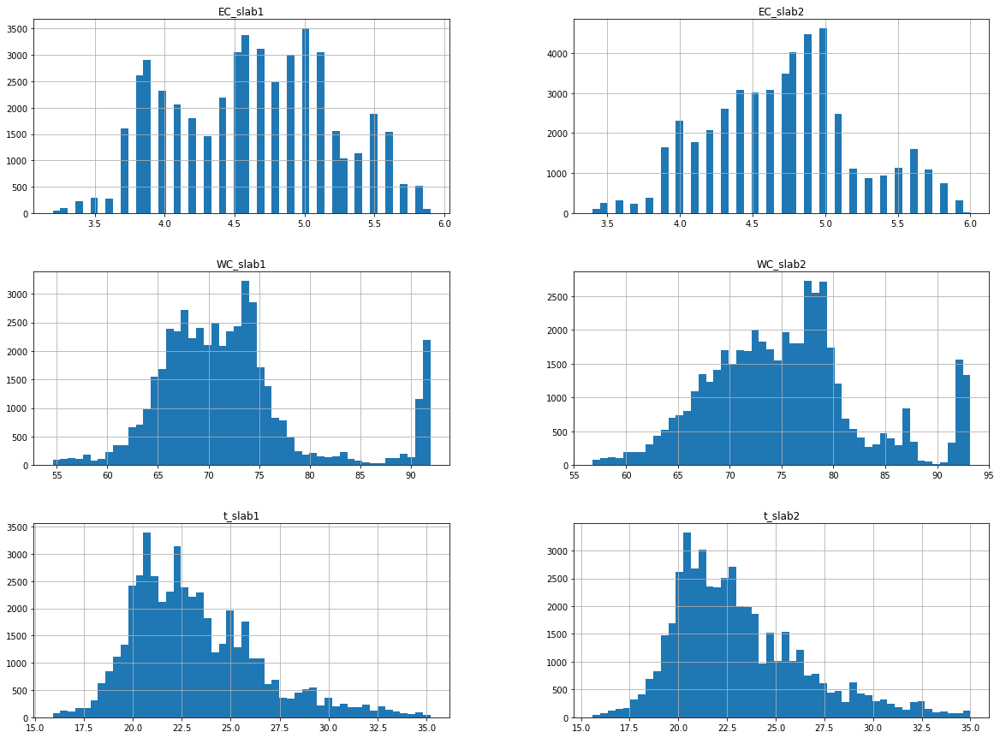

In [488]:
root_zone.hist(bins=50,figsize=(20,15),column=root_zone.columns)

In [489]:
root_zone.index.duplicated().sum()

0

In [490]:
green_house_climate.index.duplicated().sum()

0

In [491]:
green_house=pd.concat([weather,root_zone,green_house_climate],axis=1)

In [494]:
weather.columns.shape+green_house_climate.columns.shape+root_zone.columns.shape

(10, 49, 6)

In [495]:
green_house.shape

(47809, 65)

In [497]:
x=np.concatenate([weather.columns.tolist(),root_zone.columns.tolist(),green_house_climate.columns.tolist()])


In [499]:
pd.set_option('display.max_rows',43000)
print(green_house.isnull().sum().sum())

0


In [500]:
green_house=pd.DataFrame(green_house,columns=np.concatenate([weather.columns.tolist(),root_zone.columns.tolist(),green_house_climate.columns.tolist()]))

In [501]:
green_house.shape

(47809, 65)

In [ ]:
#one_day = 12 * 24
#for row in range(green_house.shape[0]):
#	for col in range(green_house.shape[1]):
#		if np.isnan(green_house.iloc[row][col]):
#			green_house.iloc[row][col] = green_house.iloc[row - one_day][col]

In [ ]:
#green_house.iloc[np.where(green_house['EC_slab1'].isnull())]['EC_slab1'] = green_house.iloc[np.where(green_house['EC_slab1'].isnull())]['EC_slab1']

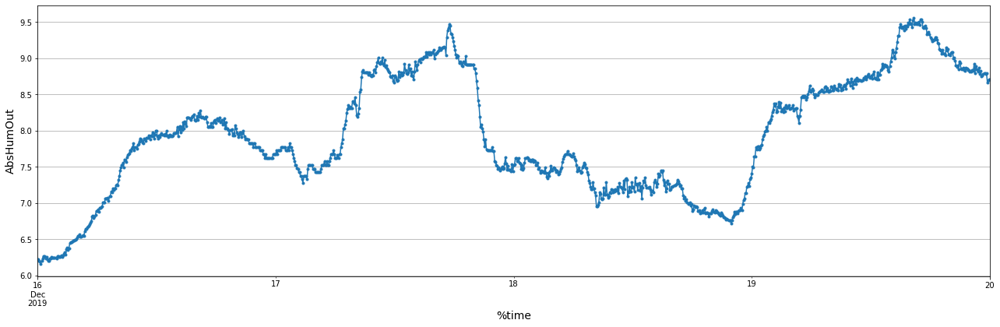

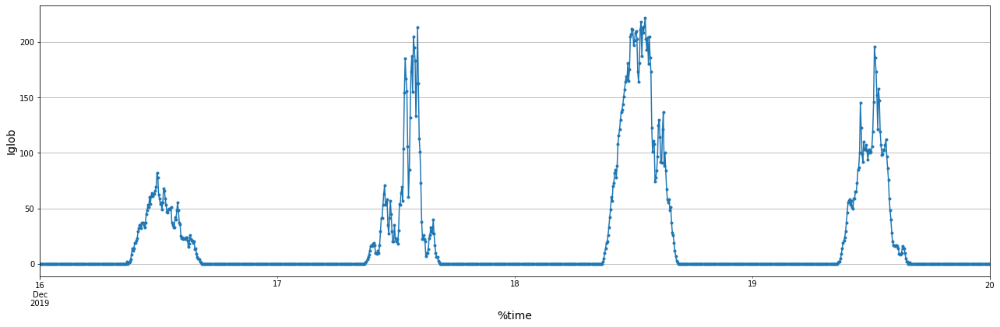

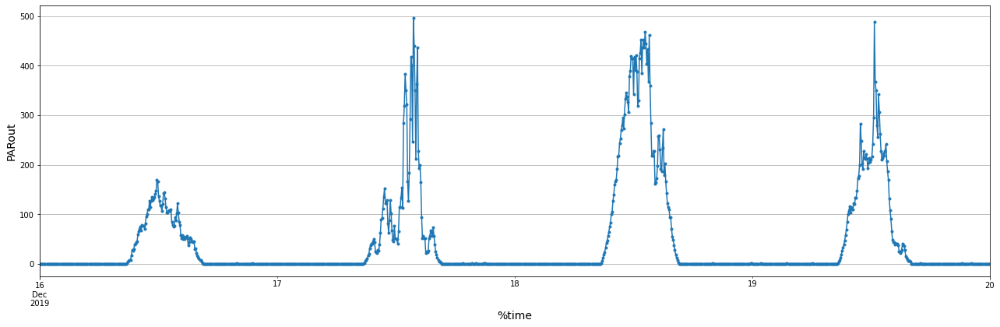

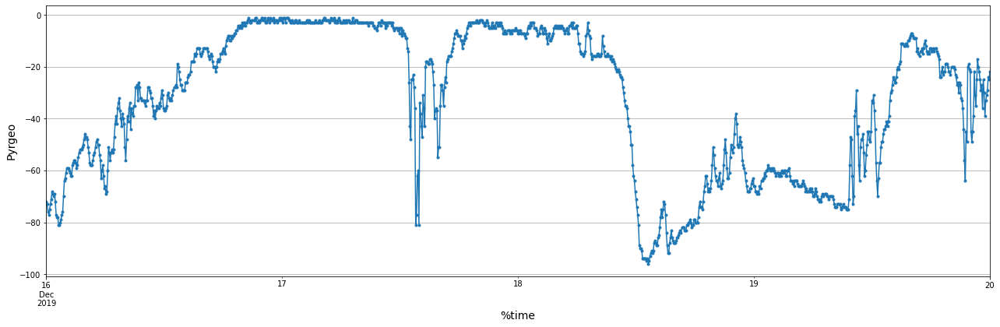

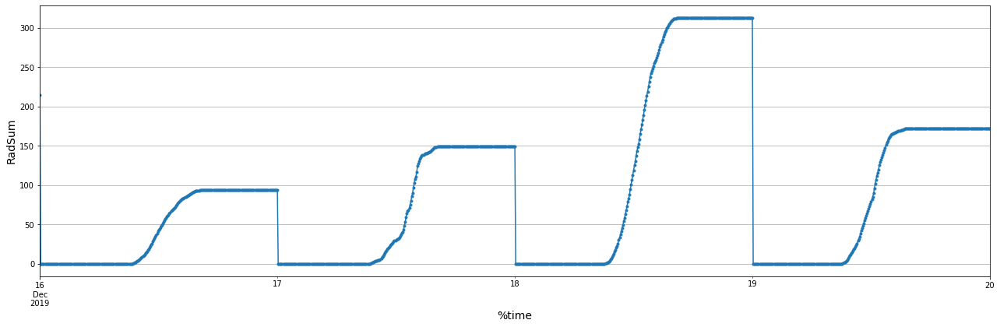

...

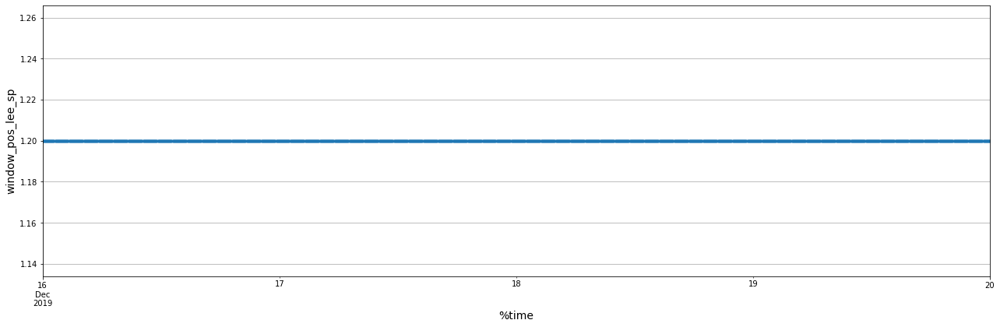

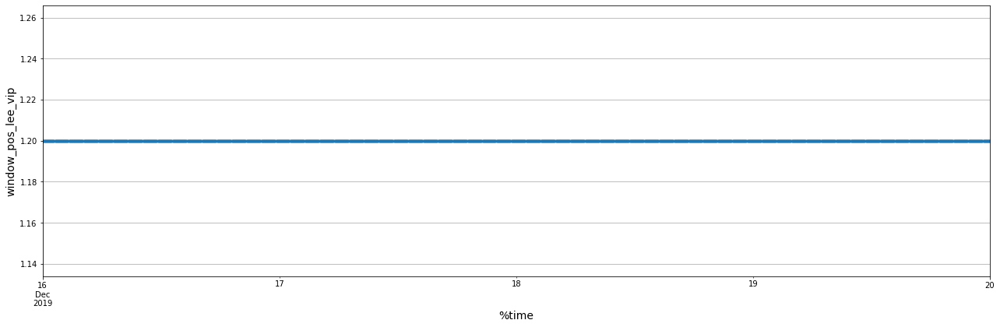

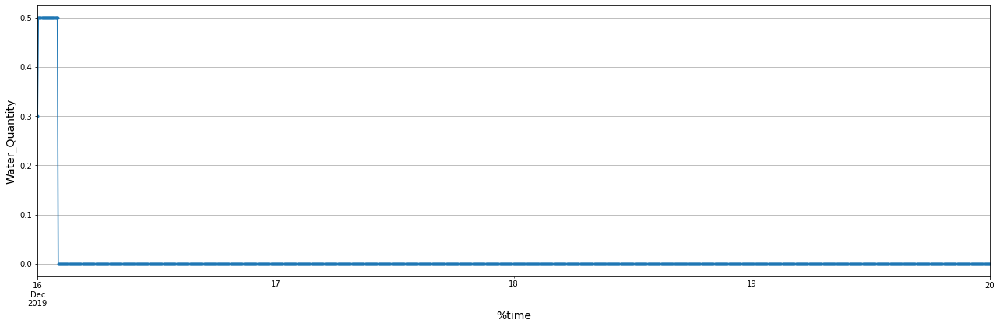

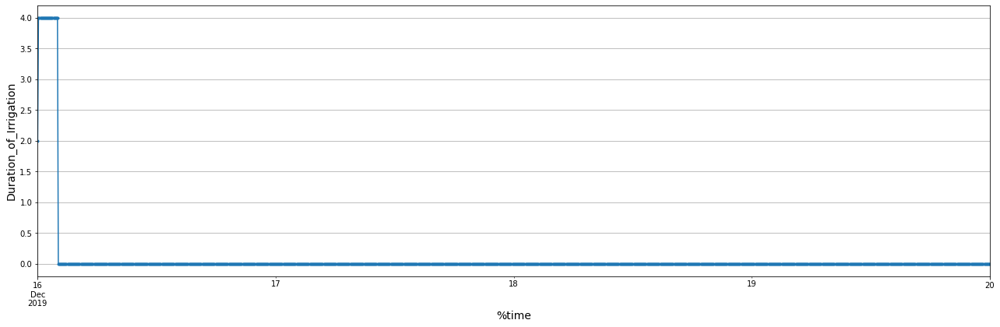

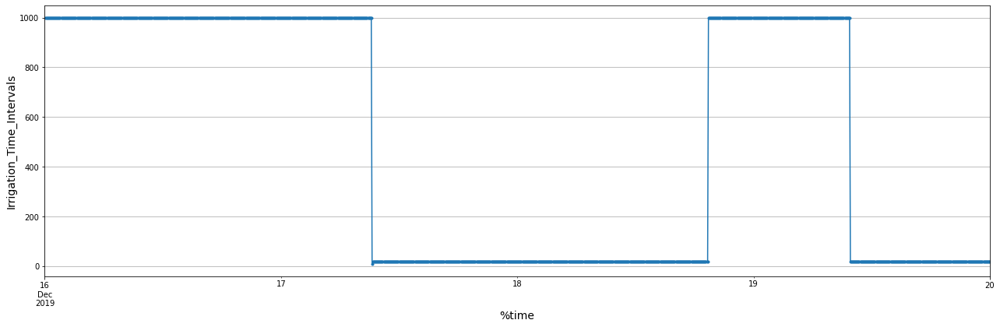

In [504]:
import matplotlib.pyplot as plt

for num_attribute in green_house.columns:
    
    green_house["2019-12-16 00:00:00" : "2019-12-25 00:00:00"][num_attribute].plot(ylabel=num_attribute,grid=True, marker=".", figsize=(18, 6))
    save_fig(f'green_house_{num_attribute}_time_series_plot')

    plt.show()

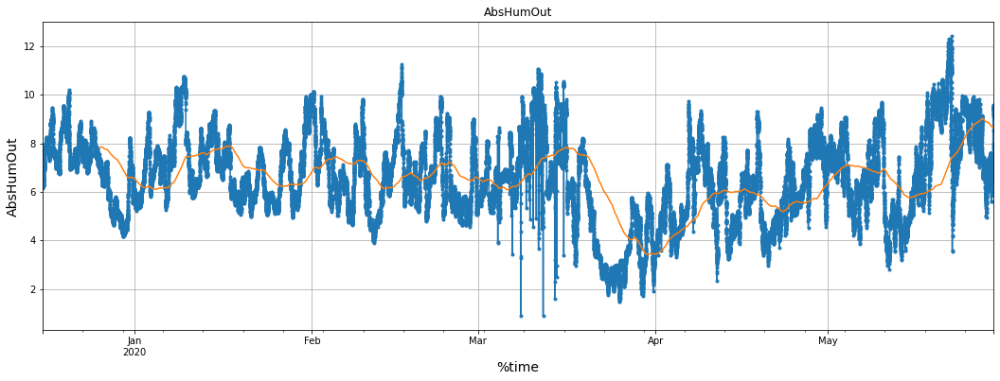

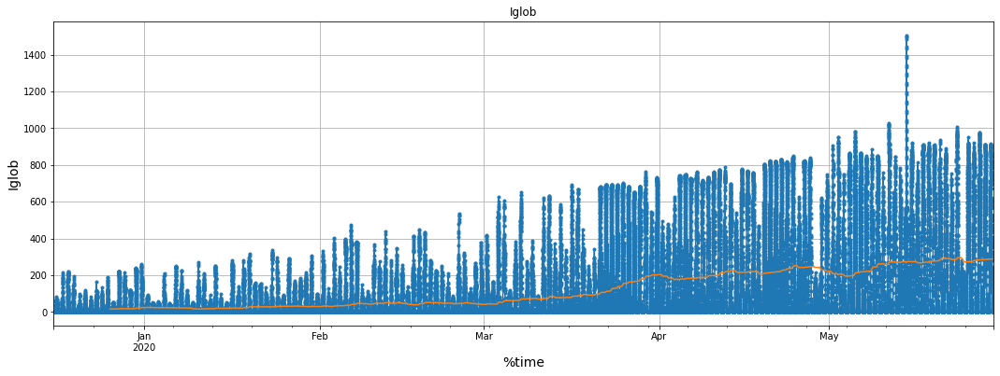

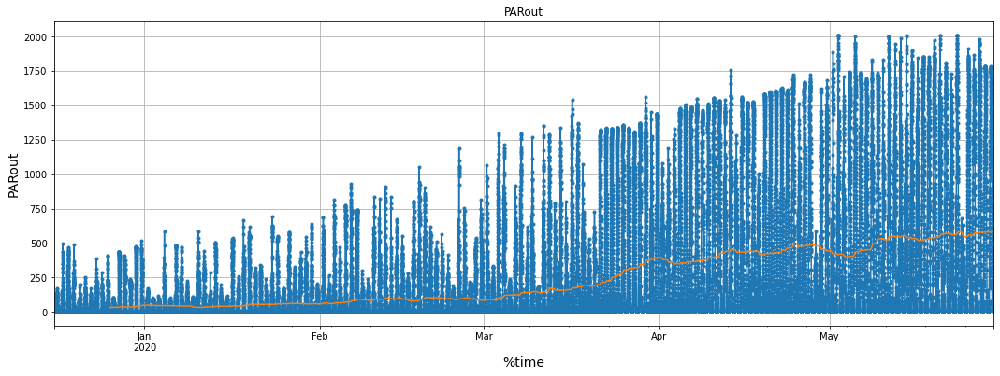

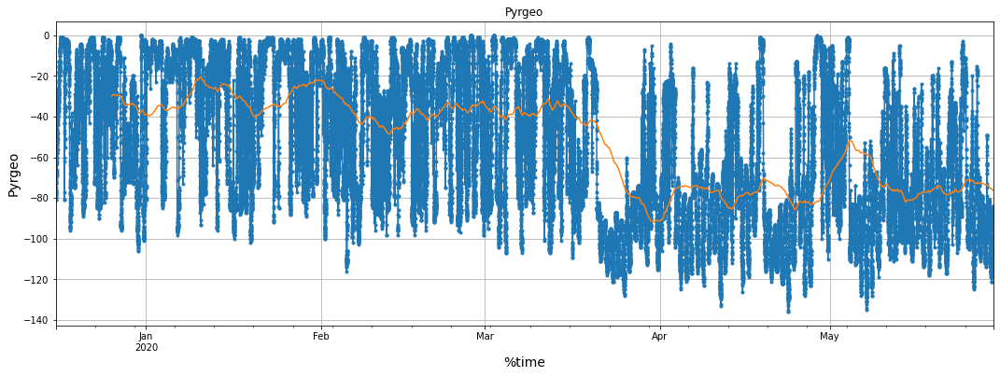

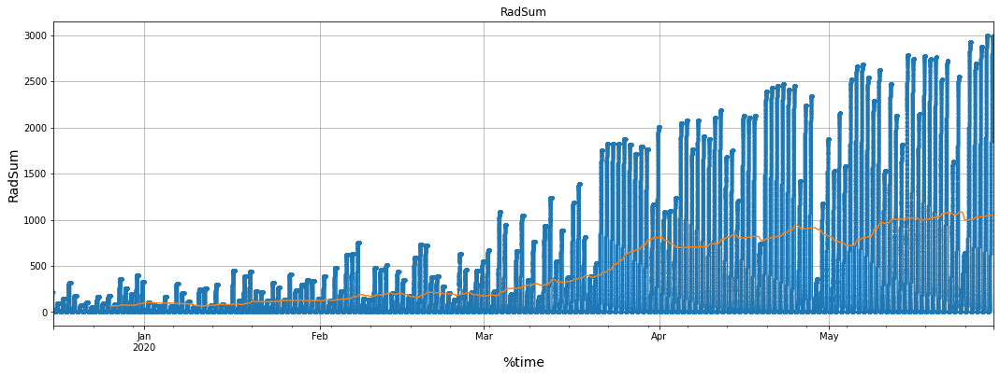

...

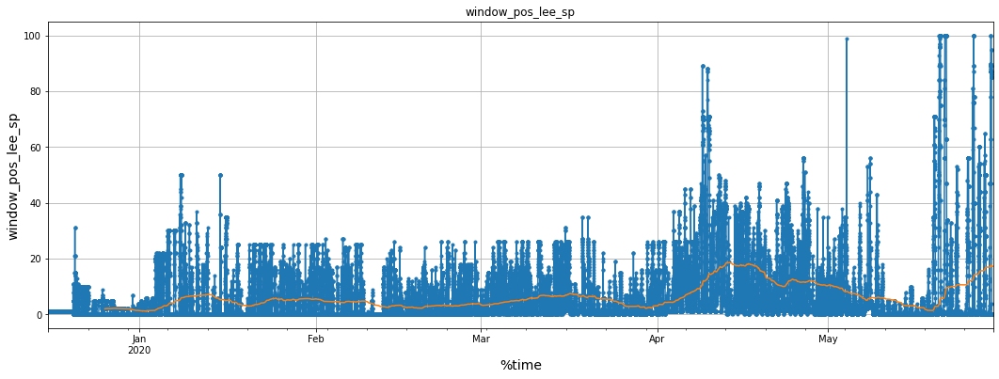

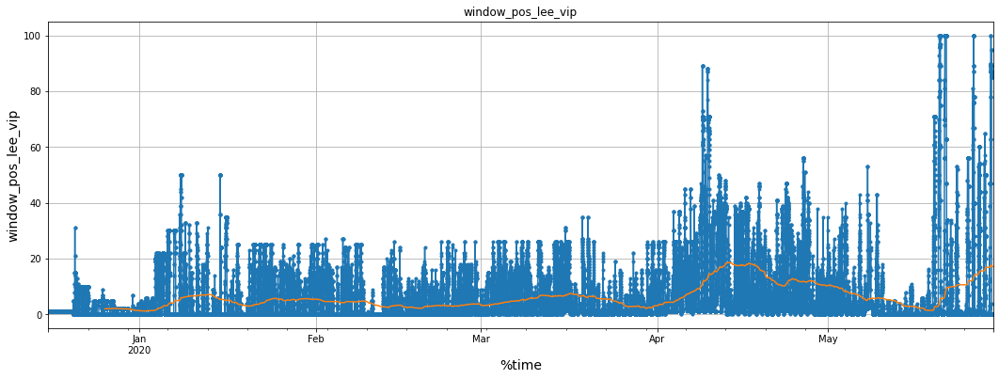

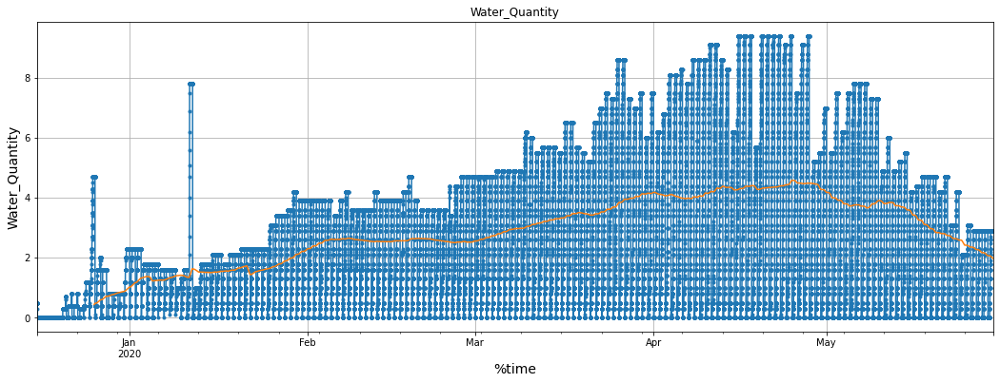

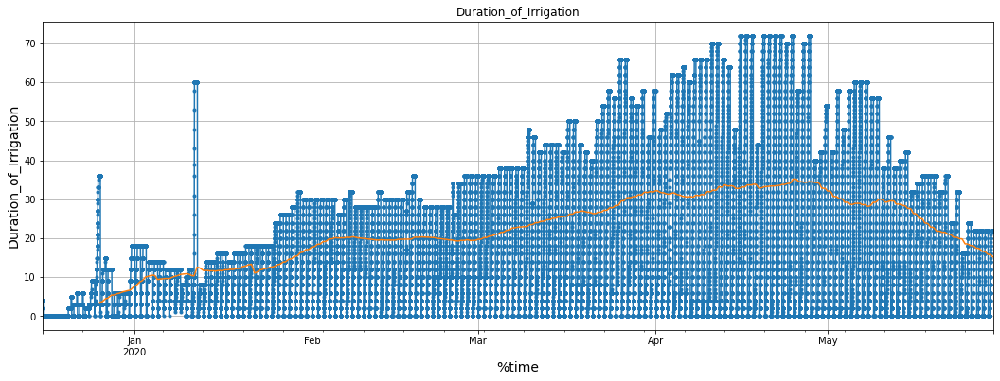

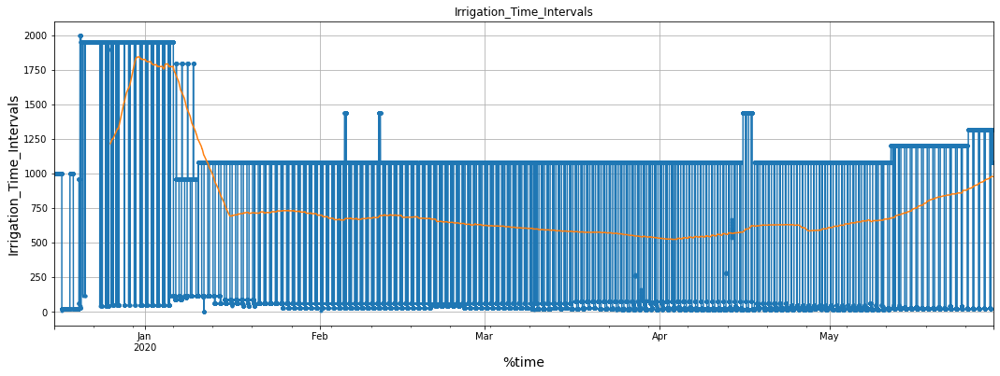

In [505]:

#find a trend 
#green_house['time']=green_house.index
##print(green_house['%time'].astype('string').str.split('.',expand=True).astype('int')[0])
#x=green_house['time'].astype('string').str.split('.',expand=True).astype('int')[0]
#green_house['time']=x
#print('green_house[time]',green_house.index)
#print('************')
for green_house_attribute in green_house.columns:
            fig = plt.figure(figsize=(10, 7))
            ax = fig.gca()
            
            dayly_avg=green_house[green_house_attribute].resample('H').mean()
            period=slice("2019-12-16 00:00:00", "2020-05-30 00:00:00")
            #print(green_house_attribute,green_house.groupby(by=['time'])[green_house_attribute].mean())
            green_house[green_house_attribute].plot(ax=ax,ylabel=green_house_attribute,xlabel='Day Index',grid='True', marker=".", figsize=(18, 6))
            
            rolling_average_dayly = dayly_avg[period].rolling(window=24*10).mean()
            #print(green_house_attribute,rolling_average_dayly)
            rolling_average_dayly.plot(grid=True)
            ax.set_xlabel(xlabel='%time')
            ax.set_ylabel(ylabel=green_house_attribute)
            ax.set_title(green_house_attribute)
            plt.show()



In [ ]:
green_house['%time']=green_house.index
green_house

,AbsHumOut,Iglob,PARout,Pyrgeo,RadSum,Rain,Rhout,Tout,Winddir,Windsp,...,t_vent_sp,t_ventlee_vip,t_ventwind_vip,water_sup_intervals_sp_min,window_pos_lee_sp,window_pos_lee_vip,Water_Quantity,Duration_of_Irrigation,Irrigation_Time_Intervals,%time
%time,,,,,,,,,,,,,,,,,,,,,
43815.00000,6.220954,0.0,0.000000e+00,-72.0,215.000000,0.0,80.6,6.9,32.0,4.7,...,25.0,25.0,26.0,1000.0,1.2,1.2,0.3,2.0,1000.0,43815.00000
43815.00347,6.220954,0.0,0.000000e+00,-73.0,0.000000,0.0,80.6,6.9,32.0,4.7,...,25.0,25.0,26.0,1000.0,1.2,1.2,0.5,4.0,1000.0,43815.00347
43815.00694,6.205565,0.0,0.000000e+00,-76.0,0.000000,0.0,80.4,6.9,32.0,4.7,...,25.0,25.0,26.0,1000.0,1.2,1.2,0.5,4.0,1000.0,43815.00694
43815.01042,6.190173,0.0,0.000000e+00,-77.0,0.000000,0.0,80.2,6.9,32.0,4.7,...,25.0,25.0,26.0,1000.0,1.2,1.2,0.5,4.0,1000.0,43815.01042
43815.01389,6.162624,0.0,0.000000e+00,-75.0,0.000000,0.0,80.9,6.7,32.0,4.7,...,25.0,25.0,26.0,1000.0,1.2,1.2,0.5,4.0,1000.0,43815.01389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43980.98611,9.286397,0.0,9.999999e-01,-85.0,2992.000000,0.0,71.4,15.1,2.0,4.3,...,18.0,18.0,18.0,1080.0,0.0,0.0,2.9,22.0,1080.0,43980.98611
43980.98958,9.242139,0.0,1.000000e+00,-85.0,2992.000000,0.0,71.5,15.0,2.0,4.3,...,18.0,18.0,18.0,1080.0,0.0,0.0,2.9,22.0,1080.0,43980.98958
43980.99306,9.152067,0.0,3.350000e-08,-84.0,2992.000000,0.0,70.8,15.0,2.0,3.8,...,18.0,18.0,18.0,1080.0,0.0,0.0,2.9,22.0,1080.0,43980.99306


In [ ]:
#green_house['%time']=green_house.index
#out=green_house['%time'].astype('string').str.split('.',expand=True).reset_index()
#out
#out['days']=np.zeros(shape=out[0].shape[0])
#out['hours']=np.zeros(shape=out[0].shape[0])
#out['minutes']=np.zeros(shape=out[0].shape[0])
#
#out.shape

(47809, 6)

In [ ]:
#out=np.load('C:\\Users\\user\\Desktop\\iman\\Master\\RoboticsAndControlSystems\\Project\\Documentation\\out.np.npy',allow_pickle=True)

In [ ]:
green_house['years'] =   green_house['%time'].dt.year
green_house['months'] =  green_house['%time'].dt.month
green_house['days'] =    green_house['%time'].dt.day
green_house['hours'] =   green_house['%time'].dt.hour
green_house['minutes'] = green_house['%time'].dt.minute
green_house.head()


In [ ]:
#out

,%time,0,1,days,hours,minutes
0,43815.00000,43815,0,0.0,0.0,0.0
1,43815.00347,43815,00347,0.0,0.0,0.0
2,43815.00694,43815,00694,0.0,0.0,0.0
3,43815.01042,43815,01042,0.0,0.0,0.0
4,43815.01389,43815,01389,0.0,0.0,0.0
...,...,...,...,...,...,...
47804,43980.98611,43980,98611,0.0,0.0,0.0
47805,43980.98958,43980,98958,0.0,0.0,0.0
47806,43980.99306,43980,99306,0.0,0.0,0.0
47807,43980.99653,43980,99653,0.0,0.0,0.0


In [ ]:
#day_count=1
#five_min_counts=1
#for i in (out.groupby(by=[0])[0].sum().index):
#    #print(i)
#    five_min_countsmin_counts=1
#    hours_count=1
#    for idx in out[0].index:     
#        if out[0].iloc[idx]==i:
#            out['days'].iloc[idx]=day_count
#            #print('done',idx)
#            out['hours'].iloc[idx]=hours_count
#            out['minutes'].iloc[idx]=five_min_counts*5
#            five_min_counts+=1
#            if five_min_counts>12:
#                hours_count+=1
#                five_min_counts=1
#    day_count+=1
#out

C:\Users\user\AppData\Local\Temp\ipykernel_21852\3556751650.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  out['days'].iloc[idx]=day_count
C:\Users\user\AppData\Local\Temp\ipykernel_21852\3556751650.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  out['hours'].iloc[idx]=hours_count
C:\Users\user\AppData\Local\Temp\ipykernel_21852\3556751650.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  out['minutes'].iloc[idx]=five_min_

,%time,0,1,days,hours,minutes
0,43815.00000,43815,0,1.0,1.0,5.0
1,43815.00347,43815,00347,1.0,1.0,10.0
2,43815.00694,43815,00694,1.0,1.0,15.0
3,43815.01042,43815,01042,1.0,1.0,20.0
4,43815.01389,43815,01389,1.0,1.0,25.0
...,...,...,...,...,...,...
47804,43980.98611,43980,98611,166.0,24.0,45.0
47805,43980.98958,43980,98958,166.0,24.0,50.0
47806,43980.99306,43980,99306,166.0,24.0,55.0
47807,43980.99653,43980,99653,166.0,24.0,60.0


In [ ]:
#day_count=1
#min_counts=1
#for i in (out.groupby(by=[0])[0].sum().index):
#    #print(i)
#    min_counts=1
#    hours_count=1
#    for idx in out[0].index:     
#        if out[0].iloc[idx]==i:
#            out['days'].iloc[idx]=day_count
#            #print('done',idx)
#            out['hours'].iloc[idx]=hours_count
#            min_counts+=1
#            if min_counts>12:
#                hours_count+=1
#                min_counts=1
#    day_count+=1
#out

C:\Users\user\AppData\Local\Temp\ipykernel_21852\1239131114.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  out['days'].iloc[idx]=day_count
C:\Users\user\AppData\Local\Temp\ipykernel_21852\1239131114.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  out['hours'].iloc[idx]=hours_count


,%time,0,1,days,hours,minutes
0,43815.00000,43815,0,1.0,1.0,0.0
1,43815.00347,43815,00347,1.0,1.0,0.0
2,43815.00694,43815,00694,1.0,1.0,0.0
3,43815.01042,43815,01042,1.0,1.0,0.0
4,43815.01389,43815,01389,1.0,1.0,0.0
...,...,...,...,...,...,...
47804,43980.98611,43980,98611,166.0,24.0,0.0
47805,43980.98958,43980,98958,166.0,24.0,0.0
47806,43980.99306,43980,99306,166.0,24.0,0.0
47807,43980.99653,43980,99653,166.0,24.0,0.0


In [ ]:
print(green_house['days'].value_counts())

1.0      288
106.0    288
108.0    288
109.0    288
110.0    288
111.0    288
112.0    288
113.0    288
114.0    288
115.0    288
116.0    288
117.0    288
118.0    288
119.0    288
120.0    288
121.0    288
122.0    288
123.0    288
124.0    288
107.0    288
105.0    288
126.0    288
104.0    288
87.0     288
88.0     288
89.0     288
90.0     288
91.0     288
92.0     288
93.0     288
94.0     288
95.0     288
96.0     288
97.0     288
98.0     288
99.0     288
100.0    288
101.0    288
102.0    288
103.0    288
125.0    288
127.0    288
85.0     288
148.0    288
150.0    288
151.0    288
152.0    288
153.0    288
154.0    288
155.0    288
156.0    288
157.0    288
158.0    288
159.0    288
160.0    288
161.0    288
162.0    288
163.0    288
164.0    288
165.0    288
166.0    288
149.0    288
147.0    288
128.0    288
146.0    288
129.0    288
130.0    288
131.0    288
132.0    288
133.0    288
134.0    288
135.0    288
136.0    288
137.0    288
138.0    288
139.0    288
140.0    288

In [ ]:
print(green_house['minutes'].value_counts())

5.0     3985
10.0    3984
15.0    3984
20.0    3984
25.0    3984
30.0    3984
35.0    3984
40.0    3984
45.0    3984
50.0    3984
55.0    3984
60.0    3984
Name: minutes, dtype: int64


In [ ]:
print(green_house['hours'].value_counts())

1.0     1993
2.0     1992
23.0    1992
22.0    1992
21.0    1992
20.0    1992
19.0    1992
18.0    1992
17.0    1992
16.0    1992
15.0    1992
14.0    1992
13.0    1992
12.0    1992
11.0    1992
10.0    1992
9.0     1992
8.0     1992
7.0     1992
6.0     1992
5.0     1992
4.0     1992
3.0     1992
24.0    1992
Name: hours, dtype: int64


In [ ]:
green_house['days'].values
green_house['hours'].values
green_house['minutes'].values

#green_house.drop('%time',inplace=True)
#green_house['hours']

In [ ]:
#green_house.drop(columns=['minutes'],inplace=True)

In [ ]:
#green_house.isnull().sum()


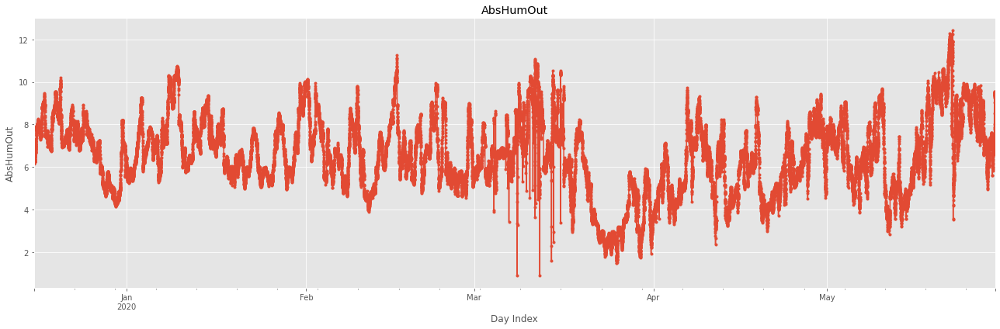

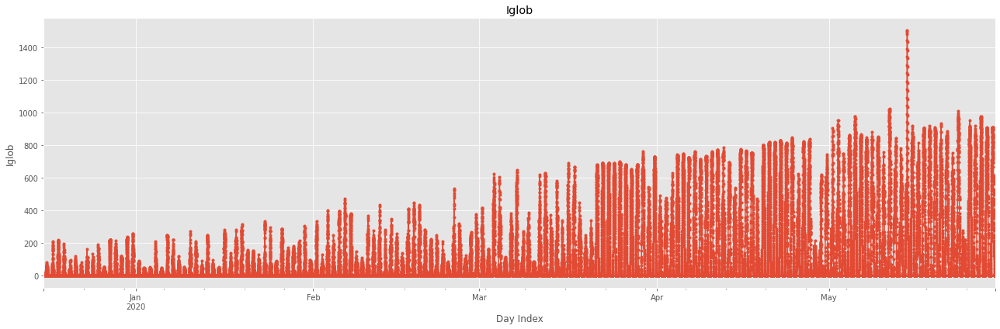

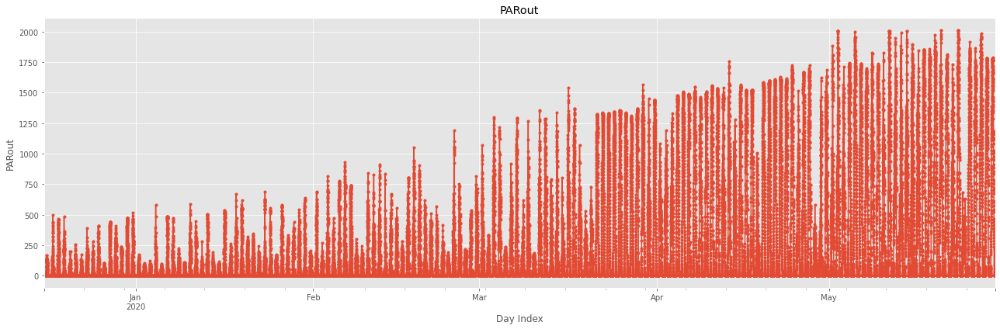

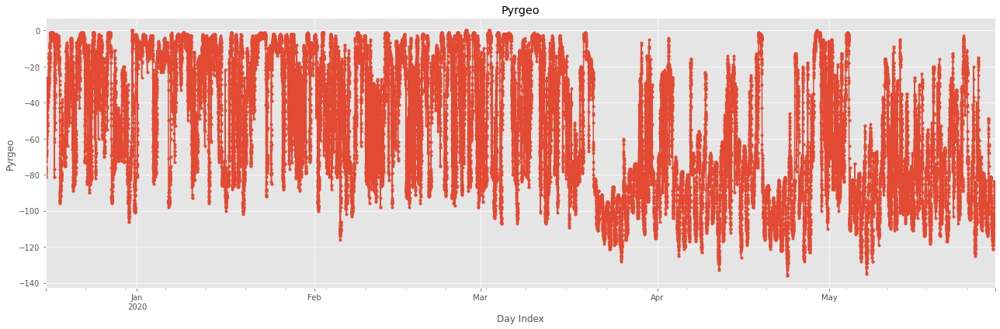

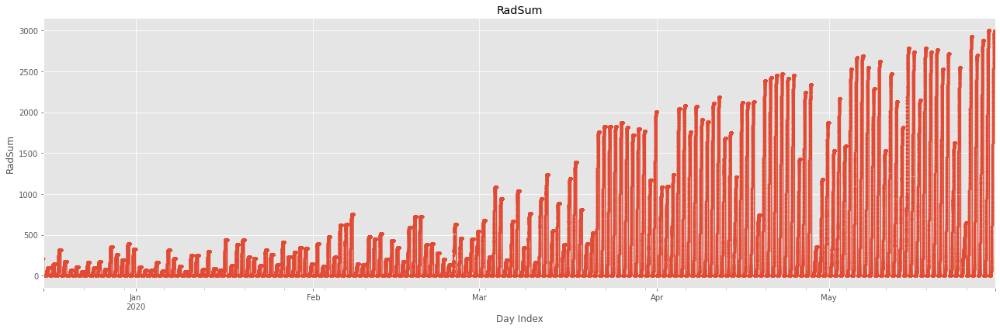

...

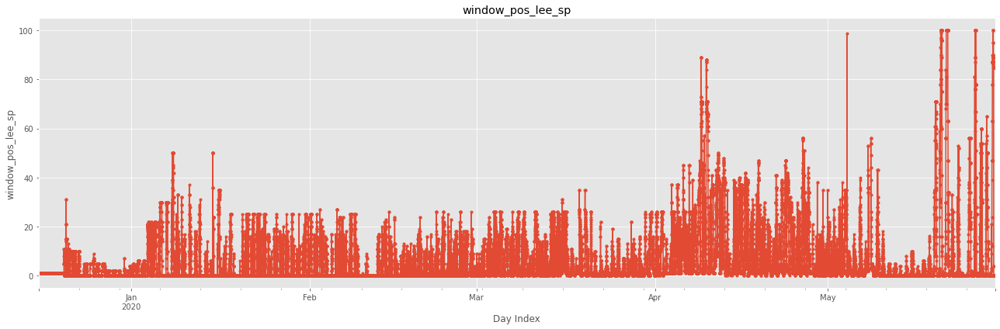

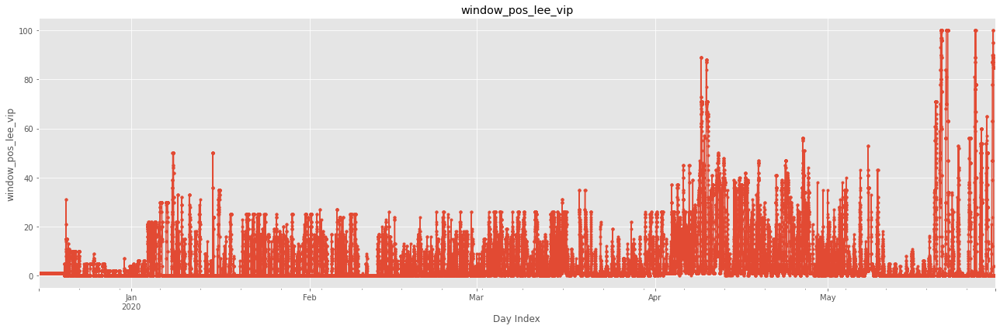

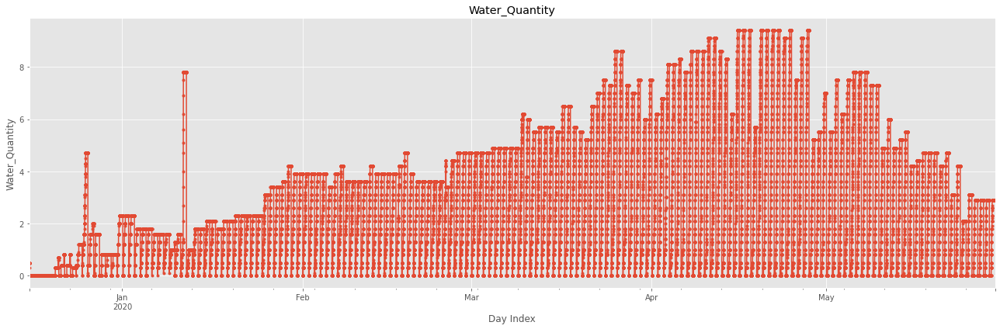

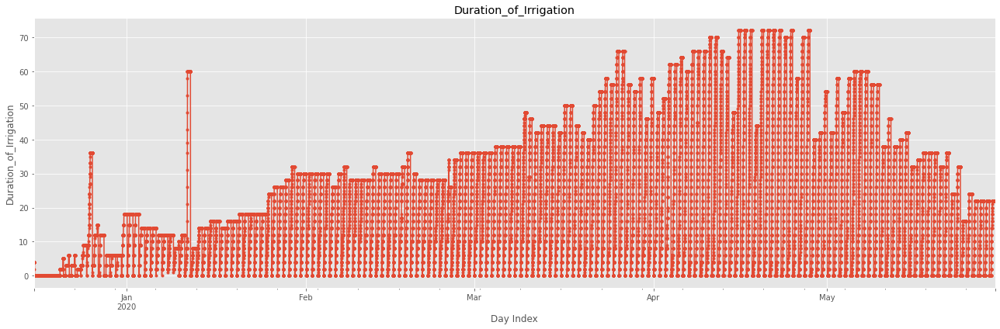

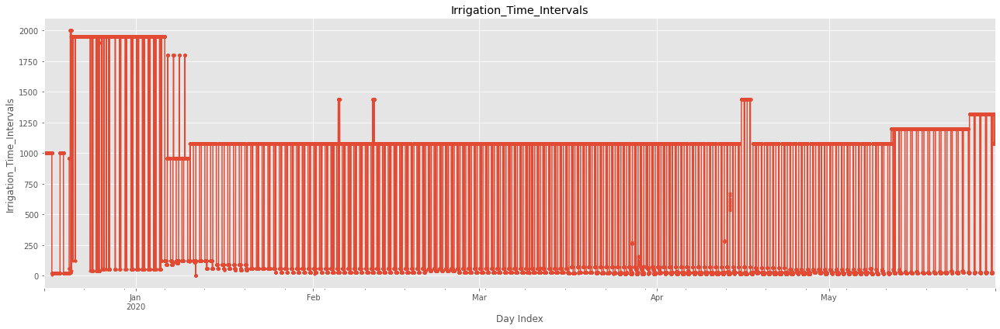

In [634]:
import matplotlib.pyplot as plt

for num_attribute in green_house.columns:
    
    green_house["2019-12-16 00:00:00" : "2020-12-26 00:00:00"][num_attribute].plot(ylabel=num_attribute,xlabel='Day Index',grid=True, marker=".", figsize=(18, 6),title=num_attribute)
    
    save_fig(f'green_house_{num_attribute}_time_series_plot')

    plt.show()

In [506]:
green_house[green_house.columns].corr()['Irrigation_Time_Intervals'].sort_values(ascending=False)


Irrigation_Time_Intervals     1.000000
water_sup_intervals_sp_min    0.978505
EnScr                         0.568098
scr_enrg_vip                  0.567434
scr_enrg_sp                   0.566927
pH_drain_PC                   0.199067
Rhout                         0.184114
WC_slab1                      0.165548
WC_slab2                      0.124695
RadSum                        0.111345
Pyrgeo                        0.110092
EC_slab1                      0.109129
EC_slab2                      0.094973
PipeLow                       0.092528
AbsHumOut                     0.089732
t_rail_min_sp                 0.073426
t_rail_min_vip                0.072366
t_slab1                       0.044630
t_slab2                       0.039909
Water_Quantity                0.029026
Duration_of_Irrigation        0.028615
Winddir                       0.027596
BlackScr                      0.025090
t_ventwind_vip                0.023462
scr_blck_sp                   0.023029
t_ventlee_vip            

In [508]:
green_house[green_house.columns].corr()['BlackScr'	]


AbsHumOut                     0.013020
Iglob                        -0.403111
PARout                       -0.402461
Pyrgeo                        0.172403
RadSum                       -0.321993
Rain                          0.009092
Rhout                         0.274764
Tout                         -0.301215
Winddir                       0.027035
Windsp                       -0.138985
EC_slab1                     -0.012528
EC_slab2                      0.009222
WC_slab1                     -0.171289
WC_slab2                     -0.221198
t_slab1                      -0.298892
t_slab2                      -0.292434
AssimLight                    0.350402
BlackScr                      1.000000
CO2air                        0.070383
EC_drain_PC                  -0.021355
EnScr                        -0.072085
HumDef                       -0.314632
PipeGrow                      0.240634
PipeLow                       0.093006
Rhair                         0.308684
Tair                     

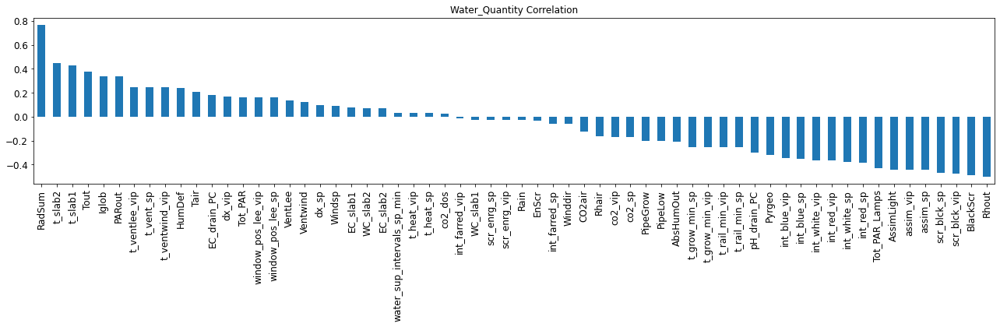

In [509]:
corr0=green_house[green_house.columns].corr()['Water_Quantity'].sort_values(ascending=False)
corr0.drop(['Irrigation_Time_Intervals','Water_Quantity','Duration_of_Irrigation'],axis=0,inplace=True)
corr0.plot(kind='bar',title='Water_Quantity Correlation',figsize=(18, 6),fontsize=12)
save_fig('Water_Quantity Correlation with features')


In [510]:
corr1=green_house[green_house.columns].corr()['Irrigation_Time_Intervals'].sort_values(ascending=False)
corr1.drop(['Irrigation_Time_Intervals','Water_Quantity','Duration_of_Irrigation'],axis=0,inplace=True)

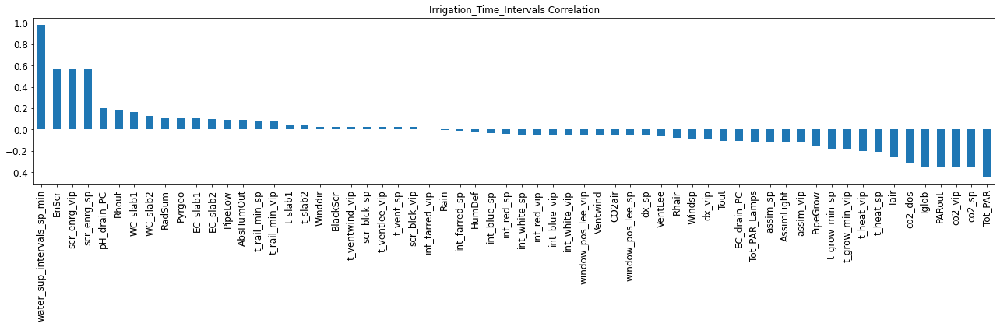

In [511]:
corr1.plot(kind='bar',title='Irrigation_Time_Intervals Correlation',figsize=(18, 6),fontsize=12)
save_fig('Irrigation_Time_Intervals Correlation with features')


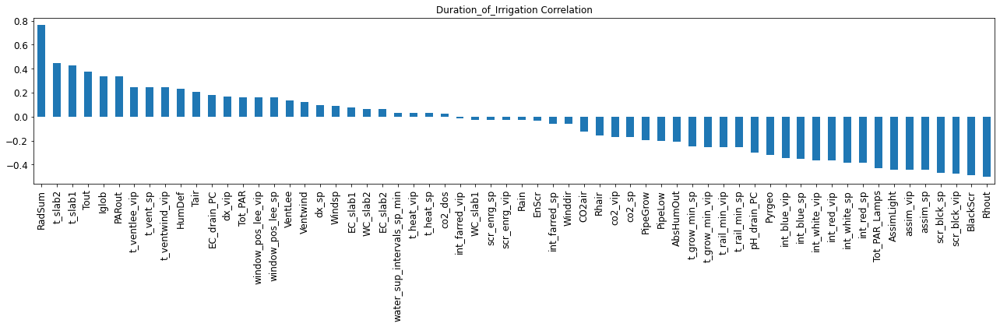

In [512]:
corr2=green_house[green_house.columns].corr()['Duration_of_Irrigation'].sort_values(ascending=False)
corr2.drop(['Irrigation_Time_Intervals','Water_Quantity','Duration_of_Irrigation'],axis=0,inplace=True)
corr2.plot(kind='bar',title='Duration_of_Irrigation Correlation',figsize=(18, 6),fontsize=12)
save_fig(f'Duration_of_Irrigation Correlation with features')


In [513]:
correlation_values=pd.concat([corr0,corr1,corr2],axis=1)

In [514]:
correlation_values
headers = {
    "selector": "th:not(.index_name)",
    "props": "background-color: #800000; color: white; text-align: center"
}
properties = {"border": "1px solid black", "width": "65px", "text-align": "center"}
cell_hover = {
    "selector": "td:hover",
    "props": [("background-color", "#FFFFE0")]
}
index_names = {
    "selector": ".index_name",
    "props": "font-style: italic; color: darkgrey; font-weight:normal;"
}
correlation_values.style.format(precision=2).set_table_styles([cell_hover, index_names, headers]).set_properties(**properties)
correlation_values.style.highlight_max(color="red",axis=0)
correlation_values.style.highlight_min(color="red",axis=0)

def mean_highlighter(x):
    style_lt = "background-color: whight"
    style_gt = "background-color: red"
    gt_mean = abs(x) > .4
    return [style_gt if i else style_lt for i in gt_mean]
    
    
correlation_values.style.apply(mean_highlighter)

,Water_Quantity,Irrigation_Time_Intervals,Duration_of_Irrigation
RadSum,0.763842,0.111345,0.762715
t_slab2,0.445490,0.039909,0.444861
t_slab1,0.428206,0.044630,0.427617
Tout,0.374580,-0.105133,0.373516
Iglob,0.336330,-0.345189,0.336032
PARout,0.336271,-0.347179,0.336011
t_ventlee_vip,0.246939,0.022706,0.246661
t_vent_sp,0.246422,0.022291,0.246145
t_ventwind_vip,0.246049,0.023462,0.245773
HumDef,0.237092,-0.029654,0.235702


In [635]:
np.save('green_house.npy',green_house)
#print(out['hours'].value_counts())
#print(out['days'].value_counts())
#out=np.load('out.npy')
green_house.to_csv('C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\greenhouse_fill_missing_values.csv')
weather.to_csv('C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\weather_fill_missing_values.csv')
green_house_climate.to_csv('C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\greenhouse_climate_fill_missing_values.csv')
root_zone.to_csv('C:\\Users\\user\\Desktop\\iman\\AGHC\\AutonomousGreenHouseChallenge\\Code\\Training\\root_zone_fill_missing_values.csv')


In [516]:
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import LinearSVR 
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score,cross_val_predict
import numpy as np
from sklearn.compose import ColumnTransformer,make_column_selector
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler,OneHotEncoder
from sklearn.ensemble import GradientBoostingRegressor,AdaBoostRegressor
from sklearn.linear_model import Lasso,Ridge,ElasticNet
from sklearn.preprocessing import FunctionTransformer


In [517]:
index=green_house[green_house['Irrigation_Time_Intervals'].isnull()==True].index
green_house.drop(index=index,inplace=True)

In [518]:
y=pd.DataFrame(green_house.loc[:,['Water_Quantity','Duration_of_Irrigation','Irrigation_Time_Intervals']])

X=green_house.drop(['Water_Quantity','Duration_of_Irrigation','Irrigation_Time_Intervals'],axis=1).copy()
print(y.shape)
print(X.shape)


(47809, 3)
(47809, 62)


In [519]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10, random_state=0,shuffle=True,
                                                    stratify=green_house['Rain'])


#from sklearn.preprocessing import MinMaxScaler
#min_max_scaler=MinMaxScaler()
#print(X_train.shape)
#y_train=min_max_scaler.fit_transform(y_train)
#y_test=min_max_scaler.transform(y_test)
#print('y_train',y_train.shape)
#print('y_test',y_test.shape)
#

In [520]:
y_train.mean(axis=0)
y_train.std(axis=0)

#11.551732063293457,
# 2.028500556945801,
# 211.20957946777344

Water_Quantity                 2.532005
Duration_of_Irrigation        19.477393
Irrigation_Time_Intervals    626.486435
dtype: float64

In [521]:
# check scikit-learn version
import sklearn
print(sklearn.__version__)

1.1.1


In [522]:
#from sklearn.metrics import mean_squared_error,r2_score
#from sklearn.model_selection import cross_val_score,cross_val_predict,cross_validate
#Water_Quantity_train_results=[] 
#Irrigation_Time_Intervals_train_results=[]
#Duration_of_Irrigation_train_results=[]
#Water_Quantity_test_results=[] 
#Irrigation_Time_Intervals_test_results=[]
#Duration_of_Irrigation_test_results=[]
#train_rmse=dict()
#train_r2=dict()
#train_mse=dict()
#test_rmse=dict()
#test_r2=dict()
#test_mse=dict()
#confidence_intervals=[]
#for key in models.keys():
#    full_pipeline = Pipeline([
#        ('preprocessing', preprocessing),
#        ('models',models[key]),
#    ])
#    #train
#    score=cross_validate(full_pipeline, X_train, y_train,scoring='neg_root_mean_squared_error', cv=10)
#    #print(score)
#    #train_rmse=-score['test_score'].mean()/y.mean()
#    #print(train_rmse)
#    train_prediction=cross_val_predict(full_pipeline,X_train,y_train,cv=10)
#    test_prediction=cross_val_predict(full_pipeline,X_test,y_test,cv=10)
#
#    for i,out in zip(range(0,len(y.columns),1),y.columns):
#        #train scores
#        train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[:,i],squared=False)#/y[out].mean()
#        train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[:,i])#/y[out].mean()
#        train_r2[out]=r2_score(y_true=y_train[:,i],y_pred=train_prediction[:,i])
#
#        #test scores
#        test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[:,i],squared=False)#/y[out].mean()
#        test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[:,i])#/y[out].mean()
#        test_r2[out]=r2_score(y_true=y_test[:,i],y_pred=test_prediction[:,i])
#
#    #train result for each output
#    Water_Quantity_train_results.append((key,train_rmse['Water_Quantity'],train_mse['Water_Quantity'],train_r2['Water_Quantity']))
#    Duration_of_Irrigation_train_results.append((key,train_rmse['Duration_of_Irrigation'],train_mse['Duration_of_Irrigation'],train_r2['Duration_of_Irrigation']))
#    Irrigation_Time_Intervals_train_results.append((key,train_rmse['Irrigation_Time_Intervals'],train_mse['Irrigation_Time_Intervals'],train_r2['Irrigation_Time_Intervals']))
#    #test result for each output
#    Water_Quantity_test_results.append((key,test_rmse['Water_Quantity'],test_mse['Water_Quantity'],test_r2['Water_Quantity']))
#    Duration_of_Irrigation_test_results.append((key,test_rmse['Duration_of_Irrigation'],test_mse['Duration_of_Irrigation'],test_r2['Duration_of_Irrigation']))
#    Irrigation_Time_Intervals_test_results.append((key,test_rmse['Irrigation_Time_Intervals'],test_mse['Irrigation_Time_Intervals'],test_r2['Irrigation_Time_Intervals']))
#   
#print(Water_Quantity_train_results,'\n',Duration_of_Irrigation_train_results,'\n',Irrigation_Time_Intervals_train_results,'\n')
#print(Water_Quantity_test_results,'\n',Duration_of_Irrigation_test_results,'\n',Irrigation_Time_Intervals_test_results,'\n')

In [523]:
##show training results table:
#print(Water_Quantity_train_results,Duration_of_Irrigation_train_results,Irrigation_Time_Intervals_train_results)
#
#print('models train Water_Quantity scores:',Water_Quantity_train_results)
#best_Water_Quantity_trained_model_idx=np.array(Water_Quantity_train_results)[:,1].argmin()
#
#print('models train Duration_of_Irrigation scores:',Duration_of_Irrigation_train_results)
#best_Duration_of_Irrigation_trained_model_idx=np.array(Duration_of_Irrigation_train_results)[:,1].argmin()
#
#print('models train Water_interv scores:',Irrigation_Time_Intervals_train_results)
#best_Irrigation_Time_Intervals_trained_model_idx=np.array(Irrigation_Time_Intervals_train_results)[:,1].argmin()
#
##print('models test scores:',test_results)
##best_tested_model_idx=np.array(test_results)[:,1].argmax()
#
#
#print('best trained model:',Water_Quantity_train_results[best_Water_Quantity_trained_model_idx][0],Water_Quantity_train_results[best_Water_Quantity_trained_model_idx][1],'\n',
#                            Duration_of_Irrigation_train_results[best_Duration_of_Irrigation_trained_model_idx][0],Duration_of_Irrigation_train_results[best_Duration_of_Irrigation_trained_model_idx][1],'\n',
#                            Irrigation_Time_Intervals_train_results[best_Irrigation_Time_Intervals_trained_model_idx][0],Irrigation_Time_Intervals_train_results[best_Irrigation_Time_Intervals_trained_model_idx][1],'\n',
#)
#
##print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
#Water_Quantity_train_result=pd.DataFrame(Water_Quantity_train_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#Duration_of_Irrigation_train_result=pd.DataFrame(Duration_of_Irrigation_train_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#Irrigation_Time_Intervals_train_result=pd.DataFrame(Irrigation_Time_Intervals_train_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
##import dataframe_image as dfi
#
##dfi.export(train_result, "ModelsTrainingResultsTable.png")
#Water_Quantity_train_result
#

In [524]:
#Duration_of_Irrigation_train_result 

In [525]:
#Irrigation_Time_Intervals_train_result

In [526]:
#print(train_prediction,y_train)

In [527]:
##show testing results table:
#print(Water_Quantity_test_results,Duration_of_Irrigation_test_results,Irrigation_Time_Intervals_test_results)
#
#print('models test Water_Quantity scores:',Water_Quantity_test_results)
#best_Water_Quantity_test_model_idx=np.array(Water_Quantity_test_results)[:,1].argmin()
#
#print('models test Duration_of_Irrigation scores:',Duration_of_Irrigation_test_results)
#best_Duration_of_Irrigation_test_model_idx=np.array(Duration_of_Irrigation_test_results)[:,1].argmin()
#
#print('models test Water_interv scores:',Irrigation_Time_Intervals_test_results)
#best_Irrigation_Time_Intervals_test_model_idx=np.array(Irrigation_Time_Intervals_test_results)[:,1].argmin()
#
##print('models test scores:',test_results)
##best_tested_model_idx=np.array(test_results)[:,1].argmax()
#
#
#print('best tested model:',Water_Quantity_test_results[best_Water_Quantity_test_model_idx][0],Water_Quantity_test_results[best_Water_Quantity_test_model_idx][1],'\n',
#                            Duration_of_Irrigation_test_results[best_Duration_of_Irrigation_test_model_idx][0],Duration_of_Irrigation_test_results[best_Duration_of_Irrigation_test_model_idx][1],'\n',
#                            Irrigation_Time_Intervals_test_results[best_Irrigation_Time_Intervals_test_model_idx][0],Irrigation_Time_Intervals_test_results[best_Irrigation_Time_Intervals_test_model_idx][1],'\n',
#)
#
#Water_Quantity_test_result=pd.DataFrame(Water_Quantity_test_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#Duration_of_Irrigation_test_result=pd.DataFrame(Duration_of_Irrigation_test_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#Irrigation_Time_Intervals_test_result=pd.DataFrame(Irrigation_Time_Intervals_test_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
##import dataframe_image as dfi
#
##dfi.export(test_result, "ModelstestingResultsTable.png")
#Water_Quantity_test_result
#

In [528]:
#Duration_of_Irrigation_test_result

In [529]:
#Irrigation_Time_Intervals_test_result

In [530]:
#from sklearn.multioutput import MultiOutputRegressor
#
#models={'LinearRegression':LinearRegression(),
#    #'GradientBoostingRegressor':GradientBoostingRegressor(random_state=42),
#    #'AdaBoostRegressor':AdaBoostRegressor(random_state=42),
#    #'Lasso':Lasso(random_state=42),
#    #'Ridge':Ridge(random_state=42),
#    #'ElasticNet':ElasticNet(random_state=42),
#    'KNeighborsRegressor':KNeighborsRegressor(),
#    'DecisionTreeRegressor':DecisionTreeRegressor(random_state=42),
#    'RandomForestRegressor':RandomForestRegressor(random_state=42),
#    #'LinearSVR':LinearSVR(max_iter=50000,random_state=42),
#    #'SVR':  SVR(max_iter=50000)
#    }
#
#num_attributes=['pH_drain_PC' ,'WC_slab1','Rhout' ,                        
#'WC_slab2','RadSum','Pyrgeo','EC_slab1','AbsHumOut','EC_slab2','t_slab1',                       
#'t_slab2','Winddir','HumDef','CO2air','Rhair',                         
#'Tout','EC_drain_PC','Tair','Windsp','co2_dos','Iglob','PARout','Tot_PAR', 'days','hours' ] 
#
#
#cat_attributes=['Rain']
#outputs=['Water_Quantity' , 'Duration_of_Irrigation' , 'Irrigation_Time_Intervals']
#
#num_pipline=make_pipeline(SimpleImputer(strategy='mean'),StandardScaler())
#cat_pipeline=make_pipeline(SimpleImputer(strategy='most_frequent'),OneHotEncoder())
#
##date_pipeline=make_pipeline(FunctionTransformer(lambda x:pd.DatetimeIndex(x).day))
#preprocessing=ColumnTransformer([('num', num_pipline, num_attributes),
#                                ('cat',cat_pipeline,cat_attributes),
#                                #('day',date_pipeline,['dteday'])
#                                ])
#
##data_prepared=preprocessing.fit_transform()
##data_prepared.shape
#
#from sklearn.metrics import mean_squared_error,r2_score
#from sklearn.model_selection import cross_val_score,cross_val_predict,cross_validate
#Water_Quantity_train_results=[] 
#Irrigation_Time_Intervals_train_results=[]
#Duration_of_Irrigation_train_results=[]
#Water_Quantity_test_results=[] 
#Irrigation_Time_Intervals_test_results=[]
#Duration_of_Irrigation_test_results=[]
#train_rmse=dict()
#train_r2=dict()
#train_mse=dict()
#test_rmse=dict()
#test_r2=dict()
#test_mse=dict()
#confidence_intervals=[]
#
#for key in models.keys():
#    #models['MultiOutputRegressor'] = MultiOutputRegressor(models[key],n_jobs=-1)
#
#    full_pipeline = Pipeline([
#        ('preprocessing', preprocessing),
#        ('MultiOutputRegressor',MultiOutputRegressor(models[key],n_jobs=-1)),
#    ])
#    #train
#    score=cross_validate(full_pipeline, X_train, y_train,scoring='neg_root_mean_squared_error', cv=10)
#    #print(score)
#    #train_rmse=-score['test_score'].mean()/y.mean()
#    #print(train_rmse)
#    train_prediction=cross_val_predict(full_pipeline,X_train,y_train,cv=10)
#    test_prediction=cross_val_predict(full_pipeline,X_test,y_test,cv=10)
#
#    for i,out in zip(range(0,len(y.columns),1),y.columns):
#        #train scores
#        train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[:,i],squared=False)#/y[out].mean()
#        train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[:,i])#/y[out].mean()
#        train_r2[out]=r2_score(y_true=y_train[:,i],y_pred=train_prediction[:,i])
#
#        #test scores
#        test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[:,i],squared=False)#/y[out].mean()
#        test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[:,i])#/y[out].mean()
#        test_r2[out]=r2_score(y_true=y_test[:,i],y_pred=test_prediction[:,i])
#
#    #train result for each output
#    Water_Quantity_train_results.append((key,train_rmse['Water_Quantity'],train_mse['Water_Quantity'],train_r2['Water_Quantity']))
#    Duration_of_Irrigation_train_results.append((key,train_rmse['Duration_of_Irrigation'],train_mse['Duration_of_Irrigation'],train_r2['Duration_of_Irrigation']))
#    Irrigation_Time_Intervals_train_results.append((key,train_rmse['Irrigation_Time_Intervals'],train_mse['Irrigation_Time_Intervals'],train_r2['Irrigation_Time_Intervals']))
#    #test result for each output
#    Water_Quantity_test_results.append((key,test_rmse['Water_Quantity'],test_mse['Water_Quantity'],test_r2['Water_Quantity']))
#    Duration_of_Irrigation_test_results.append((key,test_rmse['Duration_of_Irrigation'],test_mse['Duration_of_Irrigation'],test_r2['Duration_of_Irrigation']))
#    Irrigation_Time_Intervals_test_results.append((key,test_rmse['Irrigation_Time_Intervals'],test_mse['Irrigation_Time_Intervals'],test_r2['Irrigation_Time_Intervals']))
#   
#
#print(Water_Quantity_train_results,'\n',Duration_of_Irrigation_train_results,'\n',Irrigation_Time_Intervals_train_results,'\n')
#print(Water_Quantity_test_results,'\n',Duration_of_Irrigation_test_results,'\n',Irrigation_Time_Intervals_test_results,'\n')

In [531]:
##show training results table:
#print(Water_Quantity_train_results,Duration_of_Irrigation_train_results,Irrigation_Time_Intervals_train_results)
#
#print('models train Water_Quantity scores:',Water_Quantity_train_results)
#best_Water_Quantity_trained_model_idx=np.array(Water_Quantity_train_results)[:,1].argmin()
#
#print('models train Duration_of_Irrigation scores:',Duration_of_Irrigation_train_results)
#best_Duration_of_Irrigation_trained_model_idx=np.array(Duration_of_Irrigation_train_results)[:,1].argmin()
#
#print('models train Water_interv scores:',Irrigation_Time_Intervals_train_results)
#best_Irrigation_Time_Intervals_trained_model_idx=np.array(Irrigation_Time_Intervals_train_results)[:,1].argmin()
#
##print('models test scores:',test_results)
##best_tested_model_idx=np.array(test_results)[:,1].argmax()
#
#
#print('best trained model:',Water_Quantity_train_results[best_Water_Quantity_trained_model_idx][0],Water_Quantity_train_results[best_Water_Quantity_trained_model_idx][1],'\n',
#                            Duration_of_Irrigation_train_results[best_Duration_of_Irrigation_trained_model_idx][0],Duration_of_Irrigation_train_results[best_Duration_of_Irrigation_trained_model_idx][1],'\n',
#                            Irrigation_Time_Intervals_train_results[best_Irrigation_Time_Intervals_trained_model_idx][0],Irrigation_Time_Intervals_train_results[best_Irrigation_Time_Intervals_trained_model_idx][1],'\n',
#)
#
##print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
#Water_Quantity_train_result=pd.DataFrame(Water_Quantity_train_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#Duration_of_Irrigation_train_result=pd.DataFrame(Duration_of_Irrigation_train_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#
#Irrigation_Time_Intervals_train_result=pd.DataFrame(Irrigation_Time_Intervals_train_results,
#           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
##import dataframe_image as dfi
#
##dfi.export(train_result, "ModelsTrainingResultsTable.png")
#Water_Quantity_train_result
#

In [532]:
#Duration_of_Irrigation_train_result

In [533]:
#Irrigation_Time_Intervals_train_result
green_house.isnull().sum().sum()

0

In [534]:
#Chained Multioutput Regression


models={#'LinearRegression':LinearRegression(),
    'RandomForest':RandomForestRegressor(random_state=42,max_depth=8),
    'GradientBoosting':GradientBoostingRegressor(random_state=42,max_depth=8),
    'AdaBoost':AdaBoostRegressor(random_state=42,base_estimator=DecisionTreeRegressor(random_state=42,max_depth=8)),
    #'Lasso':Lasso(random_state=42),
    #'Ridge':Ridge(random_state=42),
    #'ElasticNet':ElasticNet(random_state=42),
    #'KNeighborsRegressor':KNeighborsRegressor(),
    'DecisionTree':DecisionTreeRegressor(random_state=42,max_depth=8),
    #'LinearSVR':LinearSVR(max_iter=50000,random_state=42),
    #'SVR':  SVR(max_iter=50000)
    }

#num_attributes=['pH_drain_PC' ,'WC_slab1','Rhout' ,                        
#'WC_slab2','RadSum','Pyrgeo','EC_slab1','AbsHumOut','EC_slab2','t_slab1',                       
#'t_slab2','Winddir','HumDef','CO2air','Rhair',                         
#'Tout','EC_drain_PC','Tair','Windsp','co2_dos','Iglob','PARout','Tot_PAR','days','hours' ] 
num_attributes=green_house.columns.drop(['Water_Quantity' ,'Duration_of_Irrigation', 'Irrigation_Time_Intervals' ])

cat_attributes=[]#['Rain']
outputs=['Water_Quantity' ,'Duration_of_Irrigation', 'Irrigation_Time_Intervals']

num_pipline=make_pipeline(SimpleImputer(strategy='mean'),StandardScaler())
cat_pipeline=make_pipeline(SimpleImputer(strategy='most_frequent'),OneHotEncoder())

preprocessing=ColumnTransformer([('num', num_pipline, num_attributes),
                                ('cat',cat_pipeline,cat_attributes),
                                ])



from sklearn.metrics import mean_squared_error,r2_score
from sklearn.model_selection import cross_val_score,cross_val_predict,cross_validate

outputs=y.columns
train_results=dict()
train_results[outputs[0]]=[] 
train_results[outputs[1]]=[]
train_results[outputs[2]]=[]
test_results=dict()
test_results[outputs[0]]=[] 
test_results[outputs[1]]=[]
test_results[outputs[2]]=[]
conf_interv_results=dict()
conf_interv_results[outputs[0]]=[]
conf_interv_results[outputs[1]]=[]
conf_interv_results[outputs[2]]=[]
train_rmse=dict()
train_r2=dict()
train_mse=dict()
test_rmse=dict()
test_r2=dict()
test_mse=dict()
c1=dict()
c2=dict()

for key in models.keys():
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10, random_state=0,shuffle=True,
                                                    stratify=green_house['Rain'])

    full_pipeline = Pipeline([
        ('preprocessing', preprocessing),
        ('models',RegressorChain(models[key],order=[0,1,2],random_state=42)),
    ])
    #train
    score=cross_validate(full_pipeline, X_train, y_train,scoring='neg_root_mean_squared_error', cv=3)
    train_prediction=cross_val_predict(full_pipeline,X_train,y_train,cv=3)
    #train_prediction=min_max_scaler.inverse_transform(train_prediction)
    test_prediction=cross_val_predict(full_pipeline,X_test,y_test,cv=3)
    #train_prediction=min_max_scaler.inverse_transform(test_prediction)

    for i,out in zip(range(0,len(y.columns),1),y.columns):
        #train scores:
        train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[out],squared=False)/y[out].mean()
        train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[out])/y[out].mean()
        train_r2[out]=r2_score(y_true=y_train[out],y_pred=train_prediction[:,i])
        #train result for each output
        train_results[out].append((key,train_rmse[out],train_mse[out],train_r2[out]))
       
        #test scores:
        test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[out],squared=False)/y[out].mean()
        test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[out])/y[out].mean()
        test_r2[out]=r2_score(y_true=y_test[out],y_pred=test_prediction[:,i])
        #test result for each output
        test_results[out].append((key,test_rmse[out],test_mse[out],test_r2[out]))
        
        from scipy import stats
        #confidence_interval:
        confidence = 0.95
        squared_errors = (test_prediction[:,i] - y_test[out]) ** 2
        zscore = stats.norm.ppf((1 + confidence) / 2)
        zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
        c1[out] = np.sqrt(squared_errors.mean() - zmargin)/y[out].mean()
        c2[out]= np.sqrt(squared_errors.mean() + zmargin)/y[out].mean()
        #confidence_intervals for each output:
        conf_interv_results[out].append((key,test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
        

print(train_results[outputs[0]],'\n',train_results[outputs[1]],'\n',train_results[outputs[2]],'\n')
print(test_results[outputs[0]],'\n',test_results[outputs[1]],'\n',test_results[outputs[2]],'\n')
#print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n')


[('RandomForest', 0.2301179237051017, 0.14785545912247014, 0.9356046172333454), ('GradientBoosting', 0.12679197520501356, 0.044886940562115014, 0.9804504227583019), ('AdaBoost', 0.17748126938531475, 0.08795115010750094, 0.9616946982576493), ('DecisionTree', 0.25236332345867, 0.17782341516975186, 0.922552694687824)] 
 [('RandomForest', 0.22995838799905324, 1.134891682603723, 0.9357964896224668), ('GradientBoosting', 0.12736048722702045, 0.3481170748793686, 0.9803061925889378), ('AdaBoost', 0.1784795558432705, 0.6836484838659064, 0.9613243861054924), ('DecisionTree', 0.2526550760161433, 1.3699728418778412, 0.922497391672968)] 
 [('RandomForest', 0.15645910262696575, 18.988247468472537, 0.9624720496438282), ('GradientBoosting', 0.17699085977433981, 24.298803612080548, 0.9519763844882161), ('AdaBoost', 0.2654698373058277, 54.665532181127816, 0.891960256927697), ('DecisionTree', 0.22028599752901976, 37.64063984724434, 0.9256078758238575)] 

[('RandomForest', 0.24274678622627005, 0.164529375

In [535]:
#show training results table:
best_trained_model_idx=dict()
#print('models train Water_Quantity scores:',train_results[outputs[0]])
best_trained_model_idx[outputs[0]]=np.array(train_results[outputs[0]])[:,1].argmin()

#print('models train Duration_of_Irrigation scores:',train_results[outputs[1]])
best_trained_model_idx[outputs[1]]=np.array(train_results[outputs[1]])[:,1].argmin()

#print('models train Water_interv scores:',train_results[outputs[2]])
best_trained_model_idx[outputs[2]]=np.array(train_results[outputs[2]])[:,1].argmin()

#print('models test scores:',test_results)
#best_tested_model_idx=np.array(test_results)[:,1].argmax()


print('best trained model:',train_results[outputs[0]][best_trained_model_idx[outputs[0]]][0],train_results[outputs[0]][best_trained_model_idx[outputs[0]]][1],'\n',
                            train_results[outputs[1]][best_trained_model_idx[outputs[1]]][0],train_results[outputs[1]][best_trained_model_idx[outputs[1]]][1],'\n',
                            train_results[outputs[2]][best_trained_model_idx[outputs[2]]][0],train_results[outputs[2]][best_trained_model_idx[outputs[2]]][1],'\n',
)
train_result=dict()
#print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
train_result[outputs[0]]=pd.DataFrame(train_results[outputs[0]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

train_result[outputs[1]]=pd.DataFrame(train_results[outputs[1]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

train_result[outputs[2]]=pd.DataFrame(train_results[outputs[2]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#import dataframe_image as dfi

#dfi.export(train_result, "ModelsTrainingResultsTable.png")
train_result[outputs[0]]


best trained model: GradientBoosting 0.12679197520501356 
 GradientBoosting 0.12736048722702045 
 RandomForest 0.15645910262696575 



,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.126792,0.044887,0.980450
2,AdaBoost,0.177481,0.087951,0.961695
0,RandomForest,0.230118,0.147855,0.935605
3,DecisionTree,0.252363,0.177823,0.922553


In [536]:
train_result[outputs[1]]

,Model,RMSE,MSE,R2_Score
1,GradientBoosting,0.127360,0.348117,0.980306
2,AdaBoost,0.178480,0.683648,0.961324
0,RandomForest,0.229958,1.134892,0.935796
3,DecisionTree,0.252655,1.369973,0.922497


In [537]:
train_result[outputs[2]]

,Model,RMSE,MSE,R2_Score
0,RandomForest,0.156459,18.988247,0.962472
1,GradientBoosting,0.176991,24.298804,0.951976
3,DecisionTree,0.220286,37.640640,0.925608
2,AdaBoost,0.265470,54.665532,0.891960


In [538]:
print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n')

conf_interv_result=dict()
conf_interv_result[outputs[0]]=pd.DataFrame(conf_interv_results[outputs[0]],
           columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

conf_interv_result[outputs[1]]=pd.DataFrame(conf_interv_results[outputs[1]],
           columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

conf_interv_result[outputs[2]]=pd.DataFrame(conf_interv_results[outputs[2]],
           columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

conf_interv_result[outputs[0]]

[('RandomForest', 0.24274678622627005, 0.22017105682959567, 0.2633945902650695, 0.04322353343547383), ('GradientBoosting', 0.1911518085340623, 0.1664240829790529, 0.21302829017824587, 0.046604207199192976), ('AdaBoost', 0.2259710048517897, 0.19521114530462697, 0.2530185740539831, 0.05780742874935613), ('DecisionTree', 0.289921330226226, 0.2637976159126197, 0.3138782778070295, 0.050080661894409795)] 
 [('RandomForest', 0.2432082202393647, 0.2205399962140819, 0.26393670993988577, 0.043396713725803865), ('GradientBoosting', 0.19232683790141306, 0.16746908362966534, 0.2143206270580435, 0.04685154342837816), ('AdaBoost', 0.22659321381870057, 0.19592145951371523, 0.25358184240869924, 0.057660382894984014), ('DecisionTree', 0.29077422335999437, 0.2645749571985209, 0.3148005558518227, 0.050225598653301784)] 
 [('RandomForest', 0.18698184155140538, 0.15662082318598172, 0.21305946560633066, 0.05643864242034893), ('GradientBoosting', 0.21501125189985706, 0.18178345856401487, 0.24375079708504063, 

,Model,RMSE,C1,C2,Confidence Interval
0,GradientBoosting,0.191152,0.166424,0.213028,0.046604
1,AdaBoost,0.225971,0.195211,0.253019,0.057807
2,RandomForest,0.242747,0.220171,0.263395,0.043224
3,DecisionTree,0.289921,0.263798,0.313878,0.050081


In [539]:
conf_interv_result[outputs[1]]

,Model,RMSE,C1,C2,Confidence Interval
0,GradientBoosting,0.192327,0.167469,0.214321,0.046852
1,AdaBoost,0.226593,0.195921,0.253582,0.057660
2,RandomForest,0.243208,0.220540,0.263937,0.043397
3,DecisionTree,0.290774,0.264575,0.314801,0.050226


In [540]:
conf_interv_result[outputs[2]]

,Model,RMSE,C1,C2,Confidence Interval
0,RandomForest,0.186982,0.156621,0.213059,0.056439
1,AdaBoost,0.197811,0.162217,0.227911,0.065694
2,GradientBoosting,0.215011,0.181783,0.243751,0.061967
3,DecisionTree,0.225575,0.190505,0.255883,0.065378


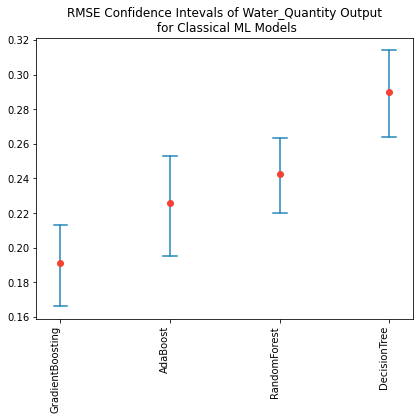

In [541]:
plt.figure(figsize=(6,6))
plt.xticks(range(len(conf_interv_result[outputs[0]])),list(conf_interv_result[outputs[0]]['Model']),
            rotation = 90, ha="right")
plt.title('RMSE Confidence Intevals of Water_Quantity Output\n for Classical ML Models',fontsize=12)
for C1,C2,b in zip(conf_interv_result[outputs[0]]['C1'],conf_interv_result[outputs[0]]['C2'],
                    range(len(conf_interv_result[outputs[0]]))):
    color='#2187bb'
    horizontal_line_width=0.25
    left = b - horizontal_line_width / 4
    right = b + horizontal_line_width / 4
    #plt.plot((b,b),(C1,C2),'ro-',color='orange')
    plt.plot([b, b], [C2, C1], color=color)
    plt.plot([left, right], [C2, C2], color=color)
    plt.plot([left, right], [C1, C1], color=color)
    plt.plot(b, conf_interv_result[outputs[0]]['RMSE'][b], 'o', color='#f44336')
save_fig('RMSE_Confidence_Intevals_of_WQ_for_Classical_ML_Models')

#plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
plt.show()

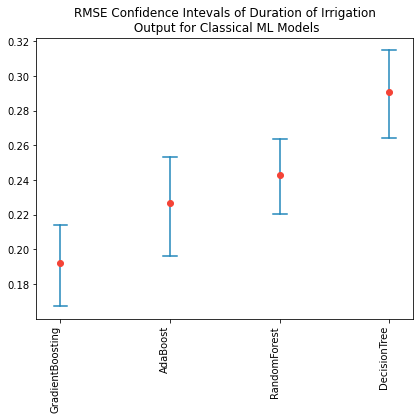

In [542]:
plt.figure(figsize=(6,6))
plt.xticks(range(len(conf_interv_result[outputs[1]])),list(conf_interv_result[outputs[1]]['Model']),
            rotation = 90, ha="right")
plt.title('RMSE Confidence Intevals of Duration of Irrigation\n Output for Classical ML Models',fontsize=12)
for C1,C2,b in zip(conf_interv_result[outputs[1]]['C1'],conf_interv_result[outputs[1]]['C2'],
                    range(len(conf_interv_result[outputs[1]]))):
    color='#2187bb'
    horizontal_line_width=0.25
    left = b - horizontal_line_width / 4
    right = b + horizontal_line_width / 4
    #plt.plot((b,b),(C1,C2),'ro-',color='orange')
    plt.plot([b, b], [C2, C1], color=color)
    plt.plot([left, right], [C2, C2], color=color)
    plt.plot([left, right], [C1, C1], color=color)
    plt.plot(b, conf_interv_result[outputs[1]]['RMSE'][b], 'o', color='#f44336')
save_fig('RMSE_Confidence_Intevals_of_DI_for_Classical_ML_Models')

#plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
plt.show()

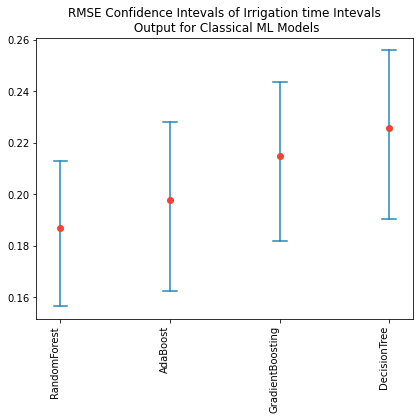

In [543]:
plt.figure(figsize=(6,6))
plt.xticks(range(len(conf_interv_result[outputs[2]])),list(conf_interv_result[outputs[2]]['Model']),
            rotation = 90, ha="right")
plt.title('RMSE Confidence Intevals of Irrigation time Intevals\n Output for Classical ML Models',fontsize=12)
for C1,C2,b in zip(conf_interv_result[outputs[2]]['C1'],conf_interv_result[outputs[2]]['C2'],
                    range(len(conf_interv_result[outputs[2]]))):
    color='#2187bb'
    horizontal_line_width=0.25
    left = b - horizontal_line_width / 4
    right = b + horizontal_line_width / 4
    #plt.plot((b,b),(C1,C2),'ro-',color='orange')
    plt.plot([b, b], [C2, C1], color=color)
    plt.plot([left, right], [C2, C2], color=color)
    plt.plot([left, right], [C1, C1], color=color)
    plt.plot(b, conf_interv_result[outputs[2]]['RMSE'][b], 'o', color='#f44336')
save_fig('RMSE_Confidence_Intevals_of_ITI_for_Classical_ML_Models')

#plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
plt.show()

In [544]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.compose import TransformedTargetRegressor
from sklearn.metrics import mean_squared_error,r2_score
from scipy.stats import randint
from sklearn.multioutput import RegressorChain



outputs=y.columns
train_results=dict()
train_results[outputs[0]]=[] 
train_results[outputs[1]]=[]
train_results[outputs[2]]=[]
test_results=dict()
test_results[outputs[0]]=[] 
test_results[outputs[1]]=[]
test_results[outputs[2]]=[]
conf_interv_results=dict()
conf_interv_results[outputs[0]]=[]
conf_interv_results[outputs[1]]=[]
conf_interv_results[outputs[2]]=[]
train_rmse=dict()
train_r2=dict()
train_mse=dict()
test_rmse=dict()
test_r2=dict()
test_mse=dict()
c1=dict()
c2=dict()



estimator=RandomForestRegressor(n_estimators= 100,criterion='squared_error',
    max_depth= None,min_samples_split= 2,min_samples_leaf= 1,min_weight_fraction_leaf= 0,max_features='sqrt',
    max_leaf_nodes= None,min_impurity_decrease= 0,bootstrap= True,oob_score=False,n_jobs= -1,
    ccp_alpha=0,max_samples= None,random_state=42)

best_models=dict()

best_models['Chain_RF']=RegressorChain(base_estimator=estimator,order=[0,1,2],random_state=42)
full_pipeline = Pipeline([
    ('preprocessing', preprocessing),
    ('Chain_RF',best_models['Chain_RF'] )
                        ])
       
param_grid=[{ 
                'Chain_RF__base_estimator__max_depth':[8],
                'Chain_RF__base_estimator__n_estimators':[300],
                'Chain_RF__base_estimator__criterion':['squared_error'],
                'Chain_RF__base_estimator__min_samples_split':[2],
                'Chain_RF__base_estimator__max_samples':[None],
                'Chain_RF__base_estimator__max_features':['sqrt'],
                'Chain_RF__base_estimator__ccp_alpha':[0],              
            }]
grid_search=GridSearchCV(full_pipeline,param_grid,cv=10,scoring='neg_root_mean_squared_error',verbose=1)


In [545]:
grid_search.fit(X_train,y_train)


Fitting 10 folds for each of 1 candidates, totalling 10 fits


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessing',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('simpleimputer',
                                                                                          SimpleImputer()),
                                                                                         ('standardscaler',
                                                                                          StandardScaler())]),
                                                                         Index(['AbsHumOut', 'Iglob', 'PARout', 'Pyrgeo', 'RadSum', 'Rain', 'Rhout',
       'Tout', 'Winddir', 'Windsp', 'EC_slab1', 'EC_slab2', 'WC_slab1',
       'WC_slab2', 't_slab1', 't_slab2', 'A...
             param_grid=[{'Chain_RF__base_estimator__ccp_alpha': [0],
                          'Chain_RF__base_estimator__criterion': ['squared_error'],
                          'Chain_RF__base_estimator__max_depth': [8],
                          'Chain_RF__base_estimator__max_features': ['sqrt'],
                          'Chain_RF__base_estimator__max_samples': [None],
                          'Chain_RF__base_estimator__min_samples_split': [2],
                          'Chain_RF__base_estimator__n_estimators': [300]}],
             scoring='neg_root_mean_squared_error', verbose=1)

In [546]:
train_prediction=cross_val_predict(grid_search.best_estimator_,X_train,y_train,cv=10)
test_prediction=cross_val_predict(grid_search.best_estimator_,X_test,y_test,cv=10)

#rmse_percentage=rmse.mean()/y.mean()
#print('rmse percentage:',rmse_percentage)
#print(grid_search.best_params_)

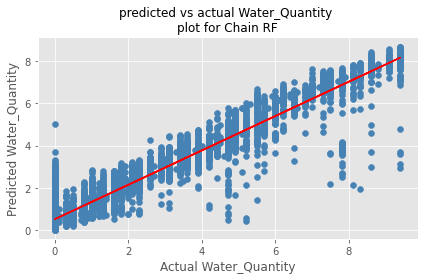

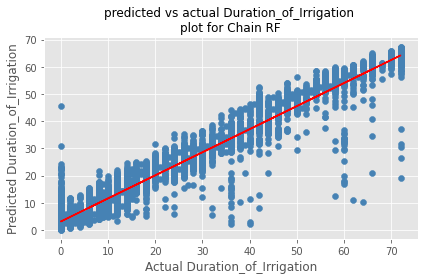

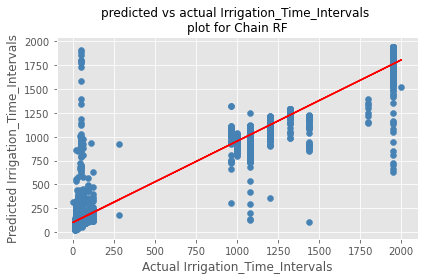

[('Chain_RF', 0.27359983628981993, 0.20901051573088664, 0.9089697990008077)] 
 [('Chain_RF', 0.245366043199506, 1.2920663645487973, 0.926904745610215)] 
 [('Chain_RF', 0.2021369288095919, 31.69381648417906, 0.9373610453734216)] 

[('Chain_RF', 0.2837217778845503, 0.22476144509248785, 0.9031379462237442)] 
 [('Chain_RF', 0.2594162060527123, 1.4442757156777606, 0.9191247533995012)] 
 [('Chain_RF', 0.22860579416258378, 40.5375670896336, 0.9211608039263998)] 

[('Chain_RF', 0.2837217778845503, 0.2685925619115747, 0.2980840991695416, 0.029491537257966882)] 
 [('Chain_RF', 0.2594162060527123, 0.2424964130282566, 0.27529806681848634, 0.03280165379022973)] 
 [('Chain_RF', 0.22860579416258378, 0.21046983235292532, 0.24540510980569, 0.034935277452764674)] 



In [547]:


for i,out in zip(range(0,len(y.columns),1),y.columns):
    #train scores:
    train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[out],squared=False)/y[out].mean()
    train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train[out])/y[out].mean()
    train_r2[out]=r2_score(y_true=y_train[out],y_pred=train_prediction[:,i])
    #train result for each output
    train_results[out].append(('Chain_RF',train_rmse[out],train_mse[out],train_r2[out]))
   
    #test scores:
    test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[out],squared=False)/y[out].mean()
    test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test[out])/y[out].mean()
    test_r2[out]=r2_score(y_true=y_test[out],y_pred=test_prediction[:,i])
    #test result for each output
    test_results[out].append(('Chain_RF',test_rmse[out],test_mse[out],test_r2[out]))
    
    # Plot predicted vs actual
    plt.style.use("ggplot")
    plt.scatter(y_test[out], test_prediction[:,i],color='steelblue')
    plt.xlabel(f'Actual {out}')
    plt.ylabel(f'Predicted {out}')
    plt.title(f'predicted vs actual {out} \nplot for Chain RF',fontsize=12)
    # overlay the regression line
    z = np.polyfit(y_test[out], test_prediction[:,i], 1)
    p = np.poly1d(z)
    plt.plot(y_test[out],p(y_test[out]),color='red')
    #plt.grid()
    save_fig(f'predicted vs actual {out} plot for Chain RF')
    plt.show()



    from scipy import stats
    #confidence_interval:
    confidence = 0.95
    squared_errors = (test_prediction[:,i] - y_test[out]) ** 2
    zscore = stats.norm.ppf((1 + confidence) / 2)
    zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
    c1[out] = np.sqrt(squared_errors.mean() - zmargin)/y[out].mean()
    c2[out] = np.sqrt(squared_errors.mean() + zmargin)/y[out].mean()
    #confidence_intervals for each output:
    conf_interv_results[out].append(('Chain_RF',test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
    
print(train_results[outputs[0]],'\n',train_results[outputs[1]],'\n',train_results[outputs[2]],'\n')
print(test_results[outputs[0]],'\n',test_results[outputs[1]],'\n',test_results[outputs[2]],'\n')
print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n')


In [548]:
y_test[out].values

array([ 30.,  30.,  30., ...,  60.,  60., 282.])

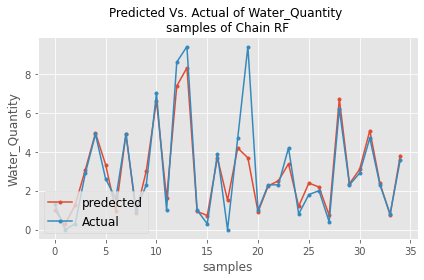

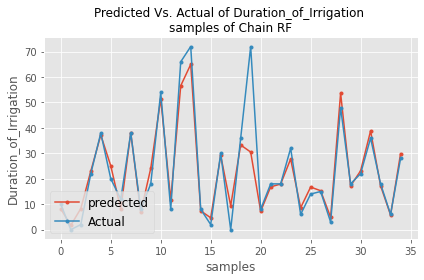

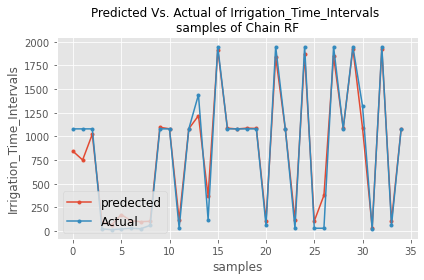

In [549]:
for pred_out,i in zip(outputs,range(len(outputs))):
    plt.style.use("ggplot")
    plt.figure()
    plt.plot(test_prediction[:,i][15:50],label='predected', marker=".")
    plt.plot(y_test[pred_out].values[15:50],label='Actual',marker=".")

    plt.title(f"Predicted Vs. Actual of {pred_out} \nsamples of Chain RF",fontsize=12)
    plt.xlabel("samples")
    plt.ylabel(f"{pred_out}")
    plt.legend(loc="lower left")
    save_fig(f"Predicted Vs. Actual of {pred_out} in discrete time series points of Chain RF")

    plt.show()

In [550]:
#grid_search_test_rmse=dict()
#for i,out in zip(range(0,len(y.columns),1),y.columns):
#
#    grid_search_test_rmse[out]=mean_squared_error(y_pred=pred[:,i],y_true=y_train[out],squared=False)/y[out].mean()
#print(grid_search_test_rmse)

In [551]:
#print('best score=',-grid_search.best_score_/y.mean())
#rmse=-cross_val_score(full_pipeline,X_train,y_train,scoring='neg_root_mean_squared_error',cv=10)
#rmse.mean()
#rmse_percentage=rmse.mean()/y.mean()
#print('rmse percentage:',rmse_percentage)
#print(grid_search.best_params_)

In [552]:
best_params=grid_search.best_params_
#best_params['RandomForestRegressor__base_estimator']=grid_search.best_estimator_['RandomForestRegressor__base_estimator'].n_estimators_
GBR_best_param=pd.DataFrame.from_dict(grid_search.best_params_,orient='index',columns=['best value'])
GBR_best_param['best value']

Chain_RF__base_estimator__ccp_alpha                        0
Chain_RF__base_estimator__criterion            squared_error
Chain_RF__base_estimator__max_depth                        8
Chain_RF__base_estimator__max_features                  sqrt
Chain_RF__base_estimator__max_samples                   None
Chain_RF__base_estimator__min_samples_split                2
Chain_RF__base_estimator__n_estimators                   300
Name: best value, dtype: object

In [553]:
feature_importances=dict()
features_imoprtance=dict()
for out,estimator in zip(outputs,grid_search.best_estimator_['Chain_RF'].estimators_):
    feature_importances[out]=estimator.feature_importances_.round(2)
    features_imoprtance[out]=sorted(zip(feature_importances[out],
           grid_search.best_estimator_["preprocessing"].get_feature_names_out()),reverse=True)

    features_imoprtance[out]=pd.DataFrame(features_imoprtance[out],
               columns=['importance','features'])

    #import dataframe_image as dfi
    #
    #dfi.export(features_imoprtance, "FeatureImportanceTable.png")
#features_imoprtance[outputs[0]]



In [554]:
#features_imoprtance[outputs[1]]


In [555]:
#features_imoprtance[outputs[2]]


In [556]:
#feature_importances

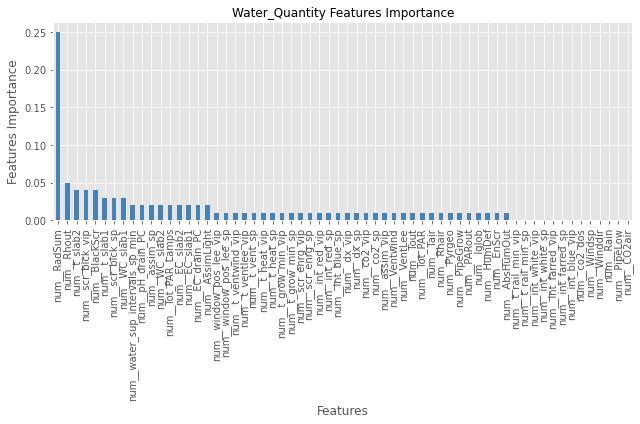

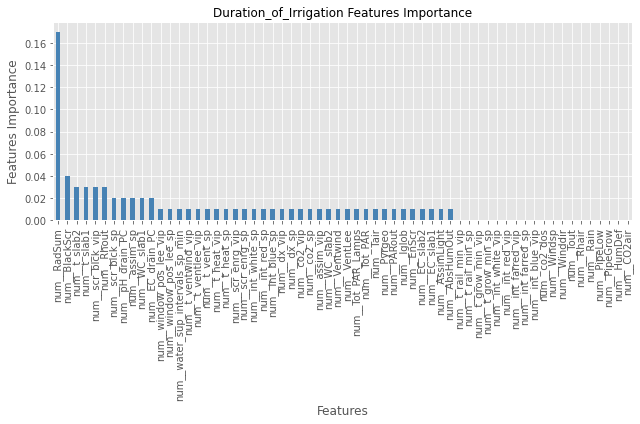

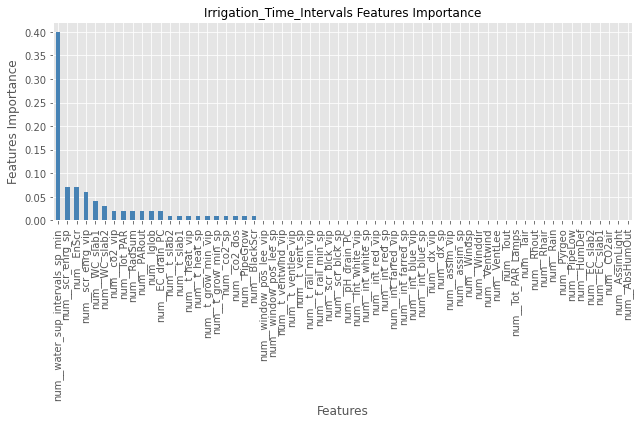

In [557]:
for i,out in zip(range(0,len(outputs),1),outputs):
    #features_imoprtance[out].set_index('features')
    features_imoprtance[out].index=features_imoprtance[out]['features']
    #plt.subplot(1,3,i+1)

    fig = plt.figure(figsize=(9, 6))
    ax = fig.gca()
    (features_imoprtance[out]['importance']).plot.bar(ax=ax,color='steelblue')

    #(features_imoprtance[out]['importance']/features_imoprtance[out]['importance'].max()*100).plot.bar(ax=ax)
    ax.set_title(f'{out} Features Importance',fontsize=12)
    ax.set_xlabel('Features')
    ax.set_ylabel("Features Importance")
    save_fig(f'Features Importance of {out} Output')

    plt.show()

(47809, 3)
(47809, 62)
X_train (38725, 62)
X_test (4781, 62)
X_valid (4303, 62)
y_train (38725, 3)
y_test (4781, 3)
y_valid (4303, 3)
62
Epoch 1/500
606/606 [==============================] - 6s 6ms/step - loss: 0.0381 - root_mean_squared_error: 0.7981 - val_loss: 0.0038 - val_root_mean_squared_error: 0.0875
Epoch 2/500
606/606 [==============================] - 4s 6ms/step - loss: 0.0029 - root_mean_squared_error: 0.0765 - val_loss: 0.0033 - val_root_mean_squared_error: 0.0806
Epoch 3/500
606/606 [==============================] - 4s 6ms/step - loss: 0.0025 - root_mean_squared_error: 0.0710 - val_loss: 0.0031 - val_root_mean_squared_error: 0.0791
Epoch 4/500
606/606 [==============================] - 3s 6ms/step - loss: 0.0029 - root_mean_squared_error: 0.0761 - val_loss: 0.0032 - val_root_mean_squared_error: 0.0806
Epoch 5/500
606/606 [==============================] - 3s 6ms/step - loss: 0.0034 - root_mean_squared_error: 0.0824 - val_loss: 0.0046 - val_root_mean_squared_error: 0.096

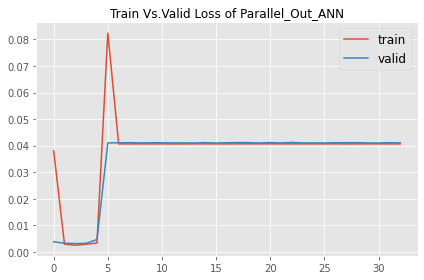

In [558]:
#Using ANN for a multioutput regresion task:
import tensorflow as tf
from tensorflow import keras 
from keras import layers
tf.keras.backend.clear_session()
np.random.seed(42)
tf.random.set_seed(42)
y=pd.DataFrame(green_house.loc[:,['Water_Quantity','Duration_of_Irrigation','Irrigation_Time_Intervals']])

X=green_house.drop(['Duration_of_Irrigation','Water_Quantity','Irrigation_Time_Intervals'],axis=1).copy()
print(y.shape)
print(X.shape)


from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10, random_state=0,shuffle=True,
                                                    stratify=green_house['Rain'])





X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train,test_size=0.10, random_state=42)

X_train=preprocessing.fit_transform(X_train)
X_test=preprocessing.transform(X_test)
X_valid=preprocessing.transform(X_valid)

print('X_train',X_train.shape)
print('X_test',X_test.shape)
print('X_valid',X_valid.shape)
from sklearn.preprocessing import MinMaxScaler
min_max_scaler=MinMaxScaler()

y_train=min_max_scaler.fit_transform(y_train)
y_test=min_max_scaler.transform(y_test)
y_valid=min_max_scaler.transform(y_valid)
print('y_train',y_train.shape)
print('y_test',y_test.shape)
print('y_valid',y_valid.shape)


y_train_pred=[]
print(X_train.shape[1:][0])

norm_layer = tf.keras.layers.Normalization(input_shape=X_train.shape[1:])
leaky_relu = keras.layers.LeakyReLU(alpha=0.3)  # defaults to alpha=0.3
best_models['Parallel_Out_ANN'] = tf.keras.Sequential([
    norm_layer,
    tf.keras.layers.Dense(500, activation='swish',kernel_initializer="he_normal"),
    tf.keras.layers.Dense(150, activation='swish',kernel_initializer="he_normal"),
    tf.keras.layers.Dense(500, activation='swish',kernel_initializer="he_normal"),
    tf.keras.layers.Dense(150, activation='swish',kernel_initializer="he_normal"),
    tf.keras.layers.Dense(500, activation='swish',kernel_initializer="he_normal"),
    tf.keras.layers.Dense(150, activation='swish',kernel_initializer="he_normal"),

    tf.keras.layers.Dense(3,activation='linear',kernel_initializer="he_normal")
])
checkpoint_path = "training_1/par_cp.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(checkpoint_path,
                                                   save_weights_only=True)


early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=30,
                                                     restore_best_weights=True)
best_models['Parallel_Out_ANN'].compile(loss="huber", optimizer=optimizer, metrics=["RootMeanSquaredError"])
norm_layer.adapt(X_train)
history = best_models['Parallel_Out_ANN'].fit(X_train, y_train, epochs=500,
                    validation_data=(X_valid, y_valid),batch_size=64,callbacks=[checkpoint_cb, early_stopping_cb])
#mse_test, rmse_test = model.evaluate(X_test, y_test)
#X_new = X_test[:3]
# plot loss during training
plt.title('Train Vs.Valid Loss of Parallel_Out_ANN',fontsize=12)
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='valid')
plt.legend()
save_fig('Train Vs.Valid Loss of Parallel_Out_ANN')

plt.show()



In [559]:
len(history.history['loss'])

33

In [560]:
train_RMSE = best_models['Parallel_Out_ANN'].evaluate(X_train, y_train,return_dict=True, verbose=1)
val_RMSE = best_models['Parallel_Out_ANN'].evaluate(X_valid, y_valid,return_dict=True, verbose=1)

test_RMSE = best_models['Parallel_Out_ANN'].evaluate(X_test, y_test,return_dict=True, verbose=1)
print(f'Train: {train_RMSE},\n val: {val_RMSE},\nTest: {test_RMSE}')

 158/1211 [==>...........................] - ETA: 4s - loss: 0.0027 - root_mean_squared_error: 0.0732

150/150 [==============================] - 0s 2ms/step - loss: 0.0025 - root_mean_squared_error: 0.0706
Train: {'loss': 0.0027324731927365065, 'root_mean_squared_error': 0.07392527908086777},
 val: {'loss': 0.0031274105422198772, 'root_mean_squared_error': 0.07908743619918823},
Test: {'loss': 0.0024956015404313803, 'root_mean_squared_error': 0.0706484317779541}


In [561]:
train_prediction = best_models['Parallel_Out_ANN'].predict((X_train))
train_prediction.reshape(len(y_train),3)

test_prediction = best_models['Parallel_Out_ANN'].predict((X_test))
test_prediction.reshape(len(y_test),3)

test_prediction


150/150 [==============================] - 0s 2ms/step


array([[ 0.11642294,  0.12576553,  0.00149715],
       [ 0.22007585,  0.22290803,  0.00547707],
       [ 0.22712359,  0.23336968, -0.01285788],
       ...,
       [ 0.06630384,  0.07001903,  0.02170993],
       [ 0.06602955,  0.05462633,  0.0232099 ],
       [ 0.9344476 ,  0.94951415,  0.55206764]], dtype=float32)

In [562]:
train_prediction=min_max_scaler.inverse_transform(train_prediction)
test_prediction=min_max_scaler.inverse_transform(test_prediction)

In [563]:
y_test

array([[0.08510638, 0.08333333, 0.015     ],
       [0.30851064, 0.30555556, 0.015     ],
       [0.27659574, 0.27777778, 0.015     ],
       ...,
       [0.13829787, 0.13888889, 0.03      ],
       [0.08510638, 0.08333333, 0.03      ],
       [0.91489362, 0.91666667, 0.141     ]])

In [564]:
test_prediction

array([[ 1.0943756e+00,  9.0551186e+00,  2.9942989e+00],
       [ 2.0687129e+00,  1.6049379e+01,  1.0954142e+01],
       [ 2.1349618e+00,  1.6802616e+01, -2.5715769e+01],
       ...,
       [ 6.2325609e-01,  5.0413699e+00,  4.3419868e+01],
       [ 6.2067777e-01,  3.9330959e+00,  4.6419800e+01],
       [ 8.7838078e+00,  6.8365021e+01,  1.1041353e+03]], dtype=float32)

In [565]:

y_train_inv=min_max_scaler.inverse_transform(y_train)
y_test_inv=min_max_scaler.inverse_transform(y_test)


In [566]:
y_train_inv.shape

(38725, 3)

In [567]:
test_prediction.shape

(4781, 3)

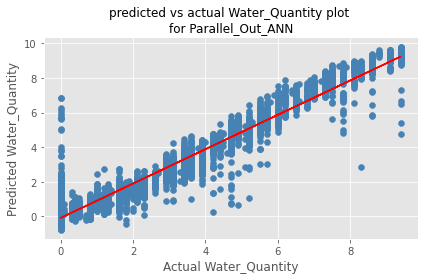

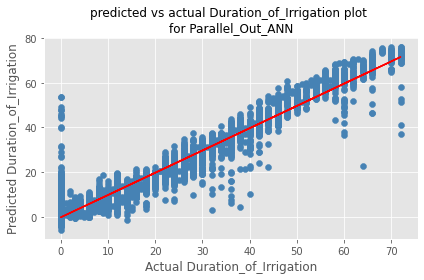

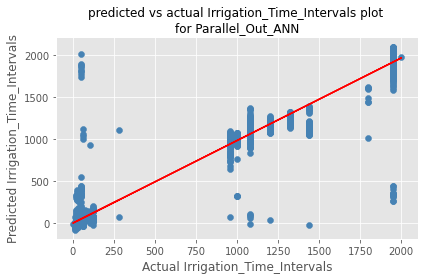

[('Chain_RF', 0.27359983628981993, 0.20901051573088664, 0.9089697990008077), ('Parallel_Out_ANN', 0.25958121542119134, 0.18814080315085172, 0.9178446143232565)] 
 [('Chain_RF', 0.245366043199506, 1.2920663645487973, 0.926904745610215), ('Parallel_Out_ANN', 0.2583070077282812, 1.4319514019485597, 0.9187791246116915)] 
 [('Chain_RF', 0.2021369288095919, 31.69381648417906, 0.9373610453734216), ('Parallel_Out_ANN', 0.173376120137314, 23.31641480859448, 0.9539774673572599)] 

[('Chain_RF', 0.2837217778845503, 0.22476144509248785, 0.9031379462237442), ('Parallel_Out_ANN', 0.23654456777580146, 0.1562292789781142, 0.9326722213608444)] 
 [('Chain_RF', 0.2594162060527123, 1.4442757156777606, 0.9191247533995012), ('Parallel_Out_ANN', 0.23521556105225405, 1.1873752757598544, 0.9335104321204005)] 
 [('Chain_RF', 0.22860579416258378, 40.5375670896336, 0.9211608039263998), ('Parallel_Out_ANN', 0.18451549080321733, 26.408812832688795, 0.9486390101215574)] 

[('Chain_RF', 0.2837217778845503, 0.26859256

In [568]:

for i,out in zip(range(0,len(y.columns),1),y.columns):
    #train scores:
    train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train_inv[:,i],squared=False)/y[out].mean()
    train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train_inv[:,i])/y[out].mean()
    train_r2[out]=r2_score(y_true=y_train_inv[:,i],y_pred=train_prediction[:,i])
    #train result for each output
    train_results[out].append(('Parallel_Out_ANN',train_rmse[out],train_mse[out],train_r2[out]))
   
    #test scores:
    test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test_inv[:,i],squared=False)/y[out].mean()
    test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test_inv[:,i])/y[out].mean()
    test_r2[out]=r2_score(y_true=y_test_inv[:,i],y_pred=test_prediction[:,i])
    #test result for each output
    test_results[out].append(('Parallel_Out_ANN',test_rmse[out],test_mse[out],test_r2[out]))
    
    # Plot predicted vs actual
    plt.style.use("ggplot")
    plt.scatter(y_test_inv[:,i], test_prediction[:,i],color='steelblue')
    plt.xlabel(f'Actual {out}')
    plt.ylabel(f'Predicted {out}')
    plt.title(f'predicted vs actual {out} plot \nfor Parallel_Out_ANN',fontsize=12)
    # overlay the regression line
    z = np.polyfit(y_test_inv[:,i], test_prediction[:,i], 1)
    p = np.poly1d(z)
    plt.plot(y_test_inv[:,i],p(y_test_inv[:,i]),color='red')
    #plt.grid()
    save_fig(f'predicted vs actual {out} plot for Parallel_Out_ANN')
    plt.show()

    from scipy import stats
    #confidence_interval:
    confidence = 0.95
    squared_errors = (test_prediction[:,i] - y_test_inv[:,i]) ** 2
    zscore = stats.norm.ppf((1 + confidence) / 2)
    zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
    c1[out],c2[out] = np.sqrt(squared_errors.mean() - zmargin)/y[out].mean(), np.sqrt(squared_errors.mean() 
                    + zmargin)/y[out].mean()
    #confidence_intervals for each output:
    conf_interv_results[out].append(('Parallel_Out_ANN',test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
        

print(train_results[outputs[0]],'\n',train_results[outputs[1]],'\n',train_results[outputs[2]],'\n')
print(test_results[outputs[0]],'\n',test_results[outputs[1]],'\n',test_results[outputs[2]],'\n')
print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n')


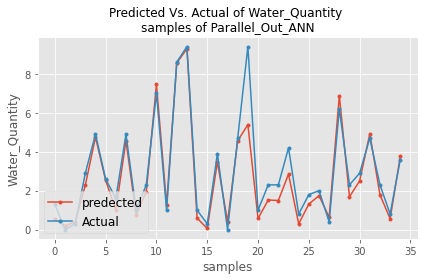

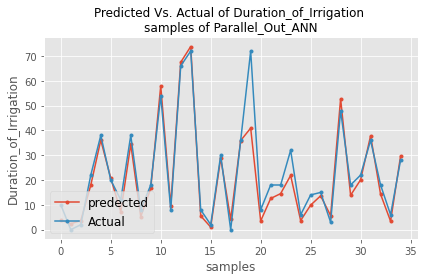

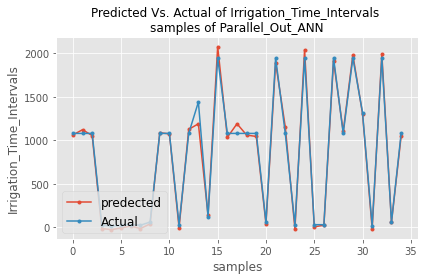

In [569]:
for pred_out,i in zip(outputs,range(len(outputs))):
    plt.style.use("ggplot")
    predictions=test_prediction[:,i]
    plt.figure()
    plt.plot(predictions[15:50],label='predected', marker=".")
    plt.plot(y_test_inv[:,i][15:50],label='Actual',marker=".")

    plt.title(f"Predicted Vs. Actual of {pred_out} \nsamples of Parallel_Out_ANN",fontsize=12)
    plt.xlabel("samples")
    plt.ylabel(f"{pred_out}")
    plt.legend(loc="lower left")
    save_fig(f"Predicted Vs. Actual of {pred_out} in discrete time series points of Parallel_Out_ANN")

    plt.show()

In [570]:
y_train_pred=best_models['Parallel_Out_ANN'].predict(X_train)

  79/1211 [>.............................] - ETA: 4s

1211/1211 [==============================] - 3s 3ms/step


In [571]:
y_train_pred

array([[0.00430994, 0.01176475, 1.0099281 ],
       [0.07548358, 0.07372709, 0.51808465],
       [0.03703066, 0.02265923, 0.02612254],
       ...,
       [0.09569757, 0.08403147, 0.01846097],
       [1.0291309 , 1.0345176 , 0.536834  ],
       [0.14106286, 0.13912457, 0.51636994]], dtype=float32)

In [572]:
#model=model.load_weights("my_checkpoints")
model_rms_train=mean_squared_error(y_pred=y_train_pred[:,0],y_true=y_train[:,0],squared=False)#/y_train[outputs[0]].mean()
model_rms_train

0.07710488237808631

In [573]:
model_rms_train=mean_squared_error(y_pred=y_train_pred[:,1],y_true=y_train[:,1],squared=False)#/y[outputs[1]].mean()
model_rms_train

0.07699448066321955

In [574]:
model_rms_train=mean_squared_error(y_pred=y_train_pred[:,2],y_true=y_train[:,2],squared=False)#/y[outputs[2]].mean()
model_rms_train

0.06724229022924345

In [575]:
y_pred_test = best_models['Parallel_Out_ANN'].predict(X_test)

150/150 [==============================] - 1s 4ms/step


In [576]:
model_rms_test=mean_squared_error(y_pred=y_pred_test[:,0],y_true=y_test[:,0],squared=False)#/y_train[outputs[0]].mean()
model_rms_test

0.07026217622690804

In [577]:
model_rms_test=mean_squared_error(y_pred=y_pred_test[:,1],y_true=y_test[:,1],squared=False)#/y_train[outputs[1]].mean()
model_rms_test

0.0701115314570767

In [578]:
model_rms_train=mean_squared_error(y_pred=y_pred_test[:,2],y_true=y_test[:,2],squared=False)#/y_train[outputs[1]].mean()
model_rms_train

0.07156258984466453

X_train (38725, 62)
X_test (4781, 62)
X_valid (4303, 62)
y_train (38725, 3)
y_test (4781, 3)
y_valid (4303, 3)
62


Epoch 1/300
302/303 [============================>.] - ETA: 0s - loss: 0.1894 - dense_13_loss: 0.0549 - dense_14_loss: 0.0674 - dense_15_loss: 0.0671 - dense_13_root_mean_squared_error: 0.6551 - dense_14_root_mean_squared_error: 0.8051 - dense_15_root_mean_squared_error: 0.8100

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 23ms/step - loss: 0.1890 - dense_13_loss: 0.0548 - dense_14_loss: 0.0673 - dense_15_loss: 0.0670 - dense_13_root_mean_squared_error: 0.6546 - dense_14_root_mean_squared_error: 0.8044 - dense_15_root_mean_squared_error: 0.8093 - val_loss: 0.0122 - val_dense_13_loss: 0.0052 - val_dense_14_loss: 0.0043 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.1016 - val_dense_14_root_mean_squared_error: 0.0931 - val_dense_15_root_mean_squared_error: 0.0730
Epoch 2/300
299/303 [============================>.] - ETA: 0s - loss: 0.0094 - dense_13_loss: 0.0037 - dense_14_loss: 0.0034 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0856 - dense_14_root_mean_squared_error: 0.0825 - dense_15_root_mean_squared_error: 0.0687

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 6s 20ms/step - loss: 0.0094 - dense_13_loss: 0.0037 - dense_14_loss: 0.0034 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0856 - dense_14_root_mean_squared_error: 0.0826 - dense_15_root_mean_squared_error: 0.0684 - val_loss: 0.0099 - val_dense_13_loss: 0.0039 - val_dense_14_loss: 0.0035 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0881 - val_dense_14_root_mean_squared_error: 0.0833 - val_dense_15_root_mean_squared_error: 0.0715
Epoch 3/300
303/303 [==============================] - ETA: 0s - loss: 0.0080 - dense_13_loss: 0.0030 - dense_14_loss: 0.0028 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0768 - dense_14_root_mean_squared_error: 0.0746 - dense_15_root_mean_squared_error: 0.0679

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 6s 21ms/step - loss: 0.0080 - dense_13_loss: 0.0030 - dense_14_loss: 0.0028 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0768 - dense_14_root_mean_squared_error: 0.0746 - dense_15_root_mean_squared_error: 0.0679 - val_loss: 0.0091 - val_dense_13_loss: 0.0034 - val_dense_14_loss: 0.0031 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0827 - val_dense_14_root_mean_squared_error: 0.0792 - val_dense_15_root_mean_squared_error: 0.0714
Epoch 4/300
300/303 [============================>.] - ETA: 0s - loss: 0.0077 - dense_13_loss: 0.0027 - dense_14_loss: 0.0026 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0740 - dense_14_root_mean_squared_error: 0.0724 - dense_15_root_mean_squared_error: 0.0682

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 8s 27ms/step - loss: 0.0077 - dense_13_loss: 0.0027 - dense_14_loss: 0.0026 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0739 - dense_14_root_mean_squared_error: 0.0723 - dense_15_root_mean_squared_error: 0.0680 - val_loss: 0.0081 - val_dense_13_loss: 0.0028 - val_dense_14_loss: 0.0026 - val_dense_15_loss: 0.0028 - val_dense_13_root_mean_squared_error: 0.0743 - val_dense_14_root_mean_squared_error: 0.0716 - val_dense_15_root_mean_squared_error: 0.0751
Epoch 5/300
302/303 [============================>.] - ETA: 0s - loss: 0.0071 - dense_13_loss: 0.0025 - dense_14_loss: 0.0024 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0704 - dense_14_root_mean_squared_error: 0.0693 - dense_15_root_mean_squared_error: 0.0670

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 32ms/step - loss: 0.0071 - dense_13_loss: 0.0025 - dense_14_loss: 0.0024 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0704 - dense_14_root_mean_squared_error: 0.0693 - dense_15_root_mean_squared_error: 0.0670 - val_loss: 0.0079 - val_dense_13_loss: 0.0027 - val_dense_14_loss: 0.0026 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0733 - val_dense_14_root_mean_squared_error: 0.0728 - val_dense_15_root_mean_squared_error: 0.0717
Epoch 6/300
302/303 [============================>.] - ETA: 0s - loss: 0.0070 - dense_13_loss: 0.0024 - dense_14_loss: 0.0023 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0693 - dense_14_root_mean_squared_error: 0.0683 - dense_15_root_mean_squared_error: 0.0679

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0070 - dense_13_loss: 0.0024 - dense_14_loss: 0.0023 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0693 - dense_14_root_mean_squared_error: 0.0682 - dense_15_root_mean_squared_error: 0.0680 - val_loss: 0.0076 - val_dense_13_loss: 0.0027 - val_dense_14_loss: 0.0025 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0732 - val_dense_14_root_mean_squared_error: 0.0705 - val_dense_15_root_mean_squared_error: 0.0699
Epoch 7/300
302/303 [============================>.] - ETA: 0s - loss: 0.0070 - dense_13_loss: 0.0024 - dense_14_loss: 0.0024 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0691 - dense_14_root_mean_squared_error: 0.0686 - dense_15_root_mean_squared_error: 0.0670

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 41ms/step - loss: 0.0070 - dense_13_loss: 0.0024 - dense_14_loss: 0.0024 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0690 - dense_14_root_mean_squared_error: 0.0686 - dense_15_root_mean_squared_error: 0.0671 - val_loss: 0.0083 - val_dense_13_loss: 0.0028 - val_dense_14_loss: 0.0032 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0746 - val_dense_14_root_mean_squared_error: 0.0799 - val_dense_15_root_mean_squared_error: 0.0678
Epoch 8/300
302/303 [============================>.] - ETA: 0s - loss: 0.0076 - dense_13_loss: 0.0030 - dense_14_loss: 0.0024 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0823 - dense_14_root_mean_squared_error: 0.0693 - dense_15_root_mean_squared_error: 0.0654

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 35ms/step - loss: 0.0076 - dense_13_loss: 0.0030 - dense_14_loss: 0.0024 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0823 - dense_14_root_mean_squared_error: 0.0693 - dense_15_root_mean_squared_error: 0.0654 - val_loss: 0.0087 - val_dense_13_loss: 0.0037 - val_dense_14_loss: 0.0026 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0861 - val_dense_14_root_mean_squared_error: 0.0722 - val_dense_15_root_mean_squared_error: 0.0689
Epoch 9/300
301/303 [============================>.] - ETA: 0s - loss: 0.0071 - dense_13_loss: 0.0026 - dense_14_loss: 0.0023 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0724 - dense_14_root_mean_squared_error: 0.0671 - dense_15_root_mean_squared_error: 0.0668

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0071 - dense_13_loss: 0.0026 - dense_14_loss: 0.0022 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0724 - dense_14_root_mean_squared_error: 0.0671 - dense_15_root_mean_squared_error: 0.0667 - val_loss: 0.0104 - val_dense_13_loss: 0.0028 - val_dense_14_loss: 0.0053 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0746 - val_dense_14_root_mean_squared_error: 0.1065 - val_dense_15_root_mean_squared_error: 0.0677
Epoch 10/300
302/303 [============================>.] - ETA: 0s - loss: 0.0086 - dense_13_loss: 0.0030 - dense_14_loss: 0.0034 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0772 - dense_14_root_mean_squared_error: 0.1421 - dense_15_root_mean_squared_error: 0.0664

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 32ms/step - loss: 0.0086 - dense_13_loss: 0.0030 - dense_14_loss: 0.0034 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0771 - dense_14_root_mean_squared_error: 0.1420 - dense_15_root_mean_squared_error: 0.0663 - val_loss: 0.0083 - val_dense_13_loss: 0.0031 - val_dense_14_loss: 0.0023 - val_dense_15_loss: 0.0029 - val_dense_13_root_mean_squared_error: 0.0786 - val_dense_14_root_mean_squared_error: 0.0679 - val_dense_15_root_mean_squared_error: 0.0758
Epoch 11/300
301/303 [============================>.] - ETA: 0s - loss: 0.0075 - dense_13_loss: 0.0028 - dense_14_loss: 0.0025 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0747 - dense_14_root_mean_squared_error: 0.0705 - dense_15_root_mean_squared_error: 0.0664

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 31ms/step - loss: 0.0075 - dense_13_loss: 0.0028 - dense_14_loss: 0.0025 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0748 - dense_14_root_mean_squared_error: 0.0705 - dense_15_root_mean_squared_error: 0.0663 - val_loss: 0.0073 - val_dense_13_loss: 0.0026 - val_dense_14_loss: 0.0023 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0715 - val_dense_14_root_mean_squared_error: 0.0681 - val_dense_15_root_mean_squared_error: 0.0699
Epoch 12/300
303/303 [==============================] - ETA: 0s - loss: 0.0095 - dense_13_loss: 0.0027 - dense_14_loss: 0.0024 - dense_15_loss: 0.0044 - dense_13_root_mean_squared_error: 0.0733 - dense_14_root_mean_squared_error: 0.0688 - dense_15_root_mean_squared_error: 0.1264

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 30ms/step - loss: 0.0095 - dense_13_loss: 0.0027 - dense_14_loss: 0.0024 - dense_15_loss: 0.0044 - dense_13_root_mean_squared_error: 0.0733 - dense_14_root_mean_squared_error: 0.0688 - dense_15_root_mean_squared_error: 0.1264 - val_loss: 0.0143 - val_dense_13_loss: 0.0029 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0093 - val_dense_13_root_mean_squared_error: 0.0760 - val_dense_14_root_mean_squared_error: 0.0647 - val_dense_15_root_mean_squared_error: 0.1365
Epoch 13/300
302/303 [============================>.] - ETA: 0s - loss: 0.0076 - dense_13_loss: 0.0024 - dense_14_loss: 0.0022 - dense_15_loss: 0.0030 - dense_13_root_mean_squared_error: 0.0695 - dense_14_root_mean_squared_error: 0.0671 - dense_15_root_mean_squared_error: 0.0773

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 29ms/step - loss: 0.0076 - dense_13_loss: 0.0024 - dense_14_loss: 0.0022 - dense_15_loss: 0.0030 - dense_13_root_mean_squared_error: 0.0695 - dense_14_root_mean_squared_error: 0.0671 - dense_15_root_mean_squared_error: 0.0772 - val_loss: 0.0093 - val_dense_13_loss: 0.0031 - val_dense_14_loss: 0.0036 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0792 - val_dense_14_root_mean_squared_error: 0.0847 - val_dense_15_root_mean_squared_error: 0.0721
Epoch 14/300
303/303 [==============================] - ETA: 0s - loss: 0.0077 - dense_13_loss: 0.0028 - dense_14_loss: 0.0025 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0755 - dense_14_root_mean_squared_error: 0.0706 - dense_15_root_mean_squared_error: 0.0690

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 29ms/step - loss: 0.0077 - dense_13_loss: 0.0028 - dense_14_loss: 0.0025 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0755 - dense_14_root_mean_squared_error: 0.0706 - dense_15_root_mean_squared_error: 0.0690 - val_loss: 0.0088 - val_dense_13_loss: 0.0033 - val_dense_14_loss: 0.0028 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0812 - val_dense_14_root_mean_squared_error: 0.0752 - val_dense_15_root_mean_squared_error: 0.0725
Epoch 15/300
301/303 [============================>.] - ETA: 0s - loss: 0.0084 - dense_13_loss: 0.0032 - dense_14_loss: 0.0029 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0798 - dense_14_root_mean_squared_error: 0.0763 - dense_15_root_mean_squared_error: 0.0679

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 30ms/step - loss: 0.0084 - dense_13_loss: 0.0032 - dense_14_loss: 0.0029 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0799 - dense_14_root_mean_squared_error: 0.0765 - dense_15_root_mean_squared_error: 0.0677 - val_loss: 0.0114 - val_dense_13_loss: 0.0044 - val_dense_14_loss: 0.0044 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0939 - val_dense_14_root_mean_squared_error: 0.0935 - val_dense_15_root_mean_squared_error: 0.0729
Epoch 16/300
300/303 [============================>.] - ETA: 0s - loss: 0.0077 - dense_13_loss: 0.0027 - dense_14_loss: 0.0027 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0737 - dense_14_root_mean_squared_error: 0.0728 - dense_15_root_mean_squared_error: 0.0684

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 30ms/step - loss: 0.0077 - dense_13_loss: 0.0027 - dense_14_loss: 0.0026 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0735 - dense_14_root_mean_squared_error: 0.0727 - dense_15_root_mean_squared_error: 0.0685 - val_loss: 0.0086 - val_dense_13_loss: 0.0025 - val_dense_14_loss: 0.0024 - val_dense_15_loss: 0.0037 - val_dense_13_root_mean_squared_error: 0.0713 - val_dense_14_root_mean_squared_error: 0.0690 - val_dense_15_root_mean_squared_error: 0.0861
Epoch 17/300
303/303 [==============================] - ETA: 0s - loss: 0.0075 - dense_13_loss: 0.0027 - dense_14_loss: 0.0025 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0730 - dense_14_root_mean_squared_error: 0.0712 - dense_15_root_mean_squared_error: 0.0678

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 7s 24ms/step - loss: 0.0075 - dense_13_loss: 0.0027 - dense_14_loss: 0.0025 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0730 - dense_14_root_mean_squared_error: 0.0712 - dense_15_root_mean_squared_error: 0.0678 - val_loss: 0.0083 - val_dense_13_loss: 0.0028 - val_dense_14_loss: 0.0024 - val_dense_15_loss: 0.0031 - val_dense_13_root_mean_squared_error: 0.0749 - val_dense_14_root_mean_squared_error: 0.0692 - val_dense_15_root_mean_squared_error: 0.0781
Epoch 18/300
302/303 [============================>.] - ETA: 0s - loss: 0.0075 - dense_13_loss: 0.0024 - dense_14_loss: 0.0026 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0695 - dense_14_root_mean_squared_error: 0.0719 - dense_15_root_mean_squared_error: 0.0700

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 9s 30ms/step - loss: 0.0074 - dense_13_loss: 0.0024 - dense_14_loss: 0.0026 - dense_15_loss: 0.0025 - dense_13_root_mean_squared_error: 0.0695 - dense_14_root_mean_squared_error: 0.0719 - dense_15_root_mean_squared_error: 0.0700 - val_loss: 0.0070 - val_dense_13_loss: 0.0024 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0698 - val_dense_14_root_mean_squared_error: 0.0653 - val_dense_15_root_mean_squared_error: 0.0695
Epoch 19/300
303/303 [==============================] - ETA: 0s - loss: 0.0073 - dense_13_loss: 0.0023 - dense_14_loss: 0.0026 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0683 - dense_14_root_mean_squared_error: 0.0722 - dense_15_root_mean_squared_error: 0.0683

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0073 - dense_13_loss: 0.0023 - dense_14_loss: 0.0026 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0683 - dense_14_root_mean_squared_error: 0.0722 - dense_15_root_mean_squared_error: 0.0683 - val_loss: 0.0088 - val_dense_13_loss: 0.0026 - val_dense_14_loss: 0.0029 - val_dense_15_loss: 0.0033 - val_dense_13_root_mean_squared_error: 0.0721 - val_dense_14_root_mean_squared_error: 0.0761 - val_dense_15_root_mean_squared_error: 0.0815
Epoch 20/300
302/303 [============================>.] - ETA: 0s - loss: 0.0073 - dense_13_loss: 0.0023 - dense_14_loss: 0.0027 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0672 - dense_14_root_mean_squared_error: 0.0737 - dense_15_root_mean_squared_error: 0.0684

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0073 - dense_13_loss: 0.0023 - dense_14_loss: 0.0027 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0672 - dense_14_root_mean_squared_error: 0.0737 - dense_15_root_mean_squared_error: 0.0684 - val_loss: 0.0082 - val_dense_13_loss: 0.0024 - val_dense_14_loss: 0.0032 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0687 - val_dense_14_root_mean_squared_error: 0.0798 - val_dense_15_root_mean_squared_error: 0.0734
Epoch 21/300
301/303 [============================>.] - ETA: 0s - loss: 0.0071 - dense_13_loss: 0.0023 - dense_14_loss: 0.0025 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0673 - dense_14_root_mean_squared_error: 0.0712 - dense_15_root_mean_squared_error: 0.0682

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 41ms/step - loss: 0.0071 - dense_13_loss: 0.0023 - dense_14_loss: 0.0025 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0673 - dense_14_root_mean_squared_error: 0.0712 - dense_15_root_mean_squared_error: 0.0681 - val_loss: 0.0086 - val_dense_13_loss: 0.0026 - val_dense_14_loss: 0.0024 - val_dense_15_loss: 0.0037 - val_dense_13_root_mean_squared_error: 0.0715 - val_dense_14_root_mean_squared_error: 0.0689 - val_dense_15_root_mean_squared_error: 0.0856
Epoch 22/300
303/303 [==============================] - ETA: 0s - loss: 0.0069 - dense_13_loss: 0.0020 - dense_14_loss: 0.0024 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0640 - dense_14_root_mean_squared_error: 0.0694 - dense_15_root_mean_squared_error: 0.0693

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 39ms/step - loss: 0.0069 - dense_13_loss: 0.0020 - dense_14_loss: 0.0024 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0640 - dense_14_root_mean_squared_error: 0.0694 - dense_15_root_mean_squared_error: 0.0693 - val_loss: 0.0071 - val_dense_13_loss: 0.0023 - val_dense_14_loss: 0.0024 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0673 - val_dense_14_root_mean_squared_error: 0.0687 - val_dense_15_root_mean_squared_error: 0.0704
Epoch 23/300
302/303 [============================>.] - ETA: 0s - loss: 0.0071 - dense_13_loss: 0.0021 - dense_14_loss: 0.0026 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0655 - dense_14_root_mean_squared_error: 0.0716 - dense_15_root_mean_squared_error: 0.0686

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0071 - dense_13_loss: 0.0021 - dense_14_loss: 0.0026 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0655 - dense_14_root_mean_squared_error: 0.0716 - dense_15_root_mean_squared_error: 0.0686 - val_loss: 0.0084 - val_dense_13_loss: 0.0025 - val_dense_14_loss: 0.0033 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0705 - val_dense_14_root_mean_squared_error: 0.0810 - val_dense_15_root_mean_squared_error: 0.0725
Epoch 24/300
301/303 [============================>.] - ETA: 0s - loss: 0.0069 - dense_13_loss: 0.0021 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0647 - dense_14_root_mean_squared_error: 0.0698 - dense_15_root_mean_squared_error: 0.0685

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0069 - dense_13_loss: 0.0021 - dense_14_loss: 0.0024 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0646 - dense_14_root_mean_squared_error: 0.0697 - dense_15_root_mean_squared_error: 0.0686 - val_loss: 0.0076 - val_dense_13_loss: 0.0023 - val_dense_14_loss: 0.0025 - val_dense_15_loss: 0.0028 - val_dense_13_root_mean_squared_error: 0.0685 - val_dense_14_root_mean_squared_error: 0.0704 - val_dense_15_root_mean_squared_error: 0.0743
Epoch 25/300
303/303 [==============================] - ETA: 0s - loss: 0.0068 - dense_13_loss: 0.0021 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0641 - dense_14_root_mean_squared_error: 0.0696 - dense_15_root_mean_squared_error: 0.0676

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 32ms/step - loss: 0.0068 - dense_13_loss: 0.0021 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0641 - dense_14_root_mean_squared_error: 0.0696 - dense_15_root_mean_squared_error: 0.0676 - val_loss: 0.0106 - val_dense_13_loss: 0.0033 - val_dense_14_loss: 0.0044 - val_dense_15_loss: 0.0029 - val_dense_13_root_mean_squared_error: 0.0816 - val_dense_14_root_mean_squared_error: 0.0937 - val_dense_15_root_mean_squared_error: 0.0773
Epoch 26/300
300/303 [============================>.] - ETA: 0s - loss: 0.0069 - dense_13_loss: 0.0022 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0664 - dense_14_root_mean_squared_error: 0.0696 - dense_15_root_mean_squared_error: 0.0674

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 32ms/step - loss: 0.0069 - dense_13_loss: 0.0022 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0664 - dense_14_root_mean_squared_error: 0.0696 - dense_15_root_mean_squared_error: 0.0677 - val_loss: 0.0109 - val_dense_13_loss: 0.0040 - val_dense_14_loss: 0.0041 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0897 - val_dense_14_root_mean_squared_error: 0.0911 - val_dense_15_root_mean_squared_error: 0.0733
Epoch 27/300
301/303 [============================>.] - ETA: 0s - loss: 0.0069 - dense_13_loss: 0.0022 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0660 - dense_14_root_mean_squared_error: 0.0699 - dense_15_root_mean_squared_error: 0.0681

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 33ms/step - loss: 0.0069 - dense_13_loss: 0.0022 - dense_14_loss: 0.0024 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0660 - dense_14_root_mean_squared_error: 0.0699 - dense_15_root_mean_squared_error: 0.0680 - val_loss: 0.0064 - val_dense_13_loss: 0.0020 - val_dense_14_loss: 0.0020 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0633 - val_dense_14_root_mean_squared_error: 0.0640 - val_dense_15_root_mean_squared_error: 0.0691
Epoch 28/300
301/303 [============================>.] - ETA: 0s - loss: 0.0064 - dense_13_loss: 0.0019 - dense_14_loss: 0.0022 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0610 - dense_14_root_mean_squared_error: 0.0663 - dense_15_root_mean_squared_error: 0.0677

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 35ms/step - loss: 0.0064 - dense_13_loss: 0.0019 - dense_14_loss: 0.0022 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0611 - dense_14_root_mean_squared_error: 0.0664 - dense_15_root_mean_squared_error: 0.0679 - val_loss: 0.0069 - val_dense_13_loss: 0.0022 - val_dense_14_loss: 0.0023 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0661 - val_dense_14_root_mean_squared_error: 0.0672 - val_dense_15_root_mean_squared_error: 0.0696
Epoch 29/300
301/303 [============================>.] - ETA: 0s - loss: 0.0068 - dense_13_loss: 0.0019 - dense_14_loss: 0.0022 - dense_15_loss: 0.0027 - dense_13_root_mean_squared_error: 0.0615 - dense_14_root_mean_squared_error: 0.0667 - dense_15_root_mean_squared_error: 0.0753

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 39ms/step - loss: 0.0068 - dense_13_loss: 0.0019 - dense_14_loss: 0.0022 - dense_15_loss: 0.0027 - dense_13_root_mean_squared_error: 0.0615 - dense_14_root_mean_squared_error: 0.0666 - dense_15_root_mean_squared_error: 0.0751 - val_loss: 0.0081 - val_dense_13_loss: 0.0026 - val_dense_14_loss: 0.0027 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0728 - val_dense_14_root_mean_squared_error: 0.0736 - val_dense_15_root_mean_squared_error: 0.0734
Epoch 30/300
301/303 [============================>.] - ETA: 0s - loss: 0.0065 - dense_13_loss: 0.0017 - dense_14_loss: 0.0022 - dense_15_loss: 0.0026 - dense_13_root_mean_squared_error: 0.0591 - dense_14_root_mean_squared_error: 0.0662 - dense_15_root_mean_squared_error: 0.0721

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 13s 43ms/step - loss: 0.0065 - dense_13_loss: 0.0017 - dense_14_loss: 0.0022 - dense_15_loss: 0.0026 - dense_13_root_mean_squared_error: 0.0590 - dense_14_root_mean_squared_error: 0.0662 - dense_15_root_mean_squared_error: 0.0720 - val_loss: 0.0062 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0019 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0606 - val_dense_14_root_mean_squared_error: 0.0618 - val_dense_15_root_mean_squared_error: 0.0699
Epoch 31/300
302/303 [============================>.] - ETA: 0s - loss: 0.0062 - dense_13_loss: 0.0018 - dense_14_loss: 0.0021 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0593 - dense_14_root_mean_squared_error: 0.0654 - dense_15_root_mean_squared_error: 0.0680

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0062 - dense_13_loss: 0.0018 - dense_14_loss: 0.0021 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0593 - dense_14_root_mean_squared_error: 0.0654 - dense_15_root_mean_squared_error: 0.0680 - val_loss: 0.0065 - val_dense_13_loss: 0.0020 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0637 - val_dense_14_root_mean_squared_error: 0.0641 - val_dense_15_root_mean_squared_error: 0.0689
Epoch 32/300
303/303 [==============================] - ETA: 0s - loss: 0.0061 - dense_13_loss: 0.0018 - dense_14_loss: 0.0022 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0594 - dense_14_root_mean_squared_error: 0.0656 - dense_15_root_mean_squared_error: 0.0669

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0061 - dense_13_loss: 0.0018 - dense_14_loss: 0.0022 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0594 - dense_14_root_mean_squared_error: 0.0656 - dense_15_root_mean_squared_error: 0.0669 - val_loss: 0.0066 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0647 - val_dense_14_root_mean_squared_error: 0.0641 - val_dense_15_root_mean_squared_error: 0.0694
Epoch 33/300
302/303 [============================>.] - ETA: 0s - loss: 0.0058 - dense_13_loss: 0.0016 - dense_14_loss: 0.0020 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0570 - dense_14_root_mean_squared_error: 0.0634 - dense_15_root_mean_squared_error: 0.0663

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0058 - dense_13_loss: 0.0016 - dense_14_loss: 0.0020 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0571 - dense_14_root_mean_squared_error: 0.0635 - dense_15_root_mean_squared_error: 0.0662 - val_loss: 0.0065 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0019 - val_dense_15_loss: 0.0028 - val_dense_13_root_mean_squared_error: 0.0592 - val_dense_14_root_mean_squared_error: 0.0619 - val_dense_15_root_mean_squared_error: 0.0746
Epoch 34/300
301/303 [============================>.] - ETA: 0s - loss: 0.0061 - dense_13_loss: 0.0017 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0590 - dense_14_root_mean_squared_error: 0.0651 - dense_15_root_mean_squared_error: 0.0671

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0061 - dense_13_loss: 0.0017 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0589 - dense_14_root_mean_squared_error: 0.0651 - dense_15_root_mean_squared_error: 0.0670 - val_loss: 0.0059 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0018 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0596 - val_dense_14_root_mean_squared_error: 0.0593 - val_dense_15_root_mean_squared_error: 0.0690
Epoch 35/300
303/303 [==============================] - ETA: 0s - loss: 0.0072 - dense_13_loss: 0.0024 - dense_14_loss: 0.0026 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0687 - dense_14_root_mean_squared_error: 0.0724 - dense_15_root_mean_squared_error: 0.0662

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 35ms/step - loss: 0.0072 - dense_13_loss: 0.0024 - dense_14_loss: 0.0026 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0687 - dense_14_root_mean_squared_error: 0.0724 - dense_15_root_mean_squared_error: 0.0662 - val_loss: 0.0085 - val_dense_13_loss: 0.0029 - val_dense_14_loss: 0.0028 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0766 - val_dense_14_root_mean_squared_error: 0.0746 - val_dense_15_root_mean_squared_error: 0.0741
Epoch 36/300
302/303 [============================>.] - ETA: 0s - loss: 0.0070 - dense_13_loss: 0.0020 - dense_14_loss: 0.0024 - dense_15_loss: 0.0026 - dense_13_root_mean_squared_error: 0.0634 - dense_14_root_mean_squared_error: 0.0689 - dense_15_root_mean_squared_error: 0.0727

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0070 - dense_13_loss: 0.0020 - dense_14_loss: 0.0024 - dense_15_loss: 0.0026 - dense_13_root_mean_squared_error: 0.0634 - dense_14_root_mean_squared_error: 0.0689 - dense_15_root_mean_squared_error: 0.0727 - val_loss: 0.0062 - val_dense_13_loss: 0.0019 - val_dense_14_loss: 0.0019 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0613 - val_dense_14_root_mean_squared_error: 0.0612 - val_dense_15_root_mean_squared_error: 0.0695
Epoch 37/300
302/303 [============================>.] - ETA: 0s - loss: 0.0062 - dense_13_loss: 0.0017 - dense_14_loss: 0.0020 - dense_15_loss: 0.0025 - dense_13_root_mean_squared_error: 0.0583 - dense_14_root_mean_squared_error: 0.0627 - dense_15_root_mean_squared_error: 0.0711

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0062 - dense_13_loss: 0.0017 - dense_14_loss: 0.0020 - dense_15_loss: 0.0025 - dense_13_root_mean_squared_error: 0.0583 - dense_14_root_mean_squared_error: 0.0628 - dense_15_root_mean_squared_error: 0.0710 - val_loss: 0.0065 - val_dense_13_loss: 0.0019 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0621 - val_dense_14_root_mean_squared_error: 0.0650 - val_dense_15_root_mean_squared_error: 0.0695
Epoch 38/300
301/303 [============================>.] - ETA: 0s - loss: 0.0074 - dense_13_loss: 0.0027 - dense_14_loss: 0.0023 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.1521 - dense_14_root_mean_squared_error: 0.0686 - dense_15_root_mean_squared_error: 0.0688

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 35ms/step - loss: 0.0074 - dense_13_loss: 0.0027 - dense_14_loss: 0.0023 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.1517 - dense_14_root_mean_squared_error: 0.0686 - dense_15_root_mean_squared_error: 0.0689 - val_loss: 0.0078 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0033 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0642 - val_dense_14_root_mean_squared_error: 0.0807 - val_dense_15_root_mean_squared_error: 0.0706
Epoch 39/300
302/303 [============================>.] - ETA: 0s - loss: 0.0065 - dense_13_loss: 0.0018 - dense_14_loss: 0.0022 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0607 - dense_14_root_mean_squared_error: 0.0659 - dense_15_root_mean_squared_error: 0.0700

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 35ms/step - loss: 0.0065 - dense_13_loss: 0.0018 - dense_14_loss: 0.0022 - dense_15_loss: 0.0025 - dense_13_root_mean_squared_error: 0.0607 - dense_14_root_mean_squared_error: 0.0659 - dense_15_root_mean_squared_error: 0.0704 - val_loss: 0.0075 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0026 - val_dense_15_loss: 0.0028 - val_dense_13_root_mean_squared_error: 0.0652 - val_dense_14_root_mean_squared_error: 0.0721 - val_dense_15_root_mean_squared_error: 0.0742
Epoch 40/300
303/303 [==============================] - ETA: 0s - loss: 0.0065 - dense_13_loss: 0.0020 - dense_14_loss: 0.0023 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0627 - dense_14_root_mean_squared_error: 0.0673 - dense_15_root_mean_squared_error: 0.0676

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 32ms/step - loss: 0.0065 - dense_13_loss: 0.0020 - dense_14_loss: 0.0023 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0627 - dense_14_root_mean_squared_error: 0.0673 - dense_15_root_mean_squared_error: 0.0676 - val_loss: 0.0070 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0026 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0648 - val_dense_14_root_mean_squared_error: 0.0719 - val_dense_15_root_mean_squared_error: 0.0682
Epoch 41/300
302/303 [============================>.] - ETA: 0s - loss: 0.0061 - dense_13_loss: 0.0018 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0597 - dense_14_root_mean_squared_error: 0.0654 - dense_15_root_mean_squared_error: 0.0661

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 35ms/step - loss: 0.0061 - dense_13_loss: 0.0018 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0597 - dense_14_root_mean_squared_error: 0.0654 - dense_15_root_mean_squared_error: 0.0661 - val_loss: 0.0071 - val_dense_13_loss: 0.0022 - val_dense_14_loss: 0.0024 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0661 - val_dense_14_root_mean_squared_error: 0.0689 - val_dense_15_root_mean_squared_error: 0.0717
Epoch 42/300
302/303 [============================>.] - ETA: 0s - loss: 0.0057 - dense_13_loss: 0.0016 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0561 - dense_14_root_mean_squared_error: 0.0621 - dense_15_root_mean_squared_error: 0.0660

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0057 - dense_13_loss: 0.0016 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0561 - dense_14_root_mean_squared_error: 0.0622 - dense_15_root_mean_squared_error: 0.0662 - val_loss: 0.0067 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0019 - val_dense_15_loss: 0.0030 - val_dense_13_root_mean_squared_error: 0.0607 - val_dense_14_root_mean_squared_error: 0.0609 - val_dense_15_root_mean_squared_error: 0.0770
Epoch 43/300
303/303 [==============================] - ETA: 0s - loss: 0.0057 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0546 - dense_14_root_mean_squared_error: 0.0621 - dense_15_root_mean_squared_error: 0.0672

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 13s 43ms/step - loss: 0.0057 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0546 - dense_14_root_mean_squared_error: 0.0621 - dense_15_root_mean_squared_error: 0.0672 - val_loss: 0.0075 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0037 - val_dense_13_root_mean_squared_error: 0.0596 - val_dense_14_root_mean_squared_error: 0.0643 - val_dense_15_root_mean_squared_error: 0.0858
Epoch 44/300
303/303 [==============================] - ETA: 0s - loss: 0.0062 - dense_13_loss: 0.0017 - dense_14_loss: 0.0020 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0628 - dense_14_root_mean_squared_error: 0.0640 - dense_15_root_mean_squared_error: 0.0696

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0062 - dense_13_loss: 0.0017 - dense_14_loss: 0.0020 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0628 - dense_14_root_mean_squared_error: 0.0640 - dense_15_root_mean_squared_error: 0.0696 - val_loss: 0.0065 - val_dense_13_loss: 0.0017 - val_dense_14_loss: 0.0018 - val_dense_15_loss: 0.0030 - val_dense_13_root_mean_squared_error: 0.0589 - val_dense_14_root_mean_squared_error: 0.0592 - val_dense_15_root_mean_squared_error: 0.0772
Epoch 45/300
302/303 [============================>.] - ETA: 0s - loss: 0.0058 - dense_13_loss: 0.0017 - dense_14_loss: 0.0019 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0578 - dense_14_root_mean_squared_error: 0.0618 - dense_15_root_mean_squared_error: 0.0672

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0058 - dense_13_loss: 0.0017 - dense_14_loss: 0.0019 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0578 - dense_14_root_mean_squared_error: 0.0618 - dense_15_root_mean_squared_error: 0.0673 - val_loss: 0.0058 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0018 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0574 - val_dense_14_root_mean_squared_error: 0.0602 - val_dense_15_root_mean_squared_error: 0.0681
Epoch 46/300
303/303 [==============================] - ETA: 0s - loss: 0.0056 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0551 - dense_14_root_mean_squared_error: 0.0618 - dense_15_root_mean_squared_error: 0.0660

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0056 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0551 - dense_14_root_mean_squared_error: 0.0618 - dense_15_root_mean_squared_error: 0.0660 - val_loss: 0.0056 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0574 - val_dense_14_root_mean_squared_error: 0.0576 - val_dense_15_root_mean_squared_error: 0.0678
Epoch 47/300
302/303 [============================>.] - ETA: 0s - loss: 0.0057 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0556 - dense_14_root_mean_squared_error: 0.0622 - dense_15_root_mean_squared_error: 0.0659

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0057 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0556 - dense_14_root_mean_squared_error: 0.0623 - dense_15_root_mean_squared_error: 0.0659 - val_loss: 0.0056 - val_dense_13_loss: 0.0015 - val_dense_14_loss: 0.0015 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0546 - val_dense_14_root_mean_squared_error: 0.0556 - val_dense_15_root_mean_squared_error: 0.0715
Epoch 48/300
303/303 [==============================] - ETA: 0s - loss: 0.0083 - dense_13_loss: 0.0027 - dense_14_loss: 0.0025 - dense_15_loss: 0.0030 - dense_13_root_mean_squared_error: 0.0764 - dense_14_root_mean_squared_error: 0.0718 - dense_15_root_mean_squared_error: 0.0800

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 38ms/step - loss: 0.0083 - dense_13_loss: 0.0027 - dense_14_loss: 0.0025 - dense_15_loss: 0.0030 - dense_13_root_mean_squared_error: 0.0764 - dense_14_root_mean_squared_error: 0.0718 - dense_15_root_mean_squared_error: 0.0800 - val_loss: 0.0078 - val_dense_13_loss: 0.0019 - val_dense_14_loss: 0.0025 - val_dense_15_loss: 0.0033 - val_dense_13_root_mean_squared_error: 0.0617 - val_dense_14_root_mean_squared_error: 0.0712 - val_dense_15_root_mean_squared_error: 0.0817
Epoch 49/300
301/303 [============================>.] - ETA: 0s - loss: 0.0062 - dense_13_loss: 0.0018 - dense_14_loss: 0.0021 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0604 - dense_14_root_mean_squared_error: 0.0645 - dense_15_root_mean_squared_error: 0.0677

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0062 - dense_13_loss: 0.0018 - dense_14_loss: 0.0021 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0603 - dense_14_root_mean_squared_error: 0.0644 - dense_15_root_mean_squared_error: 0.0679 - val_loss: 0.0067 - val_dense_13_loss: 0.0020 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0632 - val_dense_14_root_mean_squared_error: 0.0655 - val_dense_15_root_mean_squared_error: 0.0721
Epoch 50/300
301/303 [============================>.] - ETA: 0s - loss: 0.0060 - dense_13_loss: 0.0016 - dense_14_loss: 0.0020 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0573 - dense_14_root_mean_squared_error: 0.0634 - dense_15_root_mean_squared_error: 0.0684

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0060 - dense_13_loss: 0.0016 - dense_14_loss: 0.0020 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0572 - dense_14_root_mean_squared_error: 0.0634 - dense_15_root_mean_squared_error: 0.0683 - val_loss: 0.0063 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0020 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0601 - val_dense_14_root_mean_squared_error: 0.0639 - val_dense_15_root_mean_squared_error: 0.0699
Epoch 51/300
302/303 [============================>.] - ETA: 0s - loss: 0.0056 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0546 - dense_14_root_mean_squared_error: 0.0616 - dense_15_root_mean_squared_error: 0.0664

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 35ms/step - loss: 0.0056 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0545 - dense_14_root_mean_squared_error: 0.0616 - dense_15_root_mean_squared_error: 0.0664 - val_loss: 0.0103 - val_dense_13_loss: 0.0033 - val_dense_14_loss: 0.0045 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0817 - val_dense_14_root_mean_squared_error: 0.0945 - val_dense_15_root_mean_squared_error: 0.0708
Epoch 52/300
301/303 [============================>.] - ETA: 0s - loss: 0.0055 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0550 - dense_14_root_mean_squared_error: 0.0608 - dense_15_root_mean_squared_error: 0.0654

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 39ms/step - loss: 0.0055 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0550 - dense_14_root_mean_squared_error: 0.0608 - dense_15_root_mean_squared_error: 0.0655 - val_loss: 0.0072 - val_dense_13_loss: 0.0022 - val_dense_14_loss: 0.0023 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0670 - val_dense_14_root_mean_squared_error: 0.0672 - val_dense_15_root_mean_squared_error: 0.0730
Epoch 53/300
301/303 [============================>.] - ETA: 0s - loss: 0.0057 - dense_13_loss: 0.0014 - dense_14_loss: 0.0019 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0536 - dense_14_root_mean_squared_error: 0.0618 - dense_15_root_mean_squared_error: 0.0689

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0057 - dense_13_loss: 0.0014 - dense_14_loss: 0.0019 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0618 - dense_15_root_mean_squared_error: 0.0689 - val_loss: 0.0057 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0015 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0562 - val_dense_14_root_mean_squared_error: 0.0551 - val_dense_15_root_mean_squared_error: 0.0724
Epoch 54/300
301/303 [============================>.] - ETA: 0s - loss: 0.0069 - dense_13_loss: 0.0027 - dense_14_loss: 0.0020 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.2496 - dense_14_root_mean_squared_error: 0.0638 - dense_15_root_mean_squared_error: 0.0674

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0069 - dense_13_loss: 0.0027 - dense_14_loss: 0.0020 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.2490 - dense_14_root_mean_squared_error: 0.0639 - dense_15_root_mean_squared_error: 0.0674 - val_loss: 0.0069 - val_dense_13_loss: 0.0015 - val_dense_14_loss: 0.0030 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0551 - val_dense_14_root_mean_squared_error: 0.0777 - val_dense_15_root_mean_squared_error: 0.0689
Epoch 55/300
301/303 [============================>.] - ETA: 0s - loss: 0.0056 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0549 - dense_14_root_mean_squared_error: 0.0608 - dense_15_root_mean_squared_error: 0.0664

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 13s 43ms/step - loss: 0.0055 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0549 - dense_14_root_mean_squared_error: 0.0607 - dense_15_root_mean_squared_error: 0.0663 - val_loss: 0.0052 - val_dense_13_loss: 0.0014 - val_dense_14_loss: 0.0014 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0533 - val_dense_14_root_mean_squared_error: 0.0532 - val_dense_15_root_mean_squared_error: 0.0688
Epoch 56/300
303/303 [==============================] - ETA: 0s - loss: 0.0064 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0031 - dense_13_root_mean_squared_error: 0.0541 - dense_14_root_mean_squared_error: 0.0603 - dense_15_root_mean_squared_error: 0.1732

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 13s 41ms/step - loss: 0.0064 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0031 - dense_13_root_mean_squared_error: 0.0541 - dense_14_root_mean_squared_error: 0.0603 - dense_15_root_mean_squared_error: 0.1732 - val_loss: 0.0087 - val_dense_13_loss: 0.0028 - val_dense_14_loss: 0.0032 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0752 - val_dense_14_root_mean_squared_error: 0.0799 - val_dense_15_root_mean_squared_error: 0.0729
Epoch 57/300
302/303 [============================>.] - ETA: 0s - loss: 0.0061 - dense_13_loss: 0.0019 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0650 - dense_14_root_mean_squared_error: 0.0647 - dense_15_root_mean_squared_error: 0.0662

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 35ms/step - loss: 0.0062 - dense_13_loss: 0.0019 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0650 - dense_14_root_mean_squared_error: 0.0647 - dense_15_root_mean_squared_error: 0.0664 - val_loss: 0.0072 - val_dense_13_loss: 0.0024 - val_dense_14_loss: 0.0024 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0692 - val_dense_14_root_mean_squared_error: 0.0687 - val_dense_15_root_mean_squared_error: 0.0706
Epoch 58/300
301/303 [============================>.] - ETA: 0s - loss: 0.0055 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.0541 - dense_14_root_mean_squared_error: 0.0592 - dense_15_root_mean_squared_error: 0.0671

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0055 - dense_13_loss: 0.0015 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0541 - dense_14_root_mean_squared_error: 0.0593 - dense_15_root_mean_squared_error: 0.0670 - val_loss: 0.0057 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0015 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0557 - val_dense_14_root_mean_squared_error: 0.0552 - val_dense_15_root_mean_squared_error: 0.0727
Epoch 59/300
303/303 [==============================] - ETA: 0s - loss: 0.0056 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0529 - dense_14_root_mean_squared_error: 0.0600 - dense_15_root_mean_squared_error: 0.0694

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0056 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0529 - dense_14_root_mean_squared_error: 0.0600 - dense_15_root_mean_squared_error: 0.0694 - val_loss: 0.0076 - val_dense_13_loss: 0.0019 - val_dense_14_loss: 0.0020 - val_dense_15_loss: 0.0036 - val_dense_13_root_mean_squared_error: 0.0621 - val_dense_14_root_mean_squared_error: 0.0640 - val_dense_15_root_mean_squared_error: 0.0890
Epoch 60/300
302/303 [============================>.] - ETA: 0s - loss: 0.0054 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0513 - dense_14_root_mean_squared_error: 0.0579 - dense_15_root_mean_squared_error: 0.0698

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0054 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0513 - dense_14_root_mean_squared_error: 0.0579 - dense_15_root_mean_squared_error: 0.0699 - val_loss: 0.0077 - val_dense_13_loss: 0.0019 - val_dense_14_loss: 0.0023 - val_dense_15_loss: 0.0035 - val_dense_13_root_mean_squared_error: 0.0617 - val_dense_14_root_mean_squared_error: 0.0682 - val_dense_15_root_mean_squared_error: 0.0834
Epoch 61/300
301/303 [============================>.] - ETA: 0s - loss: 0.0056 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0523 - dense_14_root_mean_squared_error: 0.0595 - dense_15_root_mean_squared_error: 0.0698

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0056 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0523 - dense_14_root_mean_squared_error: 0.0595 - dense_15_root_mean_squared_error: 0.0696 - val_loss: 0.0061 - val_dense_13_loss: 0.0017 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0591 - val_dense_14_root_mean_squared_error: 0.0580 - val_dense_15_root_mean_squared_error: 0.0725
Epoch 62/300
301/303 [============================>.] - ETA: 0s - loss: 0.0055 - dense_13_loss: 0.0013 - dense_14_loss: 0.0018 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0517 - dense_14_root_mean_squared_error: 0.0596 - dense_15_root_mean_squared_error: 0.0688

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 38ms/step - loss: 0.0055 - dense_13_loss: 0.0013 - dense_14_loss: 0.0018 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0518 - dense_14_root_mean_squared_error: 0.0597 - dense_15_root_mean_squared_error: 0.0687 - val_loss: 0.0065 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0020 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0641 - val_dense_14_root_mean_squared_error: 0.0634 - val_dense_15_root_mean_squared_error: 0.0691
Epoch 63/300
303/303 [==============================] - ETA: 0s - loss: 0.0055 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0607 - dense_15_root_mean_squared_error: 0.0667

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0055 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0607 - dense_15_root_mean_squared_error: 0.0667 - val_loss: 0.0053 - val_dense_13_loss: 0.0013 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0519 - val_dense_14_root_mean_squared_error: 0.0577 - val_dense_15_root_mean_squared_error: 0.0680
Epoch 64/300
301/303 [============================>.] - ETA: 0s - loss: 0.0053 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0538 - dense_14_root_mean_squared_error: 0.0598 - dense_15_root_mean_squared_error: 0.0649

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0053 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0538 - dense_14_root_mean_squared_error: 0.0598 - dense_15_root_mean_squared_error: 0.0649 - val_loss: 0.0057 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0016 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0563 - val_dense_14_root_mean_squared_error: 0.0569 - val_dense_15_root_mean_squared_error: 0.0712
Epoch 65/300
303/303 [==============================] - ETA: 0s - loss: 0.0066 - dense_13_loss: 0.0022 - dense_14_loss: 0.0023 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0675 - dense_14_root_mean_squared_error: 0.0680 - dense_15_root_mean_squared_error: 0.0649

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 39ms/step - loss: 0.0066 - dense_13_loss: 0.0022 - dense_14_loss: 0.0023 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0675 - dense_14_root_mean_squared_error: 0.0680 - dense_15_root_mean_squared_error: 0.0649 - val_loss: 0.0057 - val_dense_13_loss: 0.0017 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0022 - val_dense_13_root_mean_squared_error: 0.0584 - val_dense_14_root_mean_squared_error: 0.0588 - val_dense_15_root_mean_squared_error: 0.0671
Epoch 66/300
303/303 [==============================] - ETA: 0s - loss: 0.0058 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0554 - dense_14_root_mean_squared_error: 0.0616 - dense_15_root_mean_squared_error: 0.0705

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0058 - dense_13_loss: 0.0015 - dense_14_loss: 0.0019 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0554 - dense_14_root_mean_squared_error: 0.0616 - dense_15_root_mean_squared_error: 0.0705 - val_loss: 0.0068 - val_dense_13_loss: 0.0014 - val_dense_14_loss: 0.0015 - val_dense_15_loss: 0.0039 - val_dense_13_root_mean_squared_error: 0.0528 - val_dense_14_root_mean_squared_error: 0.0546 - val_dense_15_root_mean_squared_error: 0.0885
Epoch 67/300
303/303 [==============================] - ETA: 0s - loss: 0.0059 - dense_13_loss: 0.0014 - dense_14_loss: 0.0019 - dense_15_loss: 0.0025 - dense_13_root_mean_squared_error: 0.0537 - dense_14_root_mean_squared_error: 0.0614 - dense_15_root_mean_squared_error: 0.0711

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0059 - dense_13_loss: 0.0014 - dense_14_loss: 0.0019 - dense_15_loss: 0.0025 - dense_13_root_mean_squared_error: 0.0537 - dense_14_root_mean_squared_error: 0.0614 - dense_15_root_mean_squared_error: 0.0711 - val_loss: 0.0052 - val_dense_13_loss: 0.0014 - val_dense_14_loss: 0.0015 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0538 - val_dense_14_root_mean_squared_error: 0.0549 - val_dense_15_root_mean_squared_error: 0.0675
Epoch 68/300
301/303 [============================>.] - ETA: 0s - loss: 0.0051 - dense_13_loss: 0.0013 - dense_14_loss: 0.0016 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0512 - dense_14_root_mean_squared_error: 0.0574 - dense_15_root_mean_squared_error: 0.0659

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0051 - dense_13_loss: 0.0013 - dense_14_loss: 0.0016 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0512 - dense_14_root_mean_squared_error: 0.0574 - dense_15_root_mean_squared_error: 0.0660 - val_loss: 0.0060 - val_dense_13_loss: 0.0019 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0622 - val_dense_14_root_mean_squared_error: 0.0589 - val_dense_15_root_mean_squared_error: 0.0679
Epoch 69/300
302/303 [============================>.] - ETA: 0s - loss: 0.0052 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0512 - dense_14_root_mean_squared_error: 0.0584 - dense_15_root_mean_squared_error: 0.0660

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 36ms/step - loss: 0.0052 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0512 - dense_14_root_mean_squared_error: 0.0584 - dense_15_root_mean_squared_error: 0.0659 - val_loss: 0.0054 - val_dense_13_loss: 0.0014 - val_dense_14_loss: 0.0015 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0538 - val_dense_14_root_mean_squared_error: 0.0546 - val_dense_15_root_mean_squared_error: 0.0703
Epoch 70/300
301/303 [============================>.] - ETA: 0s - loss: 0.0053 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0525 - dense_14_root_mean_squared_error: 0.0598 - dense_15_root_mean_squared_error: 0.0660

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 41ms/step - loss: 0.0053 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0525 - dense_14_root_mean_squared_error: 0.0598 - dense_15_root_mean_squared_error: 0.0662 - val_loss: 0.0061 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0016 - val_dense_15_loss: 0.0029 - val_dense_13_root_mean_squared_error: 0.0561 - val_dense_14_root_mean_squared_error: 0.0574 - val_dense_15_root_mean_squared_error: 0.0756
Epoch 71/300
302/303 [============================>.] - ETA: 0s - loss: 0.0061 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0030 - dense_13_root_mean_squared_error: 0.0518 - dense_14_root_mean_squared_error: 0.0590 - dense_15_root_mean_squared_error: 0.0793

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 32ms/step - loss: 0.0061 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0030 - dense_13_root_mean_squared_error: 0.0518 - dense_14_root_mean_squared_error: 0.0589 - dense_15_root_mean_squared_error: 0.0793 - val_loss: 0.0069 - val_dense_13_loss: 0.0022 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0661 - val_dense_14_root_mean_squared_error: 0.0643 - val_dense_15_root_mean_squared_error: 0.0728
Epoch 72/300
303/303 [==============================] - ETA: 0s - loss: 0.0055 - dense_13_loss: 0.0014 - dense_14_loss: 0.0017 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0520 - dense_14_root_mean_squared_error: 0.0586 - dense_15_root_mean_squared_error: 0.0697

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 10s 34ms/step - loss: 0.0055 - dense_13_loss: 0.0014 - dense_14_loss: 0.0017 - dense_15_loss: 0.0024 - dense_13_root_mean_squared_error: 0.0520 - dense_14_root_mean_squared_error: 0.0586 - dense_15_root_mean_squared_error: 0.0697 - val_loss: 0.0064 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0020 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0649 - val_dense_14_root_mean_squared_error: 0.0632 - val_dense_15_root_mean_squared_error: 0.0681
Epoch 73/300
303/303 [==============================] - ETA: 0s - loss: 0.0054 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0606 - dense_15_root_mean_squared_error: 0.0659

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0054 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0606 - dense_15_root_mean_squared_error: 0.0659 - val_loss: 0.0058 - val_dense_13_loss: 0.0015 - val_dense_14_loss: 0.0022 - val_dense_15_loss: 0.0022 - val_dense_13_root_mean_squared_error: 0.0539 - val_dense_14_root_mean_squared_error: 0.0657 - val_dense_15_root_mean_squared_error: 0.0664
Epoch 74/300
303/303 [==============================] - ETA: 0s - loss: 0.0064 - dense_13_loss: 0.0020 - dense_14_loss: 0.0022 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0799 - dense_14_root_mean_squared_error: 0.0676 - dense_15_root_mean_squared_error: 0.0655

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 37ms/step - loss: 0.0064 - dense_13_loss: 0.0020 - dense_14_loss: 0.0022 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0799 - dense_14_root_mean_squared_error: 0.0676 - dense_15_root_mean_squared_error: 0.0655 - val_loss: 0.0103 - val_dense_13_loss: 0.0038 - val_dense_14_loss: 0.0039 - val_dense_15_loss: 0.0026 - val_dense_13_root_mean_squared_error: 0.0924 - val_dense_14_root_mean_squared_error: 0.0928 - val_dense_15_root_mean_squared_error: 0.0720
Epoch 75/300
303/303 [==============================] - ETA: 0s - loss: 0.0057 - dense_13_loss: 0.0016 - dense_14_loss: 0.0020 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0566 - dense_14_root_mean_squared_error: 0.0636 - dense_15_root_mean_squared_error: 0.0647

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0057 - dense_13_loss: 0.0016 - dense_14_loss: 0.0020 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0566 - dense_14_root_mean_squared_error: 0.0636 - dense_15_root_mean_squared_error: 0.0647 - val_loss: 0.0058 - val_dense_13_loss: 0.0016 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0572 - val_dense_14_root_mean_squared_error: 0.0576 - val_dense_15_root_mean_squared_error: 0.0712
Epoch 76/300
302/303 [============================>.] - ETA: 0s - loss: 0.0052 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0506 - dense_14_root_mean_squared_error: 0.0587 - dense_15_root_mean_squared_error: 0.0661

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0052 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0506 - dense_14_root_mean_squared_error: 0.0587 - dense_15_root_mean_squared_error: 0.0661 - val_loss: 0.0057 - val_dense_13_loss: 0.0017 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0023 - val_dense_13_root_mean_squared_error: 0.0581 - val_dense_14_root_mean_squared_error: 0.0582 - val_dense_15_root_mean_squared_error: 0.0678
Epoch 77/300
302/303 [============================>.] - ETA: 0s - loss: 0.0055 - dense_13_loss: 0.0013 - dense_14_loss: 0.0016 - dense_15_loss: 0.0026 - dense_13_root_mean_squared_error: 0.0514 - dense_14_root_mean_squared_error: 0.0566 - dense_15_root_mean_squared_error: 0.1128

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 13s 45ms/step - loss: 0.0055 - dense_13_loss: 0.0013 - dense_14_loss: 0.0016 - dense_15_loss: 0.0026 - dense_13_root_mean_squared_error: 0.0514 - dense_14_root_mean_squared_error: 0.0567 - dense_15_root_mean_squared_error: 0.1128 - val_loss: 0.0069 - val_dense_13_loss: 0.0021 - val_dense_14_loss: 0.0021 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0644 - val_dense_14_root_mean_squared_error: 0.0651 - val_dense_15_root_mean_squared_error: 0.0736
Epoch 78/300
301/303 [============================>.] - ETA: 0s - loss: 0.0067 - dense_13_loss: 0.0024 - dense_14_loss: 0.0021 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.1747 - dense_14_root_mean_squared_error: 0.0655 - dense_15_root_mean_squared_error: 0.0673

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 41ms/step - loss: 0.0067 - dense_13_loss: 0.0024 - dense_14_loss: 0.0021 - dense_15_loss: 0.0023 - dense_13_root_mean_squared_error: 0.1743 - dense_14_root_mean_squared_error: 0.0654 - dense_15_root_mean_squared_error: 0.0672 - val_loss: 0.0064 - val_dense_13_loss: 0.0017 - val_dense_14_loss: 0.0018 - val_dense_15_loss: 0.0029 - val_dense_13_root_mean_squared_error: 0.0589 - val_dense_14_root_mean_squared_error: 0.0592 - val_dense_15_root_mean_squared_error: 0.0759
Epoch 79/300
303/303 [==============================] - ETA: 0s - loss: 0.0062 - dense_13_loss: 0.0019 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0661 - dense_14_root_mean_squared_error: 0.0658 - dense_15_root_mean_squared_error: 0.0659

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 40ms/step - loss: 0.0062 - dense_13_loss: 0.0019 - dense_14_loss: 0.0021 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0661 - dense_14_root_mean_squared_error: 0.0658 - dense_15_root_mean_squared_error: 0.0659 - val_loss: 0.0067 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0025 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0599 - val_dense_14_root_mean_squared_error: 0.0709 - val_dense_15_root_mean_squared_error: 0.0689
Epoch 80/300
302/303 [============================>.] - ETA: 0s - loss: 0.0053 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0601 - dense_15_root_mean_squared_error: 0.0648

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 13s 42ms/step - loss: 0.0053 - dense_13_loss: 0.0014 - dense_14_loss: 0.0018 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0535 - dense_14_root_mean_squared_error: 0.0603 - dense_15_root_mean_squared_error: 0.0647 - val_loss: 0.0058 - val_dense_13_loss: 0.0012 - val_dense_14_loss: 0.0013 - val_dense_15_loss: 0.0033 - val_dense_13_root_mean_squared_error: 0.0498 - val_dense_14_root_mean_squared_error: 0.0512 - val_dense_15_root_mean_squared_error: 0.0807
Epoch 81/300
302/303 [============================>.] - ETA: 0s - loss: 0.0049 - dense_13_loss: 0.0012 - dense_14_loss: 0.0016 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0498 - dense_14_root_mean_squared_error: 0.0571 - dense_15_root_mean_squared_error: 0.0645

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 41ms/step - loss: 0.0050 - dense_13_loss: 0.0012 - dense_14_loss: 0.0016 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0498 - dense_14_root_mean_squared_error: 0.0571 - dense_15_root_mean_squared_error: 0.0646 - val_loss: 0.0053 - val_dense_13_loss: 0.0015 - val_dense_14_loss: 0.0014 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0551 - val_dense_14_root_mean_squared_error: 0.0535 - val_dense_15_root_mean_squared_error: 0.0693
Epoch 82/300
303/303 [==============================] - ETA: 0s - loss: 0.0058 - dense_13_loss: 0.0013 - dense_14_loss: 0.0024 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0516 - dense_14_root_mean_squared_error: 0.0759 - dense_15_root_mean_squared_error: 0.0644

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 41ms/step - loss: 0.0058 - dense_13_loss: 0.0013 - dense_14_loss: 0.0024 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0516 - dense_14_root_mean_squared_error: 0.0759 - dense_15_root_mean_squared_error: 0.0644 - val_loss: 0.0059 - val_dense_13_loss: 0.0018 - val_dense_14_loss: 0.0017 - val_dense_15_loss: 0.0024 - val_dense_13_root_mean_squared_error: 0.0606 - val_dense_14_root_mean_squared_error: 0.0581 - val_dense_15_root_mean_squared_error: 0.0689
Epoch 83/300
303/303 [==============================] - ETA: 0s - loss: 0.0052 - dense_13_loss: 0.0014 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0521 - dense_14_root_mean_squared_error: 0.0583 - dense_15_root_mean_squared_error: 0.0657

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 12s 39ms/step - loss: 0.0052 - dense_13_loss: 0.0014 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0521 - dense_14_root_mean_squared_error: 0.0583 - dense_15_root_mean_squared_error: 0.0657 - val_loss: 0.0056 - val_dense_13_loss: 0.0013 - val_dense_14_loss: 0.0013 - val_dense_15_loss: 0.0030 - val_dense_13_root_mean_squared_error: 0.0514 - val_dense_14_root_mean_squared_error: 0.0507 - val_dense_15_root_mean_squared_error: 0.0773
Epoch 84/300
300/303 [============================>.] - ETA: 0s - loss: 0.0050 - dense_13_loss: 0.0012 - dense_14_loss: 0.0016 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0499 - dense_14_root_mean_squared_error: 0.0574 - dense_15_root_mean_squared_error: 0.0650

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 14s 47ms/step - loss: 0.0050 - dense_13_loss: 0.0012 - dense_14_loss: 0.0016 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0499 - dense_14_root_mean_squared_error: 0.0574 - dense_15_root_mean_squared_error: 0.0652 - val_loss: 0.0072 - val_dense_13_loss: 0.0024 - val_dense_14_loss: 0.0023 - val_dense_15_loss: 0.0025 - val_dense_13_root_mean_squared_error: 0.0700 - val_dense_14_root_mean_squared_error: 0.0674 - val_dense_15_root_mean_squared_error: 0.0707
Epoch 85/300
302/303 [============================>.] - ETA: 0s - loss: 0.0052 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0513 - dense_14_root_mean_squared_error: 0.0583 - dense_15_root_mean_squared_error: 0.0661

INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


INFO:tensorflow:Assets written to: training_1\cas_cp.ckpt\assets


303/303 [==============================] - 11s 38ms/step - loss: 0.0052 - dense_13_loss: 0.0013 - dense_14_loss: 0.0017 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0513 - dense_14_root_mean_squared_error: 0.0583 - dense_15_root_mean_squared_error: 0.0661 - val_loss: 0.0054 - val_dense_13_loss: 0.0013 - val_dense_14_loss: 0.0014 - val_dense_15_loss: 0.0027 - val_dense_13_root_mean_squared_error: 0.0513 - val_dense_14_root_mean_squared_error: 0.0528 - val_dense_15_root_mean_squared_error: 0.0731


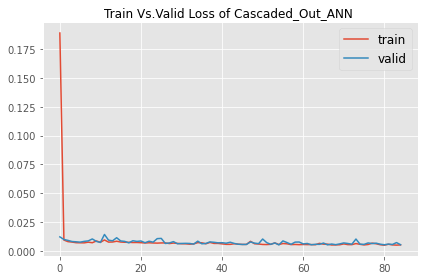

In [579]:
from keras import layers
#tf.keras.backend.clear_session()
np.random.seed(42)
tf.random.set_seed(42)
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.10, random_state=0,shuffle=True,
                                                    stratify=green_house['Rain'])





X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train,test_size=0.10, random_state=42)

X_train=preprocessing.fit_transform(X_train)
X_test=preprocessing.transform(X_test)
X_valid=preprocessing.transform(X_valid)

print('X_train',X_train.shape)
print('X_test',X_test.shape)
print('X_valid',X_valid.shape)
from sklearn.preprocessing import MinMaxScaler
min_max_scaler=MinMaxScaler()

y_train=min_max_scaler.fit_transform(y_train)
y_test=min_max_scaler.transform(y_test)
y_valid=min_max_scaler.transform(y_valid)
print('y_train',y_train.shape)
print('y_test',y_test.shape)
print('y_valid',y_valid.shape)


y_train_pred=[]
print(X_train.shape[1:][0])

input_wide = layers.Input(shape=X_train.shape[1:])  # features 0 to 4
#input_deep = tf.keras.layers.Input(shape=[6])  # features 2 to 7
norm_layer_wide = layers.Normalization()
norm_wide = norm_layer_wide(input_wide)
#norm_deep = norm_layer_deep(input_deep)

#hidden1 = tf.keras.layers.Dense(30, activation="relu")(norm_deep)
hidden2 = layers.Dense(500, activation='swish',kernel_initializer="he_normal")(norm_wide)
hidden3 = layers.Dense(150, activation='swish',kernel_initializer="he_normal")(hidden2)

hidden4 = layers.Dense(500, activation='swish',kernel_initializer="he_normal")(norm_wide)
hidden5 = layers.Dense(150, activation='swish',kernel_initializer="he_normal")(hidden4)

hidden6 = layers.Dense(500, activation='swish',kernel_initializer="he_normal")(norm_wide)
hidden7 = layers.Dense(150, activation='swish',kernel_initializer="he_normal")(hidden6)

output_0 = layers.Dense(1,activation='linear')(hidden3)
norm_out_0=layers.BatchNormalization()(output_0)
concat_0 = tf.keras.layers.concatenate([hidden5, norm_out_0])
output_1 = tf.keras.layers.Dense(1,activation='linear')(concat_0)
norm_out_1=layers.BatchNormalization()(output_1)

concat_1 = tf.keras.layers.concatenate([hidden7, norm_out_0,norm_out_1])
output_2 = tf.keras.layers.Dense(1,activation='linear')(concat_1)


best_models['Cascaded_Out_ANN'] = tf.keras.Model(inputs=[input_wide],
                       outputs=[output_0, output_1,output_2])

optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
checkpoint_path = "training_1/cas_cp.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(checkpoint_path,
                                                   save_best_model=True)


early_stopping_cb = tf.keras.callbacks.EarlyStopping(patience=30,
                                                     restore_best_weights=True)


best_models['Cascaded_Out_ANN'].compile(loss=("huber", "huber","huber"), loss_weights=(1,1, 1), optimizer=optimizer,
              metrics=["RootMeanSquaredError"])


norm_layer_wide.adapt(X_train)
history = best_models['Cascaded_Out_ANN'].fit(
    (X_train), (y_train[:,0], y_train[:,1],y_train[:,2]), epochs=300,
    validation_data=((X_valid), (y_valid[:,0], y_valid[:,1],y_valid[:,2])),
    batch_size=128,callbacks=[checkpoint_cb, early_stopping_cb]
)

plt.title('Train Vs.Valid Loss of Cascaded_Out_ANN ',fontsize=12)
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='valid')
save_fig('Train Vs.Valid Loss of Cascaded_Out_ANN ')
plt.legend()
plt.show()

In [580]:
y_train

array([[0.04255319, 0.04166667, 0.975     ],
       [0.17021277, 0.16666667, 0.54      ],
       [0.05319149, 0.05555556, 0.03      ],
       ...,
       [0.13829787, 0.13888889, 0.03      ],
       [1.        , 1.        , 0.54      ],
       [0.19148936, 0.19444444, 0.54      ]])

In [581]:
#os.listdir(checkpoint_dir)
##best_models['Cascaded_Out_ANN']=best_models['Cascaded_Out_ANN'].load_weights(checkpoint_path)
#best_models['Cascaded_Out_ANN']=keras.models.load_model(checkpoint_path)

In [582]:
train_RMSE = best_models['Cascaded_Out_ANN'].evaluate((X_train), (y_train[:,0],y_train[:,1],y_train[:,2]),return_dict=True, verbose=1)
val_RMSE = best_models['Cascaded_Out_ANN'].evaluate((X_valid), (y_valid[:,0],y_valid[:,1],y_valid[:,2]),return_dict=True, verbose=1)

test_RMSE = best_models['Cascaded_Out_ANN'].evaluate((X_test), (y_test[:,0],y_test[:,1],y_test[:,2]),return_dict=True, verbose=1)
print(f'Train: {train_RMSE},\n val: {val_RMSE},\n Test: {test_RMSE}')

  78/1211 [>.............................] - ETA: 12s - loss: 0.0048 - dense_13_loss: 0.0013 - dense_14_loss: 0.0013 - dense_15_loss: 0.0021 - dense_13_root_mean_squared_error: 0.0516 - dense_14_root_mean_squared_error: 0.0512 - dense_15_root_mean_squared_error: 0.0652

150/150 [==============================] - 1s 6ms/step - loss: 0.0047 - dense_13_loss: 0.0012 - dense_14_loss: 0.0012 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0499 - dense_14_root_mean_squared_error: 0.0497 - dense_15_root_mean_squared_error: 0.0669
Train: {'loss': 0.004350129049271345, 'dense_13_loss': 0.0012176154414191842, 'dense_14_loss': 0.001194047974422574, 'dense_15_loss': 0.0019384692423045635, 'dense_13_root_mean_squared_error': 0.04934806004166603, 'dense_14_root_mean_squared_error': 0.048868149518966675, 'dense_15_root_mean_squared_error': 0.0622650645673275},
 val: {'loss': 0.005206976551562548, 'dense_13_loss': 0.0014216842828318477, 'dense_14_loss': 0.001415134989656508, 'dense_15_loss': 0.0023701582103967667, 'dense_13_root_mean_squared_error': 0.05332324653863907, 'dense_14_root_mean_squared_error': 0.05320028215646744, 'dense_15_root_mean_squared_error': 0.06884999573230743},
 Test: {'loss': 0.004717688541859388, 'dense_13_loss': 0.001246120547875

In [583]:
test_RMSE

{'loss': 0.004717688541859388,
 'dense_13_loss': 0.001246120547875762,
 'dense_14_loss': 0.0012342078844085336,
 'dense_15_loss': 0.002237359993159771,
 'dense_13_root_mean_squared_error': 0.04992235079407692,
 'dense_14_root_mean_squared_error': 0.04968315362930298,
 'dense_15_root_mean_squared_error': 0.06689334660768509}

In [584]:
train_out1,train_out2,train_out3 = best_models['Cascaded_Out_ANN'].predict((X_train))
train_prediction=np.c_[train_out1,train_out2,train_out3]
train_prediction.shape

1211/1211 [==============================] - 8s 6ms/step


(38725, 3)

In [585]:
test_out1,test_out2,test_out3 = best_models['Cascaded_Out_ANN'].predict((X_test))
test_prediction=np.c_[test_out1,test_out2,test_out3]
test_prediction.shape

 72/150 [=============>................] - ETA: 0s

150/150 [==============================] - 1s 9ms/step


(4781, 3)

In [586]:

#train_out1,train_out2,train_out3 = best_models['Cascaded_Out_ANN'].predict((X_train))
##train_prediction=np.asarray(train_prediction)[:,:,0].reshape(len(y_train),3)
#train_prediction=pd.concat([train_out1,train_out2,train_out3],axis=1)
##train_prediction[0]=train_prediction[0].reshape(1,-1)
##train_prediction[1]=train_prediction[1].reshape(1,-1)
##train_prediction[2]=train_prediction[2].reshape(1,-1)
##train_prediction=np.asarray(train_prediction)[:,:,0]
#test_prediction = best_models['Cascaded_Out_ANN'].predict((X_test))
#test_prediction=np.asarray(test_prediction)[:,:,0].reshape(len(y_test),3)
#
##test_prediction[0]=test_prediction[0].reshape(1,-1)
##test_prediction[1]=test_prediction[1].reshape(1,-1)
##test_prediction[2]=test_prediction[2].reshape(1,-1)
##test_prediction=np.asarray(test_prediction)[:,:,0]
test_prediction




array([[0.09160331, 0.08788198, 0.03544204],
       [0.3107154 , 0.31613755, 0.026701  ],
       [0.28771615, 0.29217854, 0.02761839],
       ...,
       [0.07329362, 0.0688082 , 0.0361717 ],
       [0.0662066 , 0.06142548, 0.03644836],
       [0.8925029 , 0.92220294, 0.5143659 ]], dtype=float32)

In [587]:
y_test

array([[0.08510638, 0.08333333, 0.015     ],
       [0.30851064, 0.30555556, 0.015     ],
       [0.27659574, 0.27777778, 0.015     ],
       ...,
       [0.13829787, 0.13888889, 0.03      ],
       [0.08510638, 0.08333333, 0.03      ],
       [0.91489362, 0.91666667, 0.141     ]])

In [588]:
#test_prediction=np.array(test_prediction)[:,:,0]
#test_prediction.shape

In [589]:
#test_prediction[0,:]

In [590]:
#test_prediction=test_prediction.reshape(-1,3)
#test_prediction.shape

In [591]:
#train_prediction=np.array(train_prediction)[:,:,0].reshape(-1,3)

In [592]:
#test_prediction=np.c_[test_prediction[0],test_prediction[1],test_prediction[2]]
#train_prediction=np.c_[train_prediction[0],train_prediction[1],train_prediction[2]]

In [593]:
y_test

array([[0.08510638, 0.08333333, 0.015     ],
       [0.30851064, 0.30555556, 0.015     ],
       [0.27659574, 0.27777778, 0.015     ],
       ...,
       [0.13829787, 0.13888889, 0.03      ],
       [0.08510638, 0.08333333, 0.03      ],
       [0.91489362, 0.91666667, 0.141     ]])

In [594]:
train_prediction.shape

(38725, 3)

In [595]:
train_prediction=min_max_scaler.inverse_transform(train_prediction)
test_prediction=min_max_scaler.inverse_transform(test_prediction)

In [596]:
y_train_inv=min_max_scaler.inverse_transform(y_train)
y_test_inv=min_max_scaler.inverse_transform(y_test)

In [597]:
test_prediction

array([[8.6107111e-01, 6.3275027e+00, 7.0884087e+01],
       [2.9207249e+00, 2.2761904e+01, 5.3402000e+01],
       [2.7045319e+00, 2.1036856e+01, 5.5236782e+01],
       ...,
       [6.8896002e-01, 4.9541903e+00, 7.2343407e+01],
       [6.2234199e-01, 4.4226341e+00, 7.2896721e+01],
       [8.3895273e+00, 6.6398613e+01, 1.0287318e+03]], dtype=float32)

In [598]:
y_test_inv

array([[  0.8,   6. ,  30. ],
       [  2.9,  22. ,  30. ],
       [  2.6,  20. ,  30. ],
       ...,
       [  1.3,  10. ,  60. ],
       [  0.8,   6. ,  60. ],
       [  8.6,  66. , 282. ]])

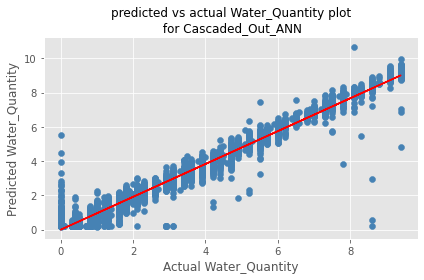

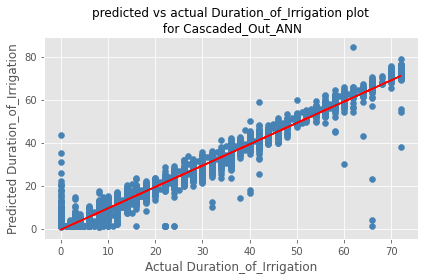

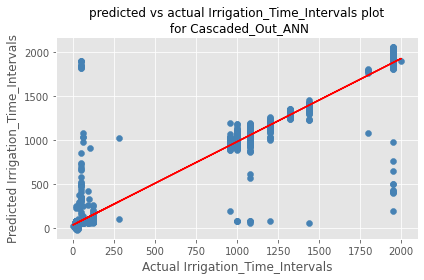

[('Chain_RF', 0.2837217778845503, 0.22476144509248785, 0.9031379462237442), ('Parallel_Out_ANN', 0.23654456777580146, 0.1562292789781142, 0.9326722213608444), ('Cascaded_Out_ANN', 0.16806852420425966, 0.07886952834514556, 0.9660107876031326)] 
 [('Chain_RF', 0.2594162060527123, 1.4442757156777606, 0.9191247533995012), ('Parallel_Out_ANN', 0.23521556105225405, 1.1873752757598544, 0.9335104321204005), ('Cascaded_Out_ANN', 0.16668088562329786, 0.5962487761480354, 0.9666117997534918)] 
 [('Chain_RF', 0.22860579416258378, 40.5375670896336, 0.9211608039263998), ('Parallel_Out_ANN', 0.18451549080321733, 26.408812832688795, 0.9486390101215574), ('Cascaded_Out_ANN', 0.1724763959395173, 23.07504466241352, 0.9551226651928917)] 



In [599]:
#best_models['Cascaded_Out_ANN']=keras.models.load_model("my_checkpoints_best")
#train_prediction = best_models['Cascaded_Out_ANN'].predict((X_train))
#test_prediction = best_models['Cascaded_Out_ANN'].predict((X_test))
#train_prediction = np.array(train_prediction).reshape(-1,3)
#test_prediction=np.array(test_prediction).reshape(-1,3)
for i,out in zip(range(0,len(y.columns),1),y.columns):
    #train scores:
    train_rmse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train_inv[:,i],squared=False)/y[out].mean()
    train_mse[out]=mean_squared_error(y_pred=train_prediction[:,i],y_true=y_train_inv[:,i])/y[out].mean()
    train_r2[out]=r2_score(y_true=y_train_inv[:,i],y_pred=train_prediction[:,i])
    #train result for each output
    train_results[out].append(('Cascaded_Out_ANN',train_rmse[out],train_mse[out],train_r2[out]))
   
    #test scores:
    test_rmse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test_inv[:,i],squared=False)/y[out].mean()
    test_mse[out]=mean_squared_error(y_pred=test_prediction[:,i],y_true=y_test_inv[:,i])/y[out].mean()
    test_r2[out]=r2_score(y_true=y_test_inv[:,i],y_pred=test_prediction[:,i])
    #test result for each output
    test_results[out].append(('Cascaded_Out_ANN',test_rmse[out],test_mse[out],test_r2[out]))
    
    # Plot predicted vs actual
    plt.style.use("ggplot")
    plt.scatter(y_test_inv[:,i], test_prediction[:,i],color='steelblue')
    plt.xlabel(f'Actual {out}')
    plt.ylabel(f'Predicted {out}')
    plt.title(f'predicted vs actual {out} plot\n for Cascaded_Out_ANN',fontsize=12)
    # overlay the regression line
    z = np.polyfit(y_test_inv[:,i], test_prediction[:,i], 1)
    p = np.poly1d(z)
    plt.plot(y_test_inv[:,i],p(y_test_inv[:,i]),color='red')
    #plt.grid()
    save_fig(f'predicted vs actual {out} plot for Cascaded_Out_ANN')
    plt.show()

    from scipy import stats
    #confidence_interval:
    confidence = 0.95
    squared_errors = (test_prediction[:,i] - y_test_inv[:,i]) ** 2
    zscore = stats.norm.ppf((1 + confidence) / 2)
    zmargin = zscore * squared_errors.std(ddof=1) / np.sqrt(len(squared_errors))
    c1[out],c2[out] = np.sqrt(squared_errors.mean() - zmargin)/y[out].mean(), np.sqrt(squared_errors.mean() 
                    + zmargin)/y[out].mean()
    #confidence_intervals for each output:
    conf_interv_results[out].append(('Cascaded_Out_ANN',test_rmse[out],c1[out],c2[out],c2[out]-c1[out]))
        

#print(train_results[outputs[0]],'\n',train_results[outputs[1]],'\n',train_results[outputs[2]],'\n')
print(test_results[outputs[0]],'\n',test_results[outputs[1]],'\n',test_results[outputs[2]],'\n')
#print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n')


In [600]:
#np.array(test_prediction)[0,:].reshape(1,-1)[0,:]

In [601]:
y_test[:,0]

array([0.08510638, 0.30851064, 0.27659574, ..., 0.13829787, 0.08510638,
       0.91489362])

In [602]:
eval_results = best_models['Cascaded_Out_ANN'].evaluate((X_test), (y_test[:,0], y_test[:,1], y_test[:,2]))
#weighted_sum_of_losses, main_loss, aux_loss, main_rmse, aux_rmse = eval_results
eval_results

 17/150 [==>...........................] - ETA: 0s - loss: 0.0062 - dense_13_loss: 0.0014 - dense_14_loss: 0.0014 - dense_15_loss: 0.0034 - dense_13_root_mean_squared_error: 0.0529 - dense_14_root_mean_squared_error: 0.0530 - dense_15_root_mean_squared_error: 0.0820

150/150 [==============================] - 1s 9ms/step - loss: 0.0047 - dense_13_loss: 0.0012 - dense_14_loss: 0.0012 - dense_15_loss: 0.0022 - dense_13_root_mean_squared_error: 0.0499 - dense_14_root_mean_squared_error: 0.0497 - dense_15_root_mean_squared_error: 0.0669


[0.004717688541859388,
 0.001246120547875762,
 0.0012342078844085336,
 0.002237359993159771,
 0.04992235079407692,
 0.04968315362930298,
 0.06689334660768509]

In [603]:
y_pred_0, y_pred_1,y_pred_2 = best_models['Cascaded_Out_ANN'].predict((X_train))

  56/1211 [>.............................] - ETA: 7s

1211/1211 [==============================] - 7s 6ms/step


In [604]:
model_rms_train=mean_squared_error(y_pred=y_pred_0,y_true=y_train[:,0],squared=False)#/y_train[outputs[0]].mean()
model_rms_train

0.04934805621558061

In [605]:
model_rms_train=mean_squared_error(y_pred=y_pred_1,y_true=y_train[:,1],squared=False)#/y_train[outputs[1]].mean()
model_rms_train

0.04886814298798845

In [606]:
model_rms_train=mean_squared_error(y_pred=y_pred_2,y_true=y_train[:,2],squared=False)#/y_train[outputs[1]].mean()
model_rms_train

0.062265053902443634

In [607]:
#model=model.load_weights("my_checkpoints")
#model.evaluate(X_test, y_test)

In [608]:
y_pred_0, y_pred_1,y_pred_2 = best_models['Cascaded_Out_ANN'].predict((X_test))

106/150 [====================>.........] - ETA: 0s

150/150 [==============================] - 2s 10ms/step


In [609]:
model_rms_test=mean_squared_error(y_pred=y_pred_0,y_true=y_test[:,0],squared=False)#/y_train[outputs[0]].mean()
model_rms_test

0.049922347744466064

In [610]:
model_rms_test=mean_squared_error(y_pred=y_pred_1,y_true=y_test[:,1],squared=False)#/y_train[outputs[1]].mean()
model_rms_test

0.04968315938097085

In [611]:
model_rms_test=mean_squared_error(y_pred=y_pred_2,y_true=y_test[:,2],squared=False)#/y_train[outputs[1]].mean()
model_rms_test

0.06689334068032357

In [612]:
#show training results table:
best_trained_model_idx=dict()
for out in outputs:
    print('best models train {out} scores:',train_results[outputs[out]])
    best_trained_model_idx[outputs[out]]=np.array(train_results[outputs[out]])[:,1].argmin()


    #print('best models test scores:',test_results)
    #best_tested_model_idx=np.array(test_results)[:,1].argmax()

print('best trained model:',train_results[outputs[out]][best_trained_model_idx[outputs[out]]][0],
                            train_results[outputs[out]][best_trained_model_idx[outputs[out]]][1],'\n')
train_result=dict()
#print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
train_result[outputs[0]]=pd.DataFrame(train_results[outputs[0]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

train_result[outputs[1]]=pd.DataFrame(train_results[outputs[1]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

train_result[outputs[2]]=pd.DataFrame(train_results[outputs[2]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#import dataframe_image as dfi
#
#dfi.export(train_result[outputs[0]], f'ModelsTrainingResults{outputs[0]}Table.png')
#dfi.export(train_result[outputs[1]], f"ModelsTrainingResults{outputs[1]}Table.png")
#dfi.export(train_result[outputs[2]], f"ModelsTrainingResults{outputs[2]}Table.png")

train_result[outputs[0]]


best models train Water_Quantity scores: [('Chain_RF', 0.27359983628981993, 0.20901051573088664, 0.9089697990008077), ('Parallel_Out_ANN', 0.25958121542119134, 0.18814080315085172, 0.9178446143232565), ('Cascaded_Out_ANN', 0.16613511386969243, 0.07706538234672801, 0.966347883590437)]
best models train Duration_of_Irrigation scores: [('Chain_RF', 0.245366043199506, 1.2920663645487973, 0.926904745610215), ('Parallel_Out_ANN', 0.2583070077282812, 1.4319514019485597, 0.9187791246116915), ('Cascaded_Out_ANN', 0.16394660589879423, 0.5768471645509388, 0.9672809903979032)]
best models train Water_interv scores: [('Chain_RF', 0.2021369288095919, 31.69381648417906, 0.9373610453734216), ('Parallel_Out_ANN', 0.173376120137314, 23.31641480859448, 0.9539774673572599), ('Cascaded_Out_ANN', 0.1605429171030293, 19.992426726784235, 0.9605384395845511)]
best trained model: Cascaded_Out_ANN 0.16613511386969243 
 Cascaded_Out_ANN 0.16394660589879423 
 Cascaded_Out_ANN 0.1605429171030293 



,Model,RMSE,MSE,R2_Score
2,Cascaded_Out_ANN,0.166135,0.077065,0.966348
1,Parallel_Out_ANN,0.259581,0.188141,0.917845
0,Chain_RF,0.273600,0.209011,0.908970


In [613]:
train_result[outputs[1]]


,Model,RMSE,MSE,R2_Score
2,Cascaded_Out_ANN,0.163947,0.576847,0.967281
0,Chain_RF,0.245366,1.292066,0.926905
1,Parallel_Out_ANN,0.258307,1.431951,0.918779


In [614]:
train_result[outputs[2]]


,Model,RMSE,MSE,R2_Score
2,Cascaded_Out_ANN,0.160543,19.992427,0.960538
1,Parallel_Out_ANN,0.173376,23.316415,0.953977
0,Chain_RF,0.202137,31.693816,0.937361


In [615]:
#show testing results table:
best_tested_model_idx=dict()
print('best models test Water_Quantity scores:',test_results[outputs[0]])
best_tested_model_idx[outputs[0]]=np.array(test_results[outputs[0]])[:,1].argmin()

print('best models test Duration_of_Irrigation scores:',test_results[outputs[1]])
best_tested_model_idx[outputs[1]]=np.array(test_results[outputs[1]])[:,1].argmin()

print('best models test Water_interv scores:',test_results[outputs[2]])
best_tested_model_idx[outputs[2]]=np.array(test_results[outputs[2]])[:,1].argmin()

#print('best models test scores:',test_results)
#best_tested_model_idx=np.array(test_results)[:,1].argmax()


print('best tested model:',test_results[outputs[0]][best_tested_model_idx[outputs[0]]][0],test_results[outputs[0]][best_tested_model_idx[outputs[0]]][1],'\n',
                            test_results[outputs[1]][best_tested_model_idx[outputs[1]]][0],test_results[outputs[1]][best_tested_model_idx[outputs[1]]][1],'\n',
                            test_results[outputs[2]][best_tested_model_idx[outputs[2]]][0],test_results[outputs[2]][best_tested_model_idx[outputs[2]]][1],'\n',
)
test_result=dict()
#print('best tested model:',test_results[best_tested_model_idx][0],test_results[best_tested_model_idx][1])
test_result[outputs[0]]=pd.DataFrame(test_results[outputs[0]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

test_result[outputs[1]]=pd.DataFrame(test_results[outputs[1]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')

test_result[outputs[2]]=pd.DataFrame(test_results[outputs[2]],
           columns=['Model','RMSE','MSE','R2_Score']).sort_values(by='RMSE')
#import dataframe_image as dfi

#dfi.export(test_result, "ModelstestingResultsTable.png")
test_result[outputs[0]]


best models test Water_Quantity scores: [('Chain_RF', 0.2837217778845503, 0.22476144509248785, 0.9031379462237442), ('Parallel_Out_ANN', 0.23654456777580146, 0.1562292789781142, 0.9326722213608444), ('Cascaded_Out_ANN', 0.16806852420425966, 0.07886952834514556, 0.9660107876031326)]
best models test Duration_of_Irrigation scores: [('Chain_RF', 0.2594162060527123, 1.4442757156777606, 0.9191247533995012), ('Parallel_Out_ANN', 0.23521556105225405, 1.1873752757598544, 0.9335104321204005), ('Cascaded_Out_ANN', 0.16668088562329786, 0.5962487761480354, 0.9666117997534918)]
best models test Water_interv scores: [('Chain_RF', 0.22860579416258378, 40.5375670896336, 0.9211608039263998), ('Parallel_Out_ANN', 0.18451549080321733, 26.408812832688795, 0.9486390101215574), ('Cascaded_Out_ANN', 0.1724763959395173, 23.07504466241352, 0.9551226651928917)]
best tested model: Cascaded_Out_ANN 0.16806852420425966 
 Cascaded_Out_ANN 0.16668088562329786 
 Cascaded_Out_ANN 0.1724763959395173 



,Model,RMSE,MSE,R2_Score
2,Cascaded_Out_ANN,0.168069,0.078870,0.966011
1,Parallel_Out_ANN,0.236545,0.156229,0.932672
0,Chain_RF,0.283722,0.224761,0.903138


In [616]:
test_result[outputs[1]]


,Model,RMSE,MSE,R2_Score
2,Cascaded_Out_ANN,0.166681,0.596249,0.966612
1,Parallel_Out_ANN,0.235216,1.187375,0.933510
0,Chain_RF,0.259416,1.444276,0.919125


In [617]:
test_result[outputs[2]]


,Model,RMSE,MSE,R2_Score
2,Cascaded_Out_ANN,0.172476,23.075045,0.955123
1,Parallel_Out_ANN,0.184515,26.408813,0.948639
0,Chain_RF,0.228606,40.537567,0.921161


In [618]:
print(conf_interv_results[outputs[0]],'\n',conf_interv_results[outputs[1]],'\n',conf_interv_results[outputs[2]],'\n')

conf_interv_result=dict()
conf_interv_result[outputs[0]]=pd.DataFrame(conf_interv_results[outputs[0]],
           columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

conf_interv_result[outputs[1]]=pd.DataFrame(conf_interv_results[outputs[1]],
           columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

conf_interv_result[outputs[2]]=pd.DataFrame(conf_interv_results[outputs[2]],
           columns=['Model','RMSE','C1','C2','Confidence Interval']).sort_values(by='RMSE',ignore_index=True)

conf_interv_result[outputs[0]]

[('Chain_RF', 0.2837217778845503, 0.2685925619115747, 0.2980840991695416, 0.029491537257966882), ('Parallel_Out_ANN', 0.23654456777580146, 0.22006377543385092, 0.2519495977974188, 0.031885822363567906), ('Cascaded_Out_ANN', 0.16806852420425966, 0.14831297611832464, 0.18573453844484847, 0.03742156232652383)] 
 [('Chain_RF', 0.2594162060527123, 0.2424964130282566, 0.27529806681848634, 0.03280165379022973), ('Parallel_Out_ANN', 0.23521556105225405, 0.21814819114854928, 0.2511256399113187, 0.032977448762769423), ('Cascaded_Out_ANN', 0.16668088562329786, 0.14651883950919783, 0.18465444736916503, 0.0381356078599672)] 
 [('Chain_RF', 0.22860579416258378, 0.21046983235292532, 0.24540510980569, 0.034935277452764674), ('Parallel_Out_ANN', 0.18451549080321733, 0.15696344242255975, 0.20845721488009028, 0.051493772457530534), ('Cascaded_Out_ANN', 0.1724763959395173, 0.14435201553305121, 0.19661818309636578, 0.052266167563314564)] 



,Model,RMSE,C1,C2,Confidence Interval
0,Cascaded_Out_ANN,0.168069,0.148313,0.185735,0.037422
1,Parallel_Out_ANN,0.236545,0.220064,0.251950,0.031886
2,Chain_RF,0.283722,0.268593,0.298084,0.029492


In [619]:
conf_interv_result[outputs[1]]

,Model,RMSE,C1,C2,Confidence Interval
0,Cascaded_Out_ANN,0.166681,0.146519,0.184654,0.038136
1,Parallel_Out_ANN,0.235216,0.218148,0.251126,0.032977
2,Chain_RF,0.259416,0.242496,0.275298,0.032802


In [620]:
conf_interv_result[outputs[2]]

,Model,RMSE,C1,C2,Confidence Interval
0,Cascaded_Out_ANN,0.172476,0.144352,0.196618,0.052266
1,Parallel_Out_ANN,0.184515,0.156963,0.208457,0.051494
2,Chain_RF,0.228606,0.210470,0.245405,0.034935


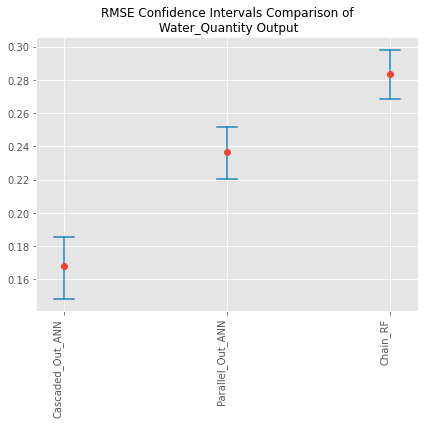

In [621]:
#conf_interv_result[outputs[0]].drop('KNeighborsRegressor')
plt.figure(figsize=(6,6))
plt.xticks(range(len(conf_interv_result[outputs[0]])),list(conf_interv_result[outputs[0]]['Model']),
            rotation = 90, ha="right")
plt.title('RMSE Confidence Intervals Comparison of\n Water_Quantity Output',fontsize=12)
for C1,C2,b in zip(conf_interv_result[outputs[0]]['C1'],conf_interv_result[outputs[0]]['C2'],
                    range(len(conf_interv_result[outputs[0]]))):
    color='#2187bb'
    horizontal_line_width=0.25
    left = b - horizontal_line_width / 4
    right = b + horizontal_line_width / 4
    #plt.plot((b,b),(C1,C2),'ro-',color='orange')
    plt.plot([b, b], [C2, C1], color=color)
    plt.plot([left, right], [C2, C2], color=color)
    plt.plot([left, right], [C1, C1], color=color)
    plt.plot(b, conf_interv_result[outputs[0]]['RMSE'][b], 'o', color='#f44336')

save_fig(f'RMSE Confidence Intervals of Water_Quantity Output')
#plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
plt.show()

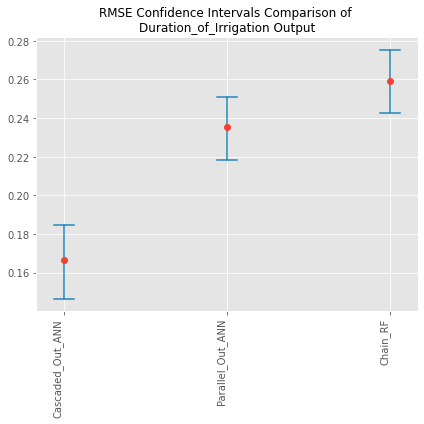

In [622]:
#conf_interv_result[outputs[1]].drop('KNeighborsRegressor')

plt.figure(figsize=(6,6))
plt.xticks(range(len(conf_interv_result[outputs[1]])),list(conf_interv_result[outputs[1]]['Model']),
            rotation = 90, ha="right")
plt.title('RMSE Confidence Intervals Comparison of \nDuration_of_Irrigation Output',fontsize=12)
for C1,C2,b in zip(conf_interv_result[outputs[1]]['C1'],conf_interv_result[outputs[1]]['C2'],
                    range(len(conf_interv_result[outputs[1]]))):
    color='#2187bb'
    horizontal_line_width=0.25
    left = b - horizontal_line_width / 4
    right = b + horizontal_line_width / 4
    #plt.plot((b,b),(C1,C2),'ro-',color='orange')
    plt.plot([b, b], [C2, C1], color=color)
    plt.plot([left, right], [C2, C2], color=color)
    plt.plot([left, right], [C1, C1], color=color)
    plt.plot(b, conf_interv_result[outputs[1]]['RMSE'][b], 'o', color='#f44336')

save_fig(f'RMSE Confidence Intervals of Duration_of_Irrigation Output')
#plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
plt.show()

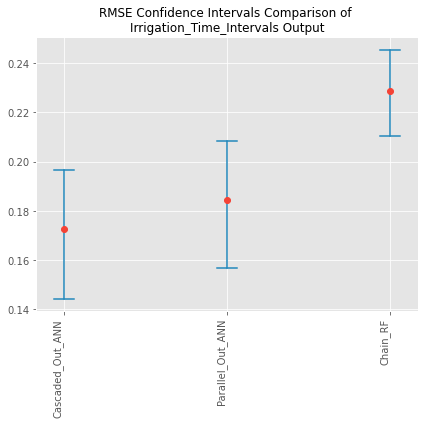

In [623]:
#conf_interv_result[outputs[2]].drop('KNeighborsRegressor')
plt.figure(figsize=(6,6))
plt.xticks(range(len(conf_interv_result[outputs[2]])),list(conf_interv_result[outputs[2]]['Model']),
            rotation = 90, ha="right")
plt.title('RMSE Confidence Intervals Comparison of \nIrrigation_Time_Intervals Output',fontsize=12)
for C1,C2,b in zip(conf_interv_result[outputs[2]]['C1'],conf_interv_result[outputs[2]]['C2'],
                    range(len(conf_interv_result[outputs[2]]))):
    color='#2187bb'
    horizontal_line_width=0.25
    left = b - horizontal_line_width / 4
    right = b + horizontal_line_width / 4
    #plt.plot((b,b),(C1,C2),'ro-',color='orange')
    plt.plot([b, b], [C2, C1], color=color)
    plt.plot([left, right], [C2, C2], color=color)
    plt.plot([left, right], [C1, C1], color=color)
    plt.plot(b, conf_interv_result[outputs[2]]['RMSE'][b], 'o', color='#f44336')

save_fig(f'RMSE Confidence Intervals of Irrigation_Time_Intervals Output')

#plt.xticks(range(len(confidence_interval_results)),list(confidence_interval_results['Model']))
plt.show()

In [624]:
test_prediction

array([[8.6107111e-01, 6.3275027e+00, 7.0884087e+01],
       [2.9207249e+00, 2.2761904e+01, 5.3402000e+01],
       [2.7045319e+00, 2.1036856e+01, 5.5236782e+01],
       ...,
       [6.8896002e-01, 4.9541903e+00, 7.2343407e+01],
       [6.2234199e-01, 4.4226341e+00, 7.2896721e+01],
       [8.3895273e+00, 6.6398613e+01, 1.0287318e+03]], dtype=float32)

In [625]:

predictions=np.array(test_prediction)[2,:].reshape(1,-1)[0,:]
predictions.shape

(3,)

In [626]:
y_test[:,2]

array([0.015, 0.015, 0.015, ..., 0.03 , 0.03 , 0.141])

In [627]:
outputs
#range(len(outputs)-1)

Index(['Water_Quantity', 'Duration_of_Irrigation',
       'Irrigation_Time_Intervals'],
      dtype='object')

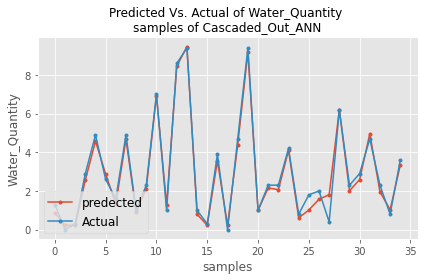

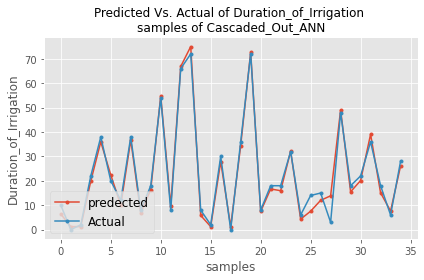

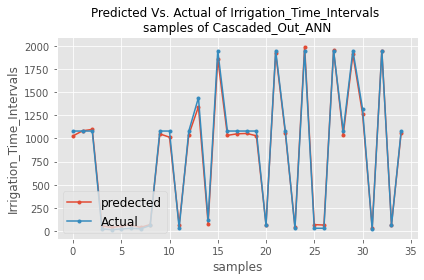

In [628]:
for pred_out,i in zip(outputs,range(len(outputs))):
    plt.style.use("ggplot")
    plt.figure()
    plt.plot(test_prediction[:,i][15:50],label='predected', marker=".")
    plt.plot(y_test_inv[:,i][15:50],label='Actual',marker=".")

    plt.title(f"Predicted Vs. Actual of {pred_out} \nsamples of Cascaded_Out_ANN",fontsize=12)
    plt.xlabel("samples")
    plt.ylabel(f"{pred_out}")
    plt.legend(loc="lower left")
    save_fig(f"Predicted Vs. Actual of {pred_out} in discrete time series of Cascaded_Out_ANN")

    plt.show()

In [629]:
from keras.utils.vis_utils import plot_model,model_to_dot
from graphviz import Source
import pydot

#model_to_dot(best_models['Cascaded_Out_ANN'])
plot_model(best_models['Cascaded_Out_ANN'], to_file='Cascaded_Out_ANN_Archeticture.png', show_shapes=True, show_layer_names=True)
#
#
#Source.from_file("Cascaded_Out_ANN_Archeticture.dot")

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [630]:
#keras.models.save_model(models['Cascaded_Out_ANN'],'Cascaded_Out_ANN.hdf')

In [631]:
#tf.keras.utils.plot_model(
#models['Cascaded_Out_ANN'],
#to_file=r"C:\Users\user\Desktop\iman\Master\RoboticsAndControlSystems\Project\Code\IrrigationControlSystem\model.png",
#show_shapes=True,
#show_dtype=False,
#show_layer_names=True,
#rankdir="TB",
#expand_nested=True,
#dpi=96,
#layer_range=None,
#show_layer_activations=True,
#)

In [632]:
#tf.keras.utils.plot_model(
#models['Parallel_ANN'],
#to_file=r"C:\Users\user\Desktop\iman\Master\RoboticsAndControlSystems\Project\Code\IrrigationControlSystem\model.png",
#show_shapes=True,
#show_dtype=False,
#show_layer_names=True,
#rankdir="TB",
#expand_nested=True,
#dpi=96,
#layer_range=None,
#show_layer_activations=True,
#)

In [633]:
 
#tf.keras.utils.model_to_dot(
#    models['Cascaded_Out_ANN'],
#    show_shapes=False,
#    show_dtype=False,
#    show_layer_names=True,
#    rankdir="TB",
#    expand_nested=False,
#    dpi=96,
#    subgraph=False,
#    layer_range=None,
#    show_layer_activations=False,
#)